In [1]:
import os

def run_fast_scandir(dir, ext):    
    subfolders, datafiles = [], []

    for f in os.scandir(dir):
        if f.is_dir():
            subfolders.append(f.path)
        if f.is_file():
            if os.path.splitext(f.name)[1].lower() in ext:
                datafiles.append(f.path)

    for dir in list(subfolders):
        sf, f = run_fast_scandir(dir, ext)
        subfolders.extend(sf)
        datafiles.extend(f)
    return subfolders, datafiles

In [2]:
def pick_channels(ch_labels, desired_channels):
    ch_idx = []    
    for dc in desired_channels:
        for i, c in enumerate(ch_labels):
            if dc in c:
                ch_idx.append(i)
    return ch_idx


# **Pre-processing pipeline toggling variables**



In [3]:
CAR_REF = True
RUN_ICA = False
APPLY_ICA = False
X_DAWN = False
BASELN_CORR = True

# **Importing signals**

## Signal info

------
Data paths: 

C:/Users/VascoRocha(1161216)/Desktop/Rocha/EEG Data/

C:/Users/migue/OneDrive/Ambiente de Trabalho/Tese/EEG Data/

In [4]:
import mne
import numpy as np

folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Data/EEG Data"
old_data_subfold, EEG_data = run_fast_scandir(folder, [".edf"])

EEGs = []

print("============= Importing files =============\n")

count = 0

for EEG_file in EEG_data:
    if ("Test" in EEG_file and EEG_data not in old_data_subfold):
        
        count += 1
        print(f"\nSubject {count}\n")

        raw_eeg = mne.io.read_raw_edf(EEG_file, 
                                    preload=True)
        
        EEGs.append(raw_eeg)

NUM_SUBJ = len(EEGs)

print("\n\n============= Common EEG info =============")

print("\n", raw_eeg.info.keys())
print("\n", raw_eeg.info)

ch = raw_eeg.info["ch_names"] # Channel labels
fs = raw_eeg.info["sfreq"]

print("\nChannel labels: ", ch)

============= Importing files =============


Subject 1

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\01_session_01_Test.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 637439  =      0.000 ...   311.250 secs...

Subject 2

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\02_session_01_Test.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 762623  =      0.000 ...   372.375 secs...

Subject 3

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\03_session_01_Test.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 867071  =      0.000 ...   423.375 secs...

Subject 4

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\04_session_01_Test.edf...
EDF file detected
Setting chann

# **Analysing signal quality and pre-processing data accordingly**

## Checking if the recorded signal is an EEG (1/f shape)

### Designing the band pass filter

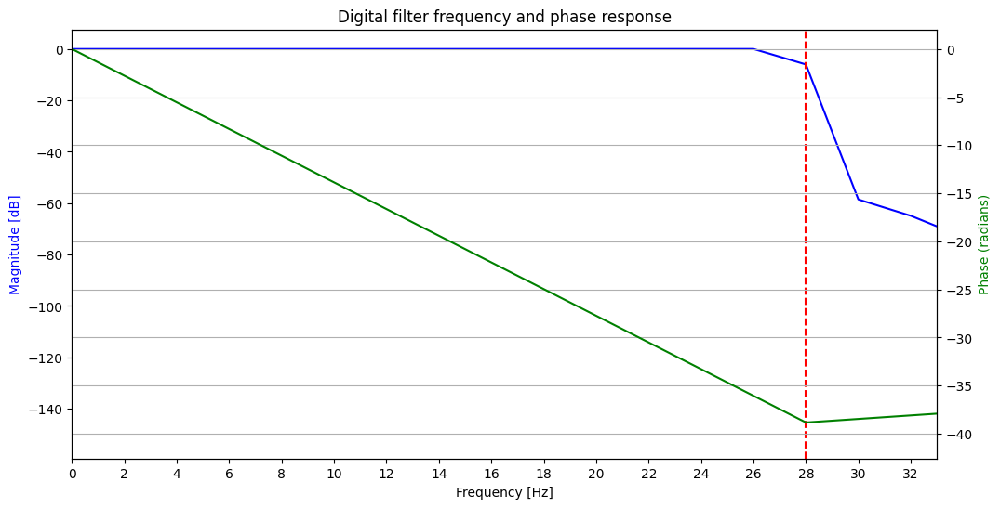

Subject 1: Low-Pass filtering EEG (28 Hz)
Subject 2: Low-Pass filtering EEG (28 Hz)
Subject 3: Low-Pass filtering EEG (28 Hz)
Subject 4: Low-Pass filtering EEG (28 Hz)
Subject 5: Low-Pass filtering EEG (28 Hz)
Subject 6: Low-Pass filtering EEG (28 Hz)


In [5]:
import scipy
from scipy.signal import filtfilt, firwin, freqz

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

# Designing a low-pass FIR filter at 28 Hz
nyquist = fs/2
lowcut = 28
numtaps = 5001 # Order
filt = firwin(numtaps, 
              lowcut/nyquist, 
              pass_zero=True)  
'''
pass_zero -> If True, the gain at frequency 0 (DC) is 1, creating a low-pass filter.
              If False, the DC gain is 0, creating a high-pass filter.
'''

# Ploting the frequency response of the filter
w, h = freqz(filt) # The frequency response is returned as a tuple (w, h), where w is the array of frequencies and h is the array of complex coeficients (w: rad/samples)

fig, ax1 = plt.subplots(figsize = (12,6))

ax1.set_title('Digital filter frequency and phase response')
ax1.plot(w*fs/(2*np.pi), 20 * np.log10(abs(h)), 'b')
ax1.set_ylabel('Magnitude [dB]', color='b')
ax1.set_xlabel('Frequency [Hz]')
ax1.set_xticks(np.arange(0,lowcut * 4/3.7, 5))
ax1.axvline(x = lowcut, color = 'r', linestyle = '--')

ax2 = ax1.twinx()
ax2.plot(w*fs/(2*np.pi), np.unwrap(np.angle(h)), 'g')
ax2.set_ylabel('Phase (radians)', color='g')
ax2.grid(True)
ax2.axis('tight')
ax2.set_xlim(0, 33)
ax2.set_xticks(np.arange(0, 32.5, 2))

plt.show()

# Applying the filter to the signal using filtfilt
# EEG shape: (channels, samples)
eeg_ch_idx = mne.pick_channels(ch, 
                               include = [], 
                               exclude = ['dc01+', 'dc02+', 'MKR+'])

filt_EEGs = []

for subj in range(NUM_SUBJ):

    print(f"Subject {subj +1}: Low-Pass filtering EEG ({lowcut} Hz)")

    filt_eeg = filtfilt(filt, 
                        1, 
                        EEGs[subj].get_data(picks = eeg_ch_idx), 
                        axis = 1)

    filt_EEGs.append(filt_eeg)


### Apllying the FFT on the EEG signal

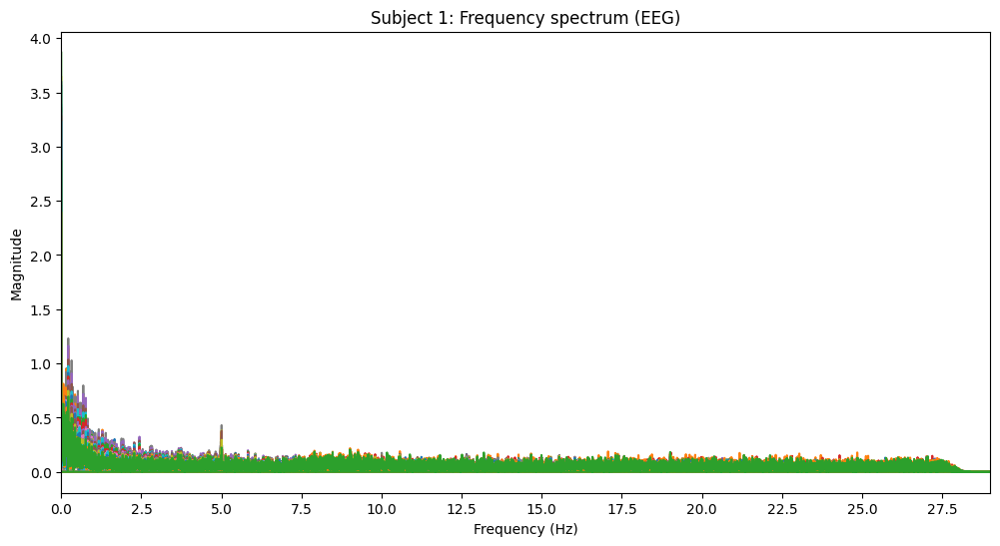

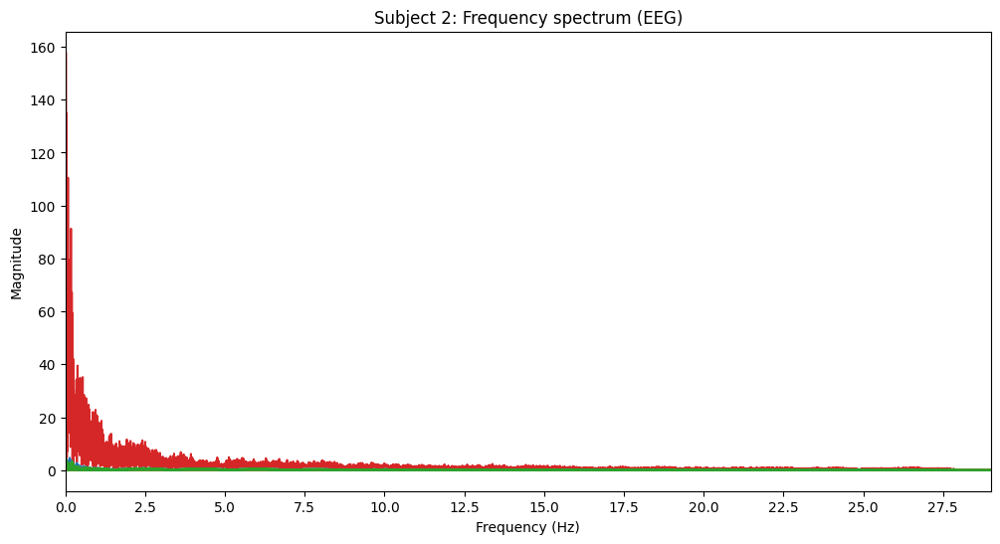

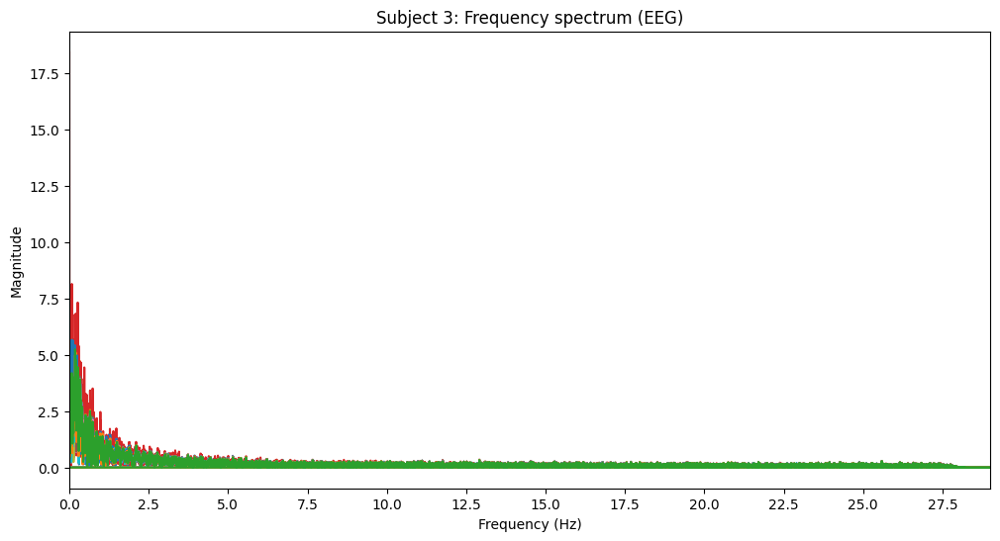

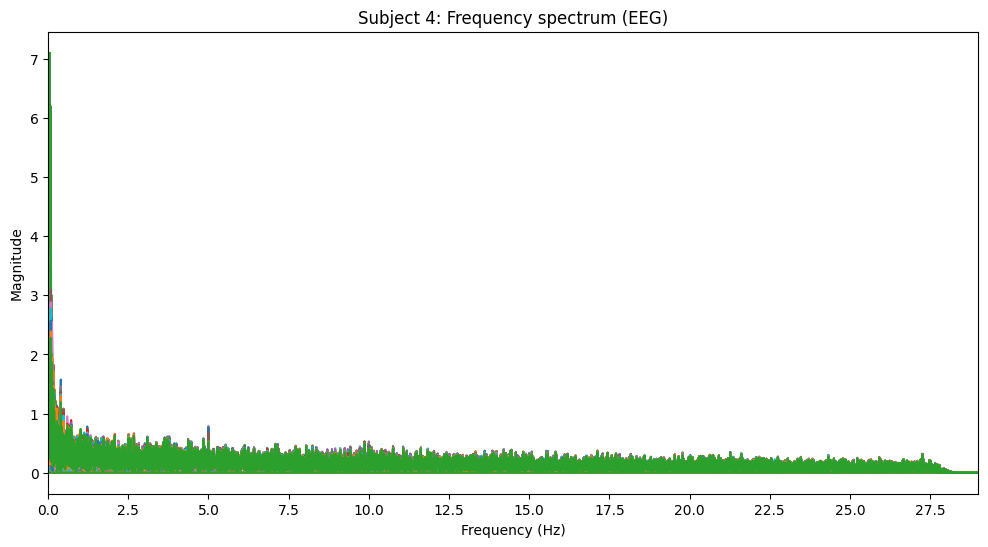

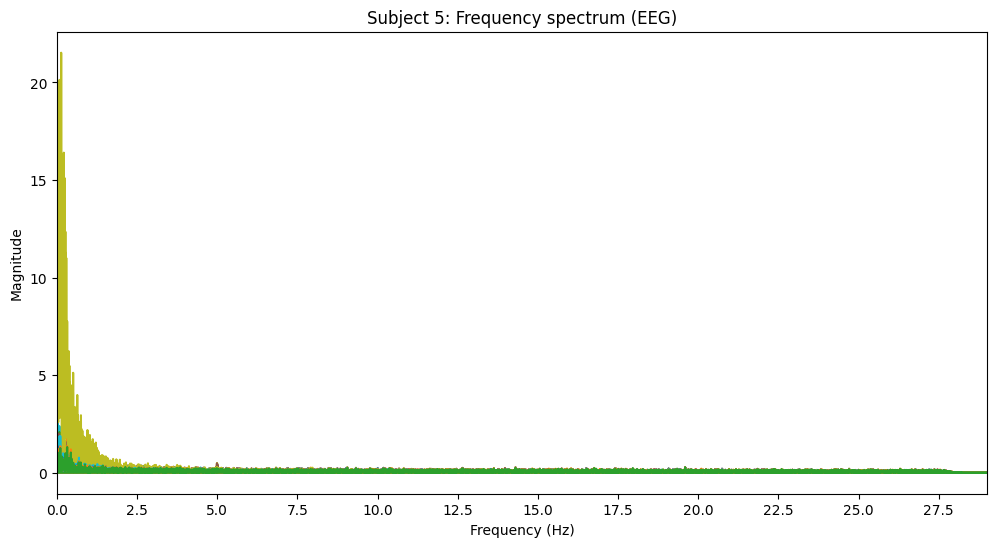

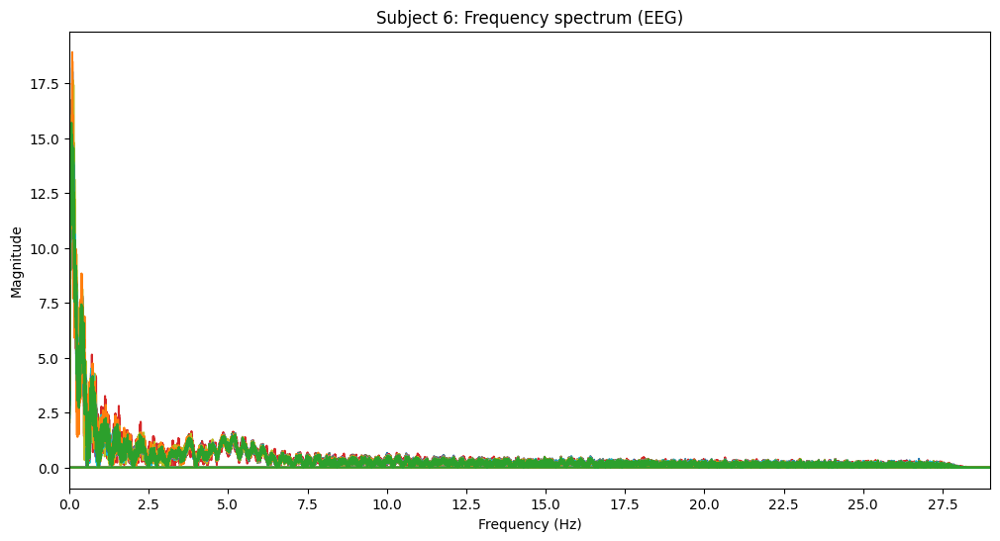

In [6]:
for subj in range(NUM_SUBJ):

    X = np.fft.fft(filt_EEGs[subj], axis = 1)

    # Compute the frequency vector
    freqs = np.fft.fftfreq(np.size(X,1), 1/fs)

    # Plot the frequency spectrum
    figure(figsize = (12,6))
    plt.plot(freqs, np.abs(X.T))
    plt.title(f"Subject {subj+1}: Frequency spectrum (EEG)")
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.xlim(0, lowcut + 1)
    plt.xticks(np.arange(0, lowcut + 1, 2.5)) 
    plt.show()

## Bad channel interpolation (O1)

In [7]:
cust_ch = [ch[c].split("EEG ")[1] for c in eeg_ch_idx if ("EEG " in ch[c])]
clean_ch = [c.split("''")[0] for c in cust_ch]

ch_types = ['eeg'] * len(clean_ch)

new_info = mne.create_info(ch_names = clean_ch, 
                           sfreq = fs, 
                           ch_types = ch_types)

sjbs_with_bad_ch = [1, 2, 5]

interp_bad_ch_eeg = []

bad_ch_idx = pick_channels(ch, [" O1"])

for subj in range(NUM_SUBJ):

    filt_MNE_EEG = mne.io.RawArray(filt_EEGs[subj], new_info)
    filt_MNE_EEG.set_montage('standard_1005')

    if subj in sjbs_with_bad_ch:

        print(f"\n====== Subject {subj + 1}: Interpolating channel {clean_ch[bad_ch_idx[0]]} ======\n")

        filt_MNE_EEG.info["bads"] = [clean_ch[bad_ch_idx[0]]] 
        filt_MNE_EEG.interpolate_bads()

    interp_bad_ch_eeg.append(filt_MNE_EEG)

    print("\n\n")


Creating RawArray with float64 data, n_channels=33, n_times=637440
    Range : 0 ... 637439 =      0.000 ...   311.250 secs
Ready.



Creating RawArray with float64 data, n_channels=33, n_times=762624
    Range : 0 ... 762623 =      0.000 ...   372.375 secs
Ready.

====== Subject 2: Interpolating channel O1 ======

Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 32 sensor positions
Interpolating 1 sensors



Creating RawArray with float64 data, n_channels=33, n_times=867072
    Range : 0 ... 867071 =      0.000 ...   423.375 secs
Ready.

====== Subject 3: Interpolating channel O1 ======

Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 32 sensor positions
Interpolating 1 sensors



Creating RawArray with float64 data, n_channels=33, n_times=65

## Analysing electrode smearing/bridging

========================== Subject 1 ==========================



Local minimum 1.1959919512423807e-11 found


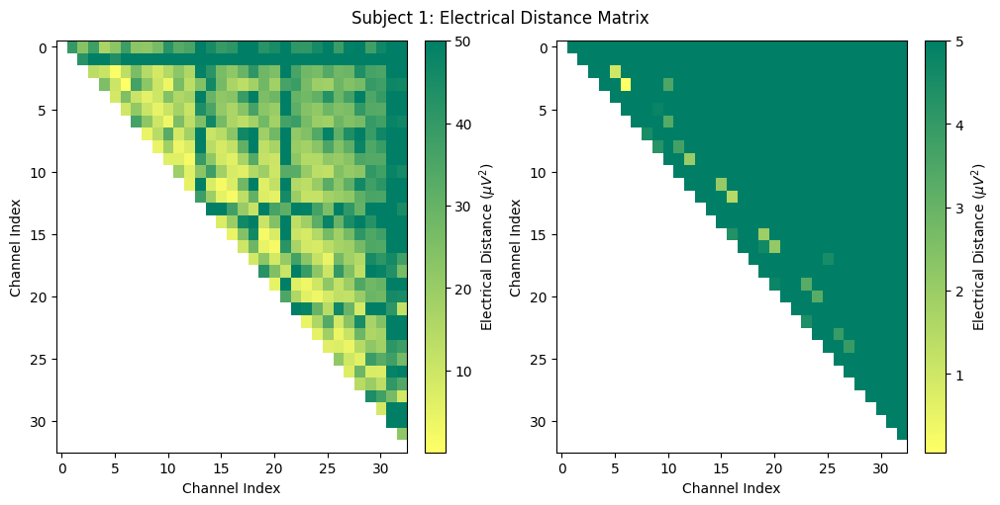

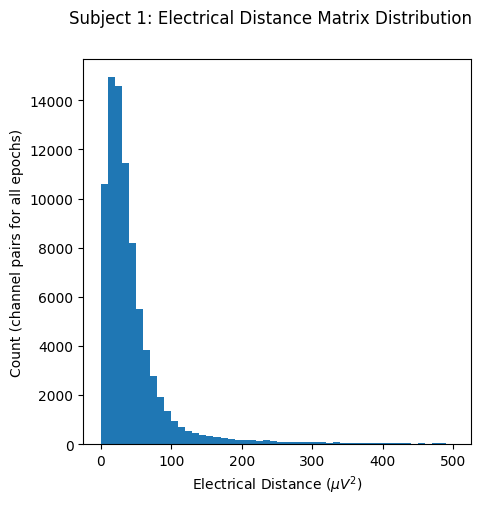

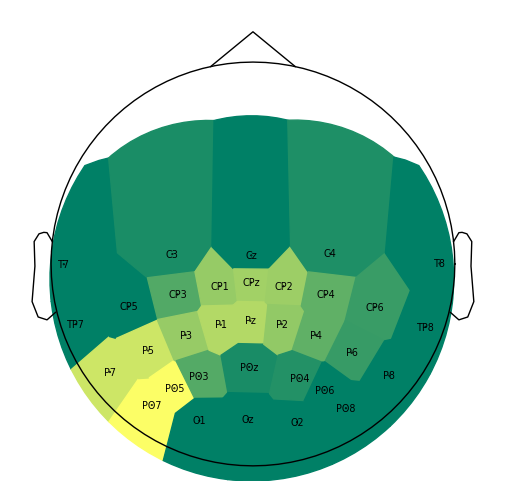

========================== Subject 2 ==========================

Local minimum 3.710370279872748 found
Bridge detected between P7 and PO7
Bridge detected between P7 and P5
Bridge detected between P7 and PO5
Bridge detected between P7 and P3
Bridge detected between P7 and PO3
Bridge detected between P7 and O1
Bridge detected between P7 and POz
Bridge detected between P7 and Oz
Bridge detected between PO7 and P5
Bridge detected between PO7 and PO5
Bridge detected between PO7 and P3
Bridge detected between PO7 and PO3
Bridge detected between PO7 and O1
Bridge detected between PO7 and POz
Bridge detected between PO7 and Oz
Bridge detected between P5 and PO5
Bridge detected between P5 and P3
Bridge detected between P5 and PO3
Bridge detected between P5 and O1
Bridge detected between P5 and POz
Bridge detected between P5 and Oz
Bridge detected between PO5 and P3
Bridge detected between PO5 and PO3
Bridge detected between PO5 and O1
Bridge detected between PO5 and POz
Bridge detected between 

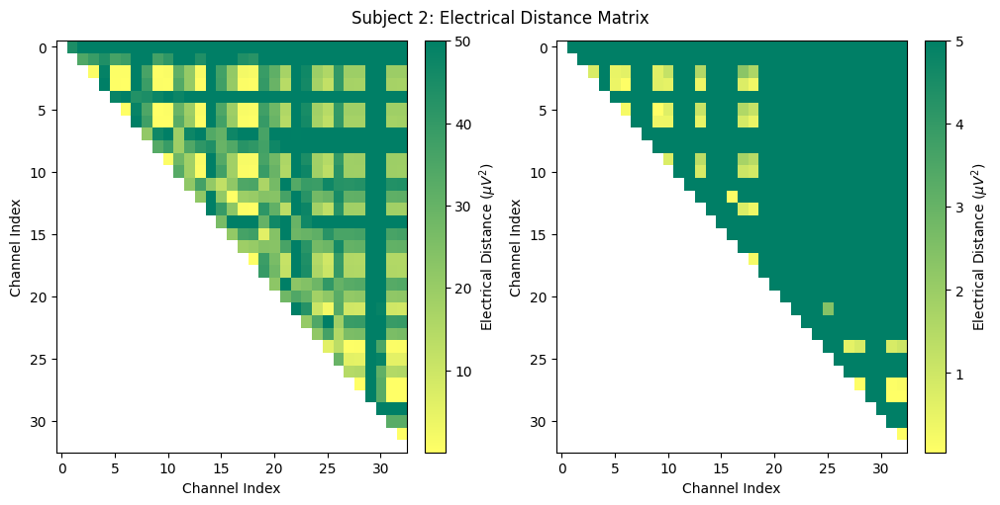

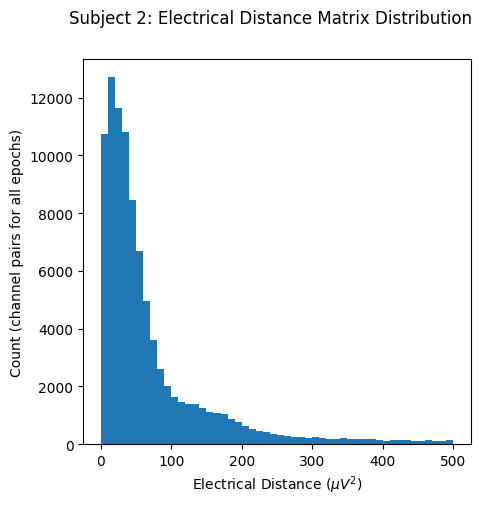

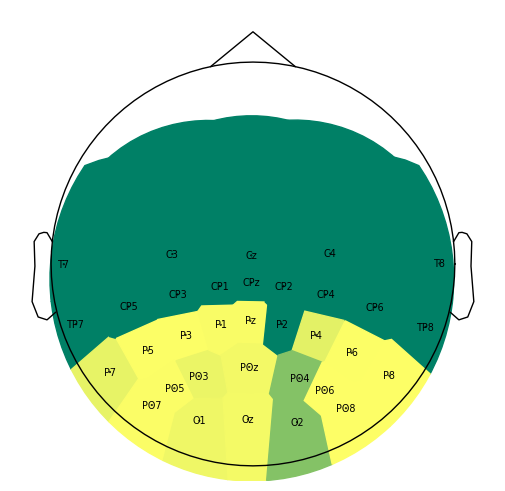

========================== Subject 3 ==========================

Local minimum 1.0598027740696417e-11 found


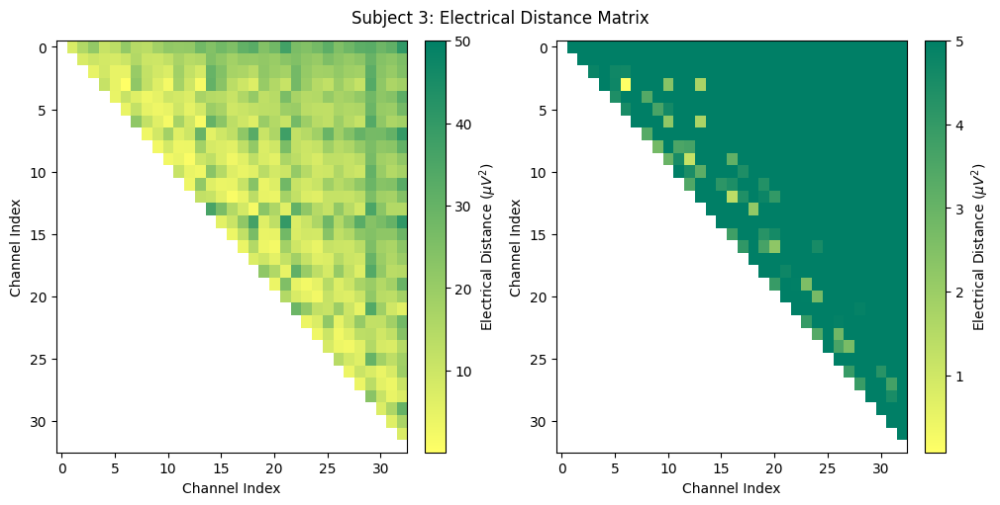

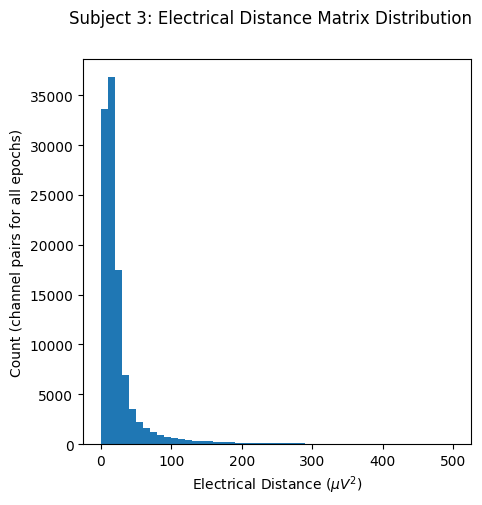

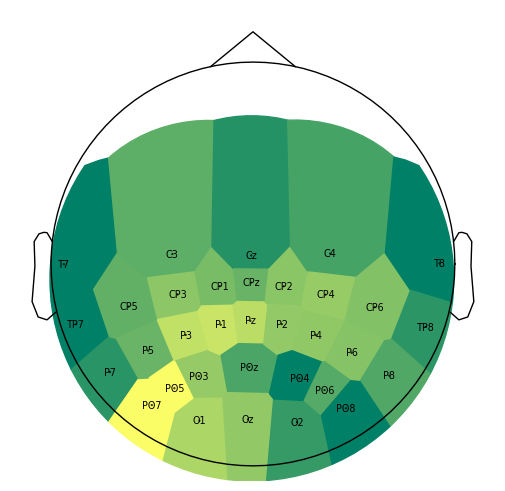

========================== Subject 4 ==========================

Local minimum 2.25046058274318 found
Bridge detected between P4 and P6
Bridge detected between PO6 and PO8


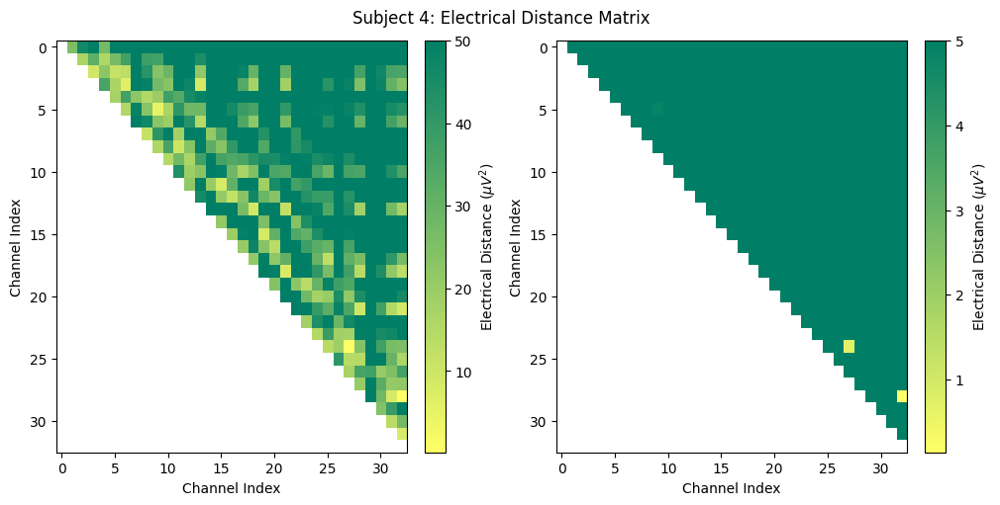

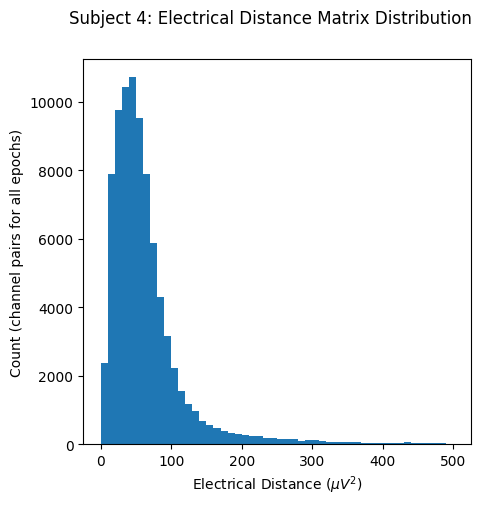

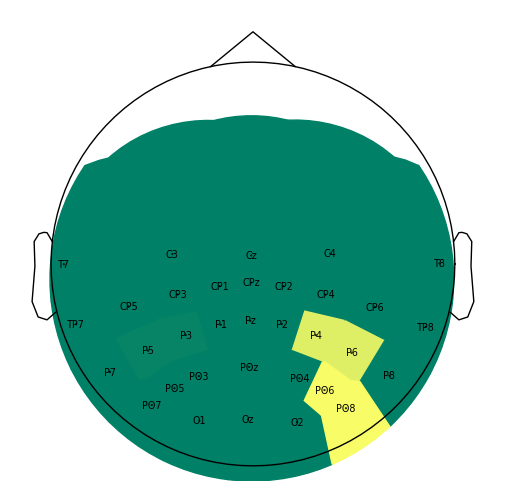

========================== Subject 5 ==========================

Local minimum 2.730782883675784 found
Bridge detected between PO7 and PO5


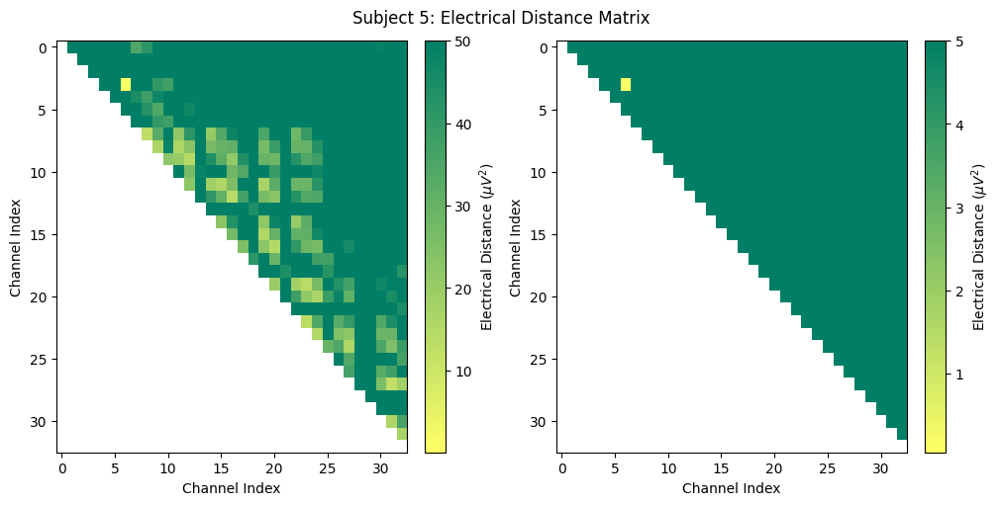

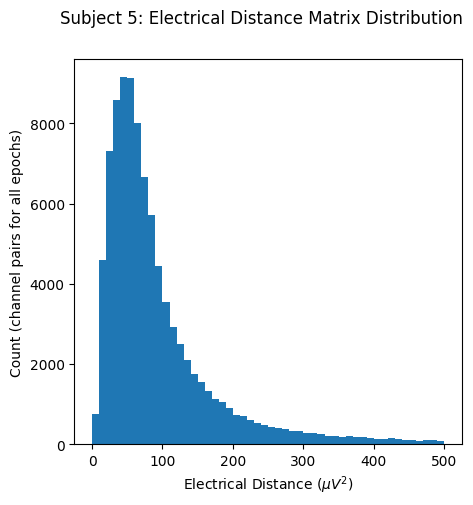

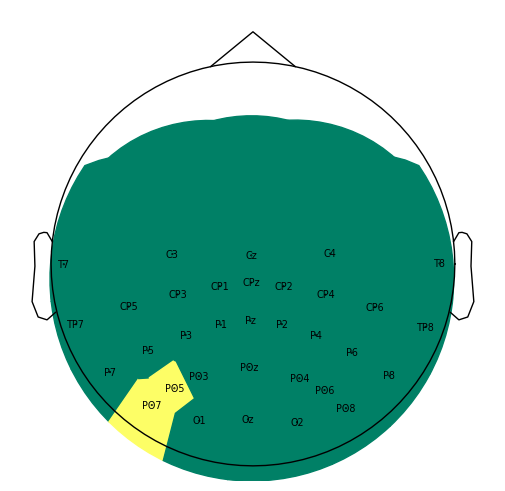

========================== Subject 6 ==========================

Local minimum 3.0067510761370575 found
Bridge detected between PO7 and PO5
Bridge detected between CP1 and CPz
Bridge detected between P1 and Pz
Bridge detected between P1 and P2
Bridge detected between Pz and P2


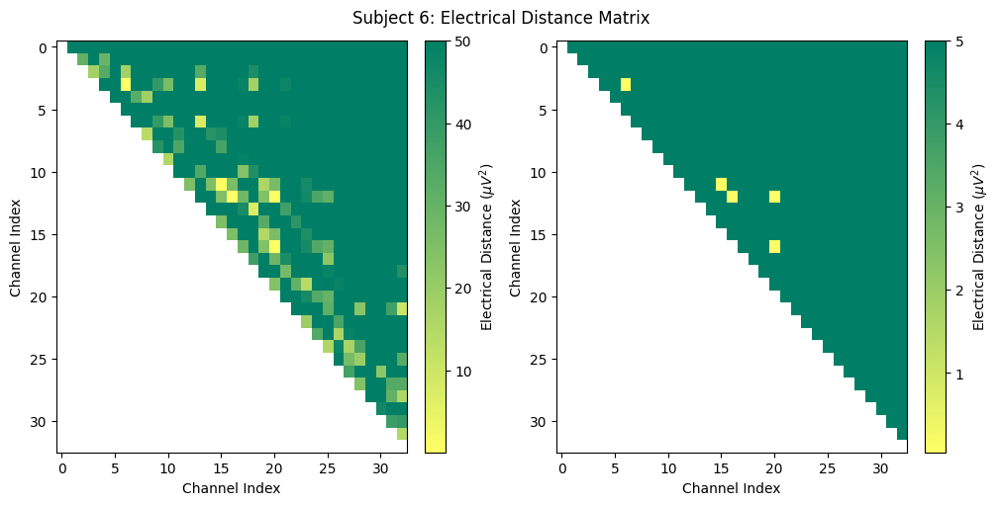

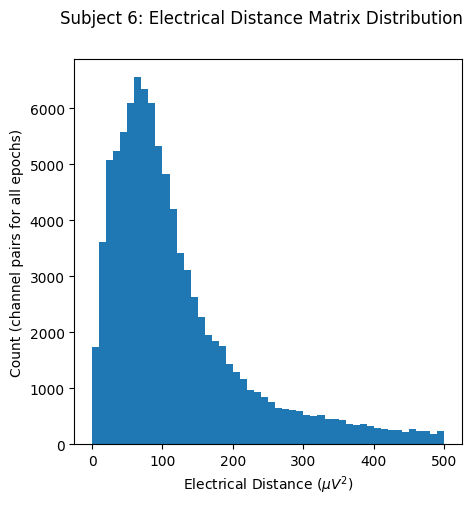

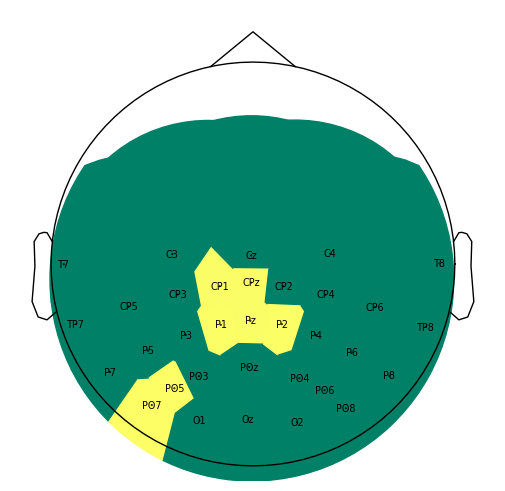

In [8]:
smearing_EEGs = []
all_ed_data = []

cmap = 'summer_r'

for subj in range(NUM_SUBJ):

    print(f"========================== Subject {subj + 1} ==========================\n")

    ## Examine an Electrical Distance Matrix

    ed_data = mne.preprocessing.compute_bridged_electrodes(interp_bad_ch_eeg[subj])
    bridged_idx, ed_matrix = ed_data

    all_ed_data.append(ed_data)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5), layout="constrained")
    fig.suptitle(f"Subject {subj + 1}: Electrical Distance Matrix")

    # take median across epochs, only use upper triangular, lower is NaNs
    ed_plot = np.zeros(ed_matrix.shape[1:]) * np.nan
    triu_idx = np.triu_indices(ed_plot.shape[0], 1)
    for idx0, idx1 in np.array(triu_idx).T:
        ed_plot[idx0, idx1] = np.nanmedian(ed_matrix[:, idx0, idx1])

    # plot full distribution color range
    im1 = ax1.imshow(ed_plot, aspect="auto", vmax=50, cmap = cmap)
    cax1 = fig.colorbar(im1, ax=ax1)
    cax1.set_label(r"Electrical Distance ($\mu$$V^2$)")

    # plot zoomed in colors
    im2 = ax2.imshow(ed_plot, aspect="auto", vmax=5, cmap = cmap)
    cax2 = fig.colorbar(im2, ax=ax2)
    cax2.set_label(r"Electrical Distance ($\mu$$V^2$)")
    for ax in (ax1, ax2):
        ax.set_xlabel("Channel Index")
        ax.set_ylabel("Channel Index")

    ## Examine the Distribution of Electrical Distances

    fig1, ax = plt.subplots(figsize=(5, 5))
    fig1.suptitle(f"Subject {subj + 1}: Electrical Distance Matrix Distribution")
    ax.hist(ed_matrix[~np.isnan(ed_matrix)], bins=np.linspace(0, 500, 51))
    ax.set_xlabel(r"Electrical Distance ($\mu$$V^2$)")
    ax.set_ylabel("Count (channel pairs for all epochs)")

    mne.viz.plot_bridged_electrodes(interp_bad_ch_eeg[subj].info,
                                    bridged_idx,
                                    ed_matrix,
                                      # Pass the axis to the plot function
                                    title=f"Subject {subj + 1}: Bridged Electrodes",
                                    topomap_args=dict(vlim=(None, 5),
                                                      size=10,
                                                      cmap=cmap,
                                                      sphere=(0.0011, 0.015, 0.12, 0.2),
                                                      ))


## Interpolating bridged channels based on the amount of connections

In [9]:
interp_smearing_EEGs = []

for subj in range(NUM_SUBJ):

    bridged_idx = all_ed_data[subj][0]

    num_smeared_electrodes = 0
    for i in bridged_idx:
        num_smeared_electrodes += len(i)

    print(f"Number of connections (Subject {subj + 1}): ", num_smeared_electrodes)

    if(len(bridged_idx) > 0 and num_smeared_electrodes <= 5):

        print("Interpolating connected channels.")

        interp_smearing_eeg = mne.preprocessing.interpolate_bridged_electrodes(interp_bad_ch_eeg[subj].copy(), 
                                                                               bridged_idx=bridged_idx)

        interp_smearing_EEGs.append(interp_smearing_eeg)

    else:

        print("No interpolation.")

        interp_smearing_EEGs.append(interp_bad_ch_eeg[subj].copy())

    print("\n")

Number of connections (Subject 1):  0
No interpolation.


Number of connections (Subject 2):  96
No interpolation.


Number of connections (Subject 3):  0
No interpolation.


Number of connections (Subject 4):  4
Interpolating connected channels.
Creating RawArray with float64 data, n_channels=1, n_times=654336
    Range : 0 ... 654335 =      0.000 ...   319.500 secs
Ready.
Creating RawArray with float64 data, n_channels=1, n_times=654336
    Range : 0 ... 654335 =      0.000 ...   319.500 secs
Ready.
Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 31 sensor positions
Interpolating 4 sensors


Number of connections (Subject 5):  2
Interpolating connected channels.
Creating RawArray with float64 data, n_channels=1, n_times=735232
    Range : 0 ... 735231 =      0.000 ...   359.000 secs
Ready.
Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating 

## Re-referencing (Common Average)

CAR reference can be useful but if noisy channels are contained in the averaging, this noise is propagated to the entire scalp. This can be seen in Sara EEG in the SNR and PSD graphs. The SSVEP is propagated to the rest of the signal, thus increasing the average SNR, mainly at the SSVEP and their harmonics (10 and 15 Hz). Furthermore, spread activity like the P300 can will appear reduced.

In [10]:
rereferenced_EEGs = []

for subj in range(NUM_SUBJ):

    if (CAR_REF):

        print(f"Subject {subj + 1}: Rereferencing EEG (Common Average Reference) \n")
        
        car = mne.set_eeg_reference(interp_smearing_EEGs[subj],
                                    ref_channels='average',
                                    copy = True)

        rereferenced_EEGs.append(car[0])
        
        print("\n")
    
    else:

        rereferenced_EEGs.append(interp_smearing_EEGs[subj])



Subject 1: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 2: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 3: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 4: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 5: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 6: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a cus

## Isolating the LDR channel

In [11]:
def plot_isolated_signal(time, signal, th, title):
    figure(figsize = (300,20))
    plt.plot(time, signal, linewidth = 2);
    plt.title(title, fontsize = 100, fontweight = 'bold')
    plt.xlabel('Time (min)', fontsize = 85, fontweight = 'bold')
    plt.ylabel('Voltage (V)', fontsize = 85, fontweight = 'bold')
    plt.xticks(np.arange(0, np.max(time), 0.05), fontsize = 30)
    plt.yticks(np.arange(np.min(signal), np.max(signal), 0.1), fontsize = 30)
    plt.xlim([0,max(time)])
    plt.axhline(y = th, color = 'k', linestyle = '--', linewidth = 2)
    plt.grid()

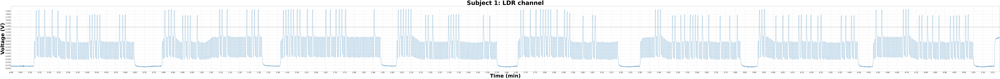

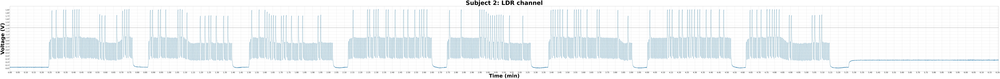

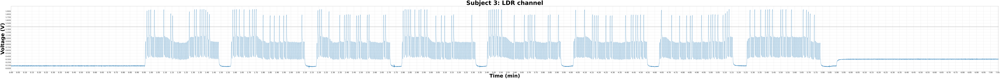

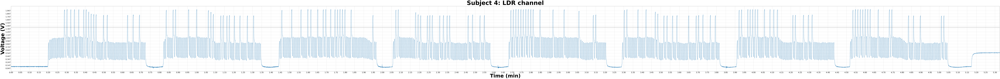

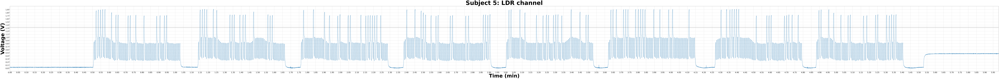

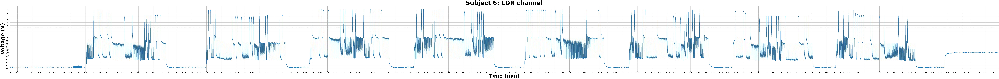

In [12]:
ldr_ch_idx = mne.pick_channels(ch, include = ['dc01+'])

th = 1.4 # y value threshold to segment signal

segmentation_LDRs = []
time_vectors = []

for subj in range(NUM_SUBJ):

    ldr_ch = EEGs[subj].get_data(picks = ch[ldr_ch_idx[0]])
    if (np.mean(ldr_ch) < 0): # If the polarity was inverted
        print("Inverting signal...")
        ldr_ch = ldr_ch * -1
    ''' 
    The bright square (more light) will decrease the resistance of the LDR, thus producing more voltage
    aproximating 2.4V if the polarity of the component was right or -2.4V if the polarity was inverted

    The dark square will increase the resistance to the MOhm range and cause the signal to be almost 0.
    This is because all the voltage will be sucked by the first component (LDR) of the voltage divider.
    '''

    time = np.arange(0, np.size(ldr_ch,1)/fs, 1/fs) # Time vector of the acquisition in s

    segmentation_LDRs.append(ldr_ch)
    time_vectors.append(time)

    plot_isolated_signal(time/60, ldr_ch[0][:], th, f"Subject {subj + 1}: LDR channel") # time/60 = timevector in minutes
    plt.show()

### Checking different filter effects on the LDR channel to see if the instances each images appear are maintained

In [13]:
def moving_aver(ldr_ch_snip, window_size):

    b = np.ones(window_size) / window_size

    # Apply filtering with appropriate padding mode
    filtered_data = filtfilt(b, 
                             1, 
                             ldr_ch_snip, 
                             padlen=window_size - 1)

    return filtered_data

In [14]:
'''
ldr_ch_snip = ldr_ch[0][153000:157800]
time_snip = time[153000:157800]/60

figure(figsize = (16,6))
plt.plot(time_snip, ldr_ch_snip, "b", linewidth = 3, label = "Raw");
plt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 101), "orange", linestyle = "--",linewidth = 2, label = "Median filter (n = 101)");
plt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 201), "k--", linewidth = 2, label = "Median filter (n = 201)");
plt.plot(time_snip, moving_aver(ldr_ch_snip, 101), "r:", linewidth = 3, label = "Mean filter (n = 101)");
plt.plot(time_snip, moving_aver(ldr_ch_snip, 201), "g:", linewidth = 3, label = "Mean filter (n = 201)");


plt.title("Effects on different filters on the synchronization channel")
plt.xlabel("Time (min)")
plt.ylabel("Voltage (V)")
plt.xlim([np.min(time_snip), np.max(time_snip)])
plt.legend()
plt.grid()

plt.show()
'''

'\nldr_ch_snip = ldr_ch[0][153000:157800]\ntime_snip = time[153000:157800]/60\n\nfigure(figsize = (16,6))\nplt.plot(time_snip, ldr_ch_snip, "b", linewidth = 3, label = "Raw");\nplt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 101), "orange", linestyle = "--",linewidth = 2, label = "Median filter (n = 101)");\nplt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 201), "k--", linewidth = 2, label = "Median filter (n = 201)");\nplt.plot(time_snip, moving_aver(ldr_ch_snip, 101), "r:", linewidth = 3, label = "Mean filter (n = 101)");\nplt.plot(time_snip, moving_aver(ldr_ch_snip, 201), "g:", linewidth = 3, label = "Mean filter (n = 201)");\n\n\nplt.title("Effects on different filters on the synchronization channel")\nplt.xlabel("Time (min)")\nplt.ylabel("Voltage (V)")\nplt.xlim([np.min(time_snip), np.max(time_snip)])\nplt.legend()\nplt.grid()\n\nplt.show()\n'

A 201 points median filter seems to be enough to smooth the signal without causing phase shifts

## Filtering the LDR channel based on the best approach to smooth the signal without altering the edges' instances (Median filter)

In [15]:
n_filt = 201

segmentation_filt_LDRs = []

for subj in range(NUM_SUBJ):

    print(f"\nSubject {subj + 1}: Filtering LDR channel")
    print("Average Voltage (LDR): ", np.mean(segmentation_LDRs[subj]))

    filt_ldr_ch = scipy.signal.medfilt(segmentation_LDRs[subj][:][0], n_filt) 
    # The filter applies a zero pad automatically at the edges

    segmentation_filt_LDRs.append(filt_ldr_ch)

#plot_isolated_signal(time/60, filt_ldr_ch, th, "Filtered LDR channel")
#plt.show()


Subject 1: Filtering LDR channel
Average Voltage (LDR):  0.6902009833796161

Subject 2: Filtering LDR channel
Average Voltage (LDR):  0.6410314115340535

Subject 3: Filtering LDR channel
Average Voltage (LDR):  0.5543055546826783

Subject 4: Filtering LDR channel
Average Voltage (LDR):  0.6837006638390913

Subject 5: Filtering LDR channel
Average Voltage (LDR):  0.6277812978371932

Subject 6: Filtering LDR channel
Average Voltage (LDR):  0.6060652598898814


# **Segmenting the EEG**

## Detecting the edges on the LDR channel

In [16]:
def condition_segmentation(ldr, th):
    
    last_low = True
    last_high = False
    
    rising_edges = []
    falling_edges = []

    for index, val in enumerate(ldr):

        if val >= th: # Possible rising edge
            if last_low: # Found rising edge
                rising_edges.append(index) 
            
            last_low = False
            last_high = True
        
        elif val <= th: # Possible falling edge
            if last_high:
                falling_edges.append(index)

            last_low = True
            last_high = False

    return rising_edges, falling_edges

In [17]:
d_th = th - 0.1 # Divinding the LDR channel in the target and non target range
t_th = th

nt_th = 0.66
ssvep_th = 0.23

all_t_rising_edges = []
all_t_falling_edges = []

all_nt_rising_edges = []
all_nt_falling_edges = []

all_ssvep_rising_edges = []
all_ssvep_falling_edges = []

for subj in range(NUM_SUBJ):

    # Target trials
    target_range = [val if val >= d_th else d_th for val in segmentation_filt_LDRs[subj]]
    t_rising_edges, t_falling_edges = condition_segmentation(target_range, t_th)

    all_t_rising_edges.append(t_rising_edges)
    all_t_falling_edges.append(t_falling_edges)

    # Non target trials
    nontarget_range = [val if val <= d_th else d_th for val in segmentation_filt_LDRs[subj]]
    nt_rising_edges, nt_falling_edges = condition_segmentation(nontarget_range, nt_th)

    if(len(nt_rising_edges) > len(nt_falling_edges)):
        nt_rising_edges.pop(-1)

    all_nt_rising_edges.append(nt_rising_edges)
    all_nt_falling_edges.append(nt_falling_edges)

    # SSVEP trial blocks
    trialBlock_range = [val if val <= ssvep_th else d_th for val in segmentation_filt_LDRs[subj]]
    ssvep_rising_edges, ssvep_falling_edges = condition_segmentation(trialBlock_range, ssvep_th - 0.03)

    ssvep_rising_edges.pop(-1) # After finishing the protocol there is one non-relevant rising edge

    all_ssvep_rising_edges.append(ssvep_rising_edges)
    all_ssvep_falling_edges.append(ssvep_falling_edges)

'''
plot_isolated_signal(time/60, filt_ldr_ch, t_th, "Filtered LDR channel with target segmentation")
for idx, start_sample in enumerate(t_rising_edges):
    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[t_rising_edges[idx]:t_falling_edges[idx]])/fs}")
    plt.axvline(x = start_sample/fs/60, color = 'g', linestyle = ':', linewidth = 2)
    plt.axvline(x = t_falling_edges[idx]/fs/60, color = 'r', linestyle = ':', linewidth = 2)
plt.show()


plot_isolated_signal(time/60, filt_ldr_ch, nt_th, "Filtered LDR channel with non-target segmentation")
for idx, start_sample in enumerate(nt_rising_edges):
    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[nt_rising_edges[idx]:nt_falling_edges[idx]])/fs}")
    plt.axvline(x = start_sample/fs/60, color = 'g', linestyle = ':', linewidth = 2)
    plt.axvline(x = nt_falling_edges[idx]/fs/60, color = 'r', linestyle = ':', linewidth = 2)
plt.show()
'''

'\nplot_isolated_signal(time/60, filt_ldr_ch, t_th, "Filtered LDR channel with target segmentation")\nfor idx, start_sample in enumerate(t_rising_edges):\n    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[t_rising_edges[idx]:t_falling_edges[idx]])/fs}")\n    plt.axvline(x = start_sample/fs/60, color = \'g\', linestyle = \':\', linewidth = 2)\n    plt.axvline(x = t_falling_edges[idx]/fs/60, color = \'r\', linestyle = \':\', linewidth = 2)\nplt.show()\n\n\nplot_isolated_signal(time/60, filt_ldr_ch, nt_th, "Filtered LDR channel with non-target segmentation")\nfor idx, start_sample in enumerate(nt_rising_edges):\n    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[nt_rising_edges[idx]:nt_falling_edges[idx]])/fs}")\n    plt.axvline(x = start_sample/fs/60, color = \'g\', linestyle = \':\', linewidth = 2)\n    plt.axvline(x = nt_falling_edges[idx]/fs/60, color = \'r\', linestyle = \':\', linewidth = 2)\nplt.show()\n'

# **Frequency tagging and SNR estimation of the SSVEP component on the EEG comprised by the 14 trial blocks**
https://mne.tools/dev/auto_tutorials/time-freq/50_ssvep.html

In [18]:
all_ssvep_epochs = []

events_id = dict(trialBlocks=0)

for subj in range(NUM_SUBJ):

    print(f"\n------ Subject {subj + 1}: SSVEP Epochs ------")

    ssvep_events = []
    for tb in range(len(all_ssvep_rising_edges[subj])):
        ssvep_events.append([all_ssvep_rising_edges[subj][tb], 0 , 0])

    tmax = round((all_ssvep_falling_edges[subj][0] - all_ssvep_rising_edges[subj][0])/fs,0)
    print("Window size: ", tmax)

    ssvep_epochs = mne.Epochs(rereferenced_EEGs[subj], 
                              ssvep_events, 
                              event_id = events_id, 
                              tmin = 0, 
                              tmax = tmax, 
                              baseline=None, 
                              event_repeated = 'error')
    
    all_ssvep_epochs.append(ssvep_epochs)


------ Subject 1: SSVEP Epochs ------
Window size:  32.0
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated

------ Subject 2: SSVEP Epochs ------
Window size:  32.0
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated

------ Subject 3: SSVEP Epochs ------
Window size:  32.0
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated

------ Subject 4: SSVEP Epochs ------
Window size:  32.0
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated

------ Subject 5: SSVEP Epochs ------
Window size:  32.0
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated

------ Subject 6: SSVEP Epochs ------
Window size:  32.0
Not setting metadata
8 matching events found
No baseline correction applied
0 projection items activated


### Calculate power spectral density (PSD)

In [19]:
tmin = 1 # SSVEP response can often take a while to stabilize and the transient phase in the beginning can distort the signal estimate.
fmin = 1
fmax = 28

all_psds = []

for subj in range(NUM_SUBJ):

    spectrum = all_ssvep_epochs[subj].compute_psd("welch",
                                                  n_fft=int(fs * (tmax - tmin)),
                                                  n_overlap=0,
                                                  n_per_seg=None,
                                                  tmin=tmin,
                                                  tmax=tmax,
                                                  fmin=fmin,
                                                  fmax=fmax,
                                                  window="boxcar",
                                                  verbose=False)

    psds, freqs = spectrum.get_data(return_freqs=True)

    all_psds.append(psds)

### Calculate signal to noise ratio (SNR)

In [20]:
def snr_spectrum(psd, noise_n_neighbor_freqs=3, noise_skip_neighbor_freqs=1):
    """Compute SNR spectrum from PSD spectrum using convolution.

    Parameters
    ----------
    psd : ndarray, shape ([n_trials, n_channels,] n_frequency_bins)
        Data object containing PSD values. Works with arrays as produced by
        MNE's PSD functions or channel/trial subsets.
    noise_n_neighbor_freqs : int
        Number of neighboring frequencies used to compute noise level.
        increment by one to add one frequency bin ON BOTH SIDES
    noise_skip_neighbor_freqs : int
        set this >=1 if you want to exclude the immediately neighboring
        frequency bins in noise level calculation

    Returns
    -------
    snr : ndarray, shape ([n_trials, n_channels,] n_frequency_bins)
        Array containing SNR for all epochs, channels, frequency bins.
        NaN for frequencies on the edges, that do not have enough neighbors on
        one side to calculate SNR.
    """
    # Construct a kernel that calculates the mean of the neighboring
    # frequencies
    averaging_kernel = np.concatenate(
        (
            np.ones(noise_n_neighbor_freqs),
            np.zeros(2 * noise_skip_neighbor_freqs + 1),
            np.ones(noise_n_neighbor_freqs),
        )
    )
    averaging_kernel /= averaging_kernel.sum()

    # Calculate the mean of the neighboring frequencies by convolving with the
    # averaging kernel.
    mean_noise = np.apply_along_axis(
        lambda psd_: np.convolve(psd_, averaging_kernel, mode="valid"), axis=-1, arr=psd
    )

    # The mean is not defined on the edges so we will pad it with nas. The
    # padding needs to be done for the last dimension only so we set it to
    # (0, 0) for the other ones.
    edge_width = noise_n_neighbor_freqs + noise_skip_neighbor_freqs
    pad_width = [(0, 0)] * (mean_noise.ndim - 1) + [(edge_width, edge_width)]
    mean_noise = np.pad(mean_noise, pad_width=pad_width, constant_values=np.nan)

    return psd / mean_noise

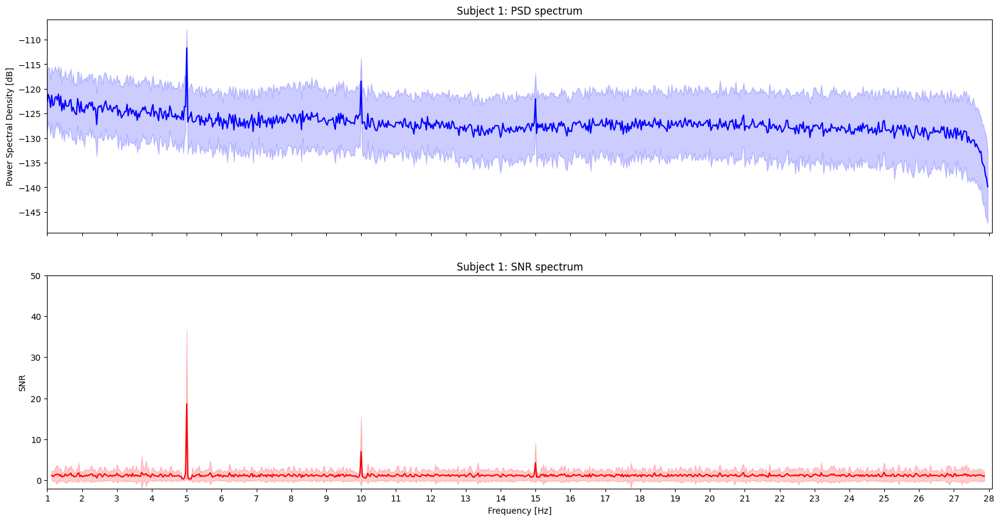

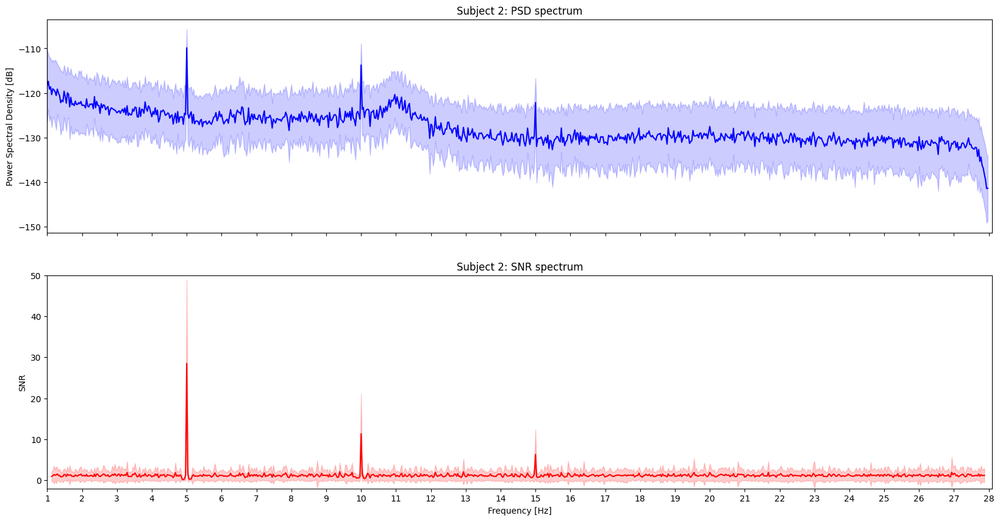

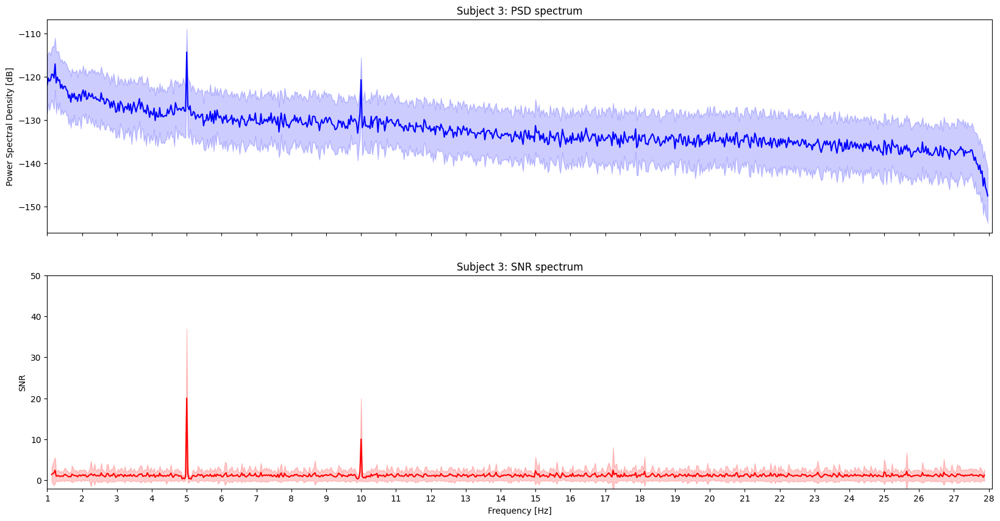

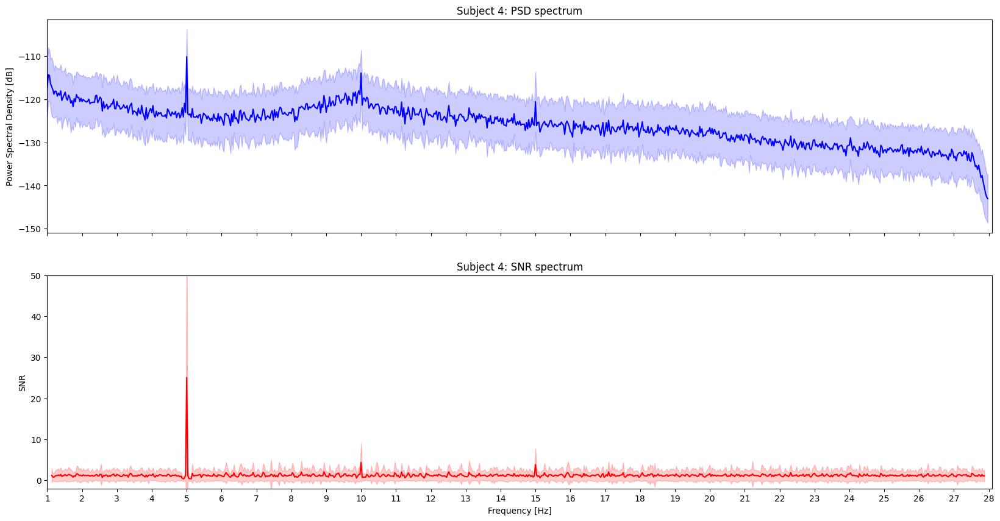

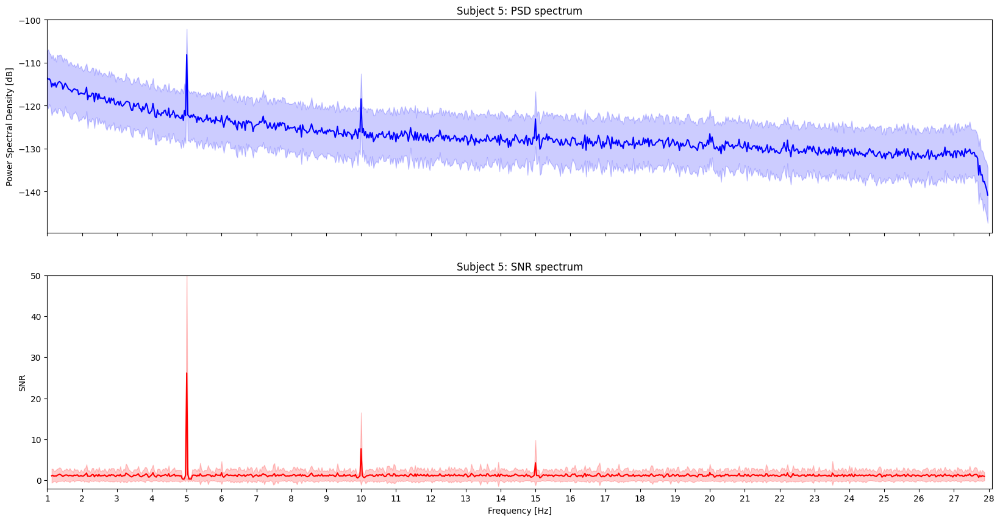

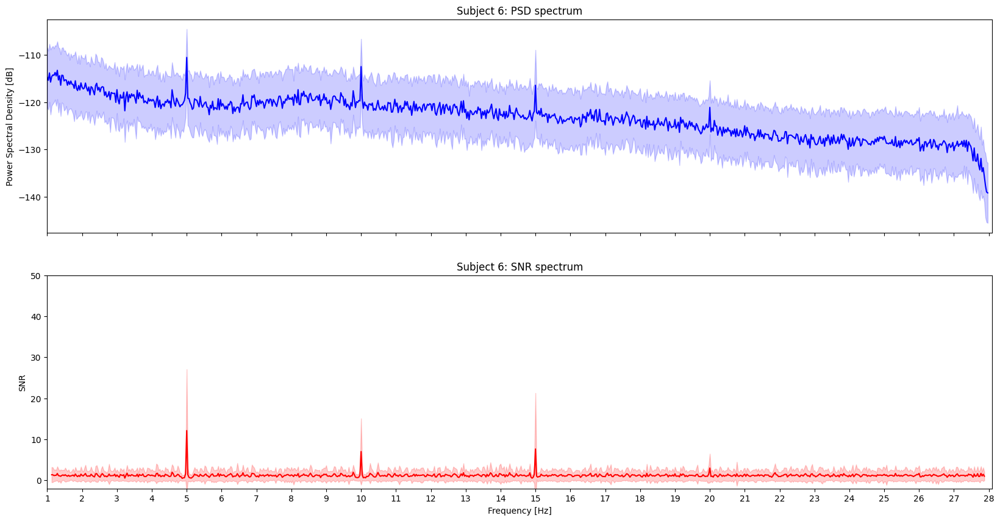

In [21]:
all_snrs = []

for subj in range(NUM_SUBJ):   

    snrs = snr_spectrum(all_psds[subj], noise_n_neighbor_freqs=3, noise_skip_neighbor_freqs=1)
    all_snrs.append(snrs)

    fig, axes = plt.subplots(2, 1, sharex="all", sharey="none", figsize=(20, 10));
    freq_range = range(
        np.where(np.floor(freqs) == 1.0)[0][0],  np.where(np.ceil(freqs) == fmax)[0][-1]
    )

    psds_plot = 10 * np.log10(all_psds[subj])
    psds_mean = psds_plot.mean(axis=(0, 1))[freq_range]
    psds_std = psds_plot.std(axis=(0, 1))[freq_range]
    axes[0].plot(freqs[freq_range], psds_mean, color="b");
    axes[0].fill_between(
        freqs[freq_range], psds_mean - psds_std, psds_mean + psds_std, color="b", alpha=0.2
    );
    axes[0].set(title=f"Subject {subj + 1}: PSD spectrum", 
                ylabel="Power Spectral Density [dB]",
                xticks = np.arange(fmin, fmax + 0.1, 0.5));

    # SNR spectrum
    snr_mean = snrs.mean(axis=(0, 1))[freq_range]
    snr_std = snrs.std(axis=(0, 1))[freq_range]

    axes[1].plot(freqs[freq_range], snr_mean, color="r")
    axes[1].fill_between(
        freqs[freq_range], snr_mean - snr_std, snr_mean + snr_std, color="r", alpha=0.2
    );
    axes[1].set(
        title=f"Subject {subj + 1}: SNR spectrum",
        xlabel="Frequency [Hz]",
        ylabel="SNR",
        ylim=[-2, 50],
        xlim=[fmin, fmax + 0.1],
        xticks = np.arange(fmin, fmax + 0.1, 1)
    );
    plt.show();

### Extract SNR values at the stimulation frequency

In [22]:
stim_freq = 5 # Hz
harmonic1 = 10
harmonic2 = 15

# Find index of frequency bin closest to stimulation frequency and its harmonics
i_bin_5hz = np.argmin(abs(freqs - stim_freq))
i_bin_10hz = np.argmin(abs(freqs - harmonic1))
i_bin_15hz = np.argmin(abs(freqs - harmonic2))

# Define different ROIs
roi_vis = [
    "POz",
    "Oz",
    "O1",
    "O2"
]  # visual roi

# Find corresponding indices using mne.pick_types()
picks_roi_vis = mne.pick_types(all_ssvep_epochs[subj].info, 
                               eeg=True, 
                               stim=False, 
                               selection=roi_vis
)

all_snrs_target = []
all_snrs_target_h1 = []
all_snrs_target_h2 = []

for subj in range(NUM_SUBJ):

    print(f"Subject {subj + 1}: Average SNR")

    snrs_target = all_snrs[subj][:, :, i_bin_5hz][:, picks_roi_vis]
    all_snrs_target.append(snrs_target)
    print("SNR at 5 Hz")
    print(f"Average SNR (occipital ROI): {snrs_target.mean()}")

    snrs_target_h1 = all_snrs[subj][:, :, i_bin_10hz][:, picks_roi_vis]
    all_snrs_target_h1.append(snrs_target_h1)
    print("SNR at 10 Hz")
    print(f"Average SNR (occipital ROI): {snrs_target_h1.mean()}")

    snrs_target_h2 = all_snrs[subj][:, :, i_bin_15hz][:, picks_roi_vis]
    all_snrs_target_h2.append(snrs_target_h2)
    print("SNR at 15 Hz")
    print(f"Average SNR (occipital ROI): {snrs_target_h2.mean()}")

    print("\n")


Subject 1: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 28.313518828732708
SNR at 10 Hz
Average SNR (occipital ROI): 10.590977223258927
SNR at 15 Hz
Average SNR (occipital ROI): 3.0940651254786875


Subject 2: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 42.311573284749045
SNR at 10 Hz
Average SNR (occipital ROI): 18.827599108146014
SNR at 15 Hz
Average SNR (occipital ROI): 10.05722125363354


Subject 3: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 27.8186421731949
SNR at 10 Hz
Average SNR (occipital ROI): 12.956604296085567
SNR at 15 Hz
Average SNR (occipital ROI): 2.8945538144672236


Subject 4: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 39.599585789183074
SNR at 10 Hz
Average SNR (occipital ROI): 3.5951107663908175
SNR at 15 Hz
Average SNR (occipital ROI): 2.966900923329163


Subject 5: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 57.61380040882747
SNR at 10 Hz
Average SNR (occipital ROI): 9.709670834270003
SNR at 15 Hz
Average SNR (occipita

### Topography of the SSVEP (Main frequency - 5Hz)

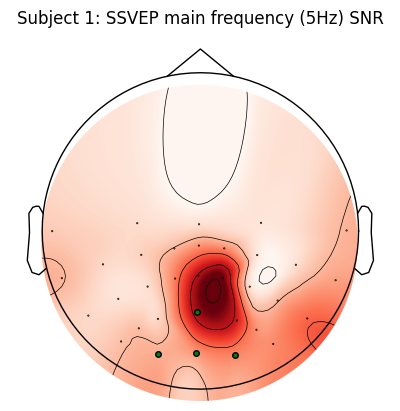

Subject 1: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 18.64711000359371
average SNR (occipital ROI): 28.313518828732708


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 2.907, p = 0.023




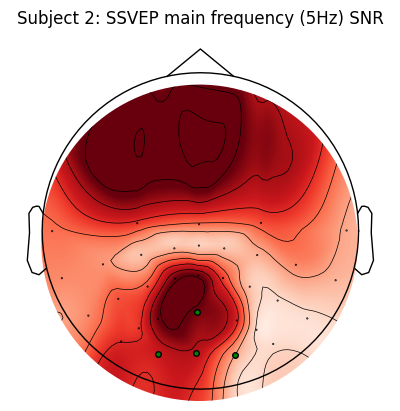

Subject 2: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 28.489700633806315
average SNR (occipital ROI): 42.311573284749045


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 3.379, p = 0.012




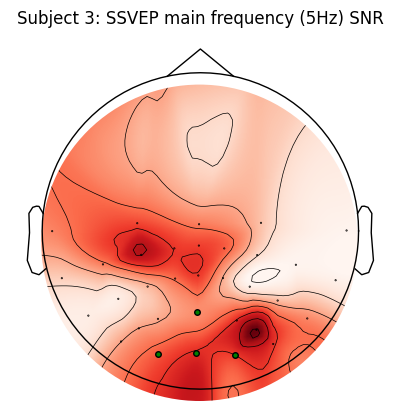

Subject 3: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 20.038500857510545
average SNR (occipital ROI): 27.8186421731949


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 4.545, p = 0.003




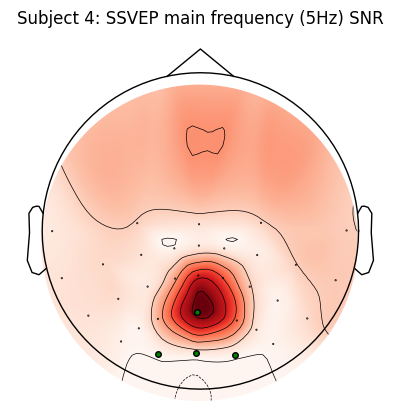

Subject 4: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 25.048283782901485
average SNR (occipital ROI): 39.599585789183074


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- No ------------

Stats: t = 1.643, p = 0.144




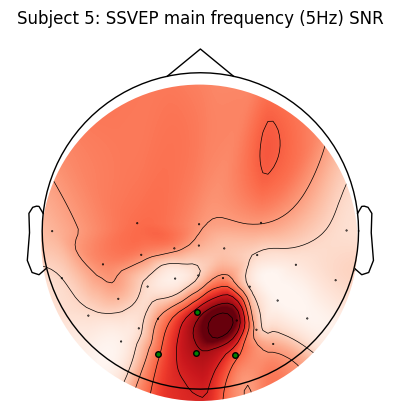

Subject 5: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 26.16175044807807
average SNR (occipital ROI): 57.61380040882747


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 4.895, p = 0.002




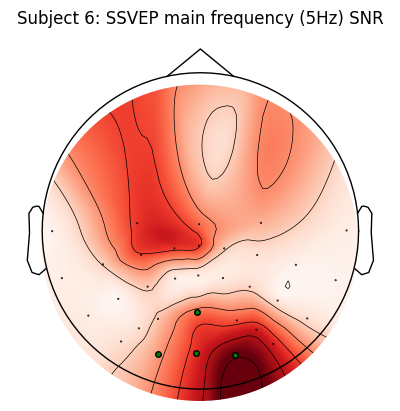

Subject 6: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 12.124747050987787
average SNR (occipital ROI): 24.45930465987957


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 5.499, p = 0.001




In [23]:
from scipy.stats import ttest_rel

# Mask to highlight electrodes on the region of interest
roi_vis_idx = pick_channels(clean_ch, roi_vis)

mk = dict(marker='o', 
          markerfacecolor='g', 
          markeredgecolor='k',
          linewidth=0, 
          markersize=4)

highlight_ch = [1 if c in roi_vis_idx else 0 for c in range(len(clean_ch))]

for subj in range(NUM_SUBJ):

    # Get average SNR at 5 Hz for ALL channels
    snrs_5hz = all_snrs[subj][:, :, i_bin_5hz]
    snrs_5hz_ch_average = snrs_5hz.mean(axis=0)

    # Plot SNR topography
    fig, ax = plt.subplots(1)
    ax.set_title(f"Subject {subj + 1}: SSVEP main frequency (5Hz) SNR")
    mne.viz.plot_topomap(snrs_5hz_ch_average, 
                         all_ssvep_epochs[subj][subj].info,
                         mask = np.array(highlight_ch), 
                         mask_params = mk,
                         vlim=(1, None), 
                         axes=ax, 
                         size = 10,
                         sphere=(0.0011, 0.015, 0.12, 0.2))

    print(f"Subject {subj +1}: SNR at 5 Hz SSVEP stumulation")
    print(f"average SNR (all channels): {snrs_5hz_ch_average.mean()}")
    print(f"average SNR (occipital ROI): {all_snrs_target[subj].mean()}")
    print("\n")

    tstat_roi_vs_scalp = ttest_rel(all_snrs_target[subj].mean(axis=1), snrs_5hz.mean(axis=1))
    print("Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?")

    if(tstat_roi_vs_scalp[1] > 0.05):
        print("\n----------- No ------------\n")
    else:
        print("\n----------- Yes -----------\n")

    print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

### 1st Harmonic (10 Hz)

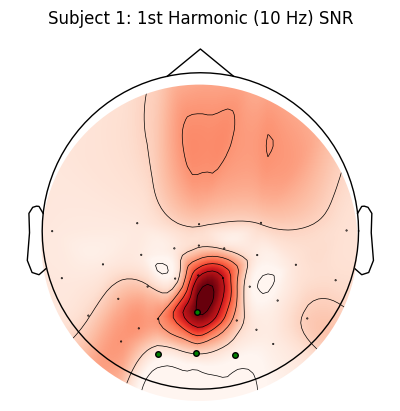

Subject 1: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 7.028337475168127
average SNR (occipital ROI): 10.590977223258927


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- Yes -----------

Stats: t = 2.696, p = 0.031




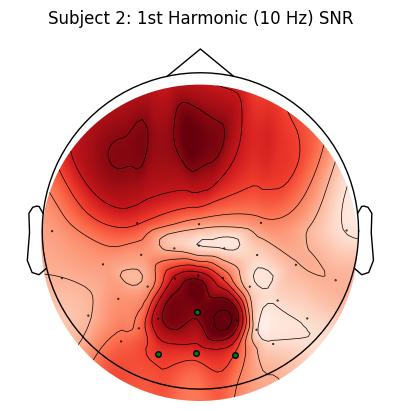

Subject 2: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 11.35008363804686
average SNR (occipital ROI): 18.827599108146014


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- Yes -----------

Stats: t = 5.361, p = 0.001




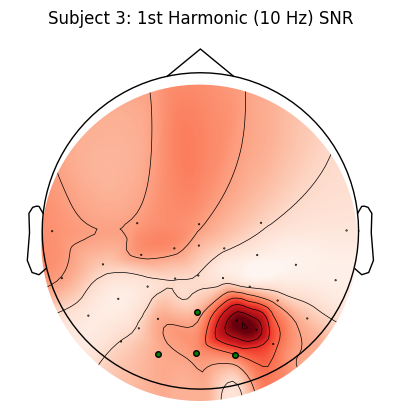

Subject 3: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 10.051080816105566
average SNR (occipital ROI): 12.956604296085567


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- Yes -----------

Stats: t = 3.023, p = 0.019




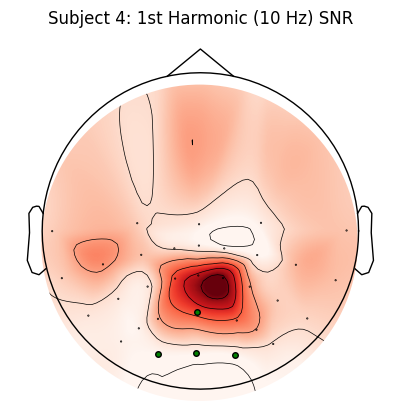

Subject 4: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 4.35334095590756
average SNR (occipital ROI): 3.5951107663908175


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = -1.280, p = 0.241




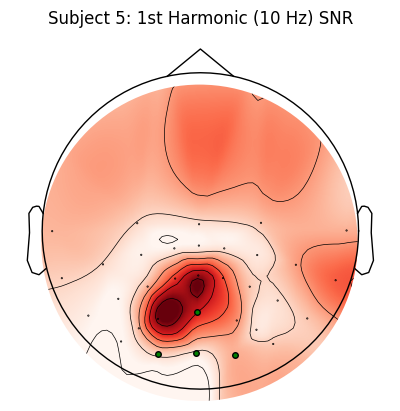

Subject 5: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 7.715669054462967
average SNR (occipital ROI): 9.709670834270003


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = 1.486, p = 0.181




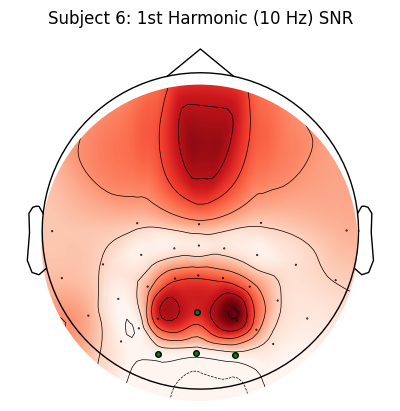

Subject 6: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 7.014169574833534
average SNR (occipital ROI): 6.252798620258197


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = -1.065, p = 0.322




In [24]:

for subj in range(NUM_SUBJ):

    # Get average SNR at 5 Hz for ALL channels
    snrs_10hz = all_snrs[subj][:, :, i_bin_10hz]
    snrs_10hz_ch_average = snrs_10hz.mean(axis=0)

    # Plot SNR topography
    fig, ax = plt.subplots(1)
    ax.set_title(f"Subject {subj + 1}: 1st Harmonic (10 Hz) SNR")
    mne.viz.plot_topomap(snrs_10hz_ch_average, 
                         all_ssvep_epochs[subj][subj].info, 
                         mask = np.array(highlight_ch), 
                         mask_params = mk,
                         vlim=(1, None),
                         axes=ax,
                         size = 10,
                         sphere=(0.0011, 0.015, 0.12, 0.2))

    print(f"Subject {subj +1}: SNR at 5 Hz SSVEP stumulation")
    print(f"average SNR (all channels): {snrs_10hz_ch_average.mean()}")
    print(f"average SNR (occipital ROI): {all_snrs_target_h1[subj].mean()}")
    print("\n")

    tstat_roi_vs_scalp = ttest_rel(all_snrs_target_h1[subj].mean(axis=1), snrs_10hz.mean(axis=1))
    print("Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?")

    if(tstat_roi_vs_scalp[1] > 0.05):
        print("\n----------- No ------------\n")
    else:
        print("\n----------- Yes -----------\n")

    print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

### 2nd Harmonic (15 Hz)

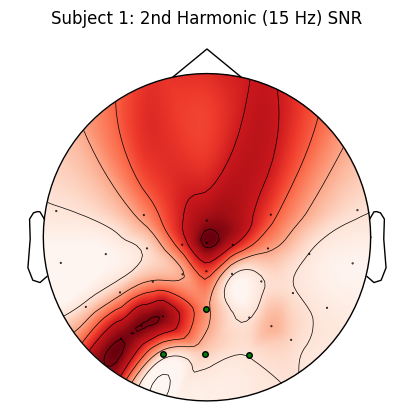

Subject 1: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 4.271366843232657
average SNR (occipital ROI): 3.0940651254786875


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = -1.400, p = 0.204




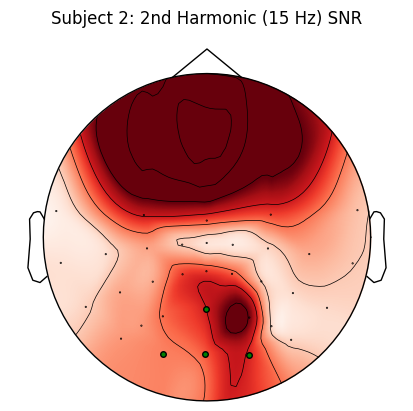

Subject 2: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 6.306372490407136
average SNR (occipital ROI): 10.05722125363354


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- Yes -----------

Stats: t = 2.491, p = 0.042




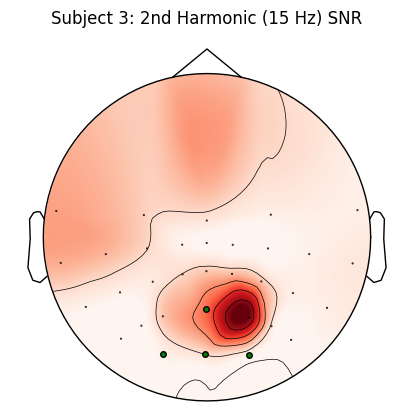

Subject 3: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 2.348235411546241
average SNR (occipital ROI): 2.8945538144672236


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = 1.554, p = 0.164




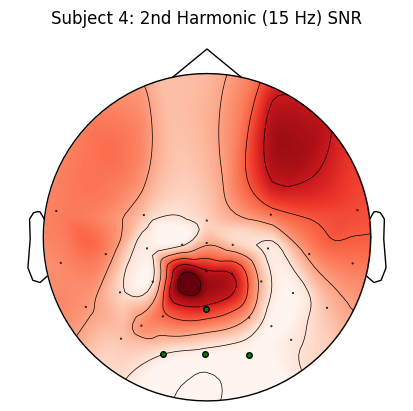

Subject 4: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 3.851378780894865
average SNR (occipital ROI): 2.966900923329163


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = -1.482, p = 0.182




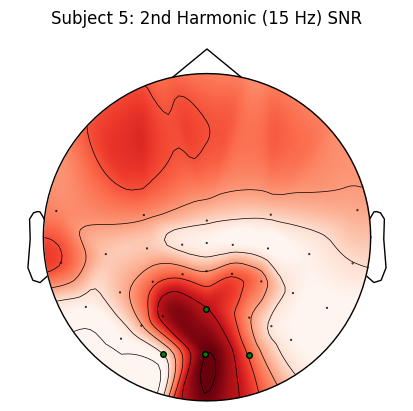

Subject 5: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 4.283349167131394
average SNR (occipital ROI): 8.06029039784135


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = 2.003, p = 0.085




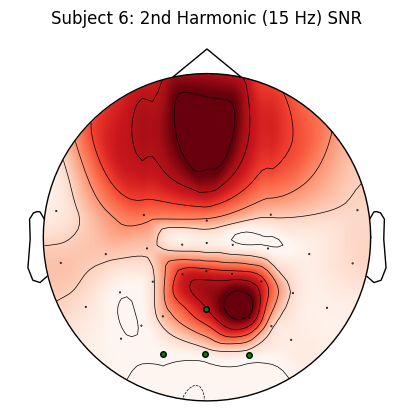

Subject 6: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 7.63960560993492
average SNR (occipital ROI): 7.835756467815614


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = 0.111, p = 0.915




In [25]:
for subj in range(NUM_SUBJ):
      
    # Get average SNR at 5 Hz for ALL channels
    snrs_15hz = all_snrs[subj][:, :, i_bin_15hz]
    snrs_15hz_ch_average = snrs_15hz.mean(axis=0)

    # Plot SNR topography
    fig, ax = plt.subplots(1)
    ax.set_title(f"Subject {subj + 1}: 2nd Harmonic (15 Hz) SNR")
    mne.viz.plot_topomap(snrs_15hz_ch_average, 
                        all_ssvep_epochs[subj].info, 
                        mask = np.array(highlight_ch), 
                        mask_params = mk,
                        vlim=(1, None), 
                        axes=ax,
                        size = 10,
                        sphere=(-0.001, 0.0001, 0.12, 0.2))

    print(f"Subject {subj +1}: SNR at 5 Hz SSVEP stimulation")
    print(f"average SNR (all channels): {snrs_15hz_ch_average.mean()}")
    print(f"average SNR (occipital ROI): {all_snrs_target_h2[subj].mean()}")
    print("\n")

    tstat_roi_vs_scalp = ttest_rel(all_snrs_target_h2[subj].mean(axis=1), snrs_15hz.mean(axis=1))
    print("Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?")

    if(tstat_roi_vs_scalp[1] > 0.05):
        print("\n----------- No ------------\n")
    else:
        print("\n----------- Yes -----------\n")

    print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

# **ICA**
https://mne.tools/mne-icalabel/stable/generated/examples/00_iclabel.html

In [26]:
'''
from mne.preprocessing import ICA
from mne_icalabel import label_components

raw_template = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()
raw_temp = mne.io.RawArray(raw_template, new_info)

copy_raw_data = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()
copy_raw = mne.io.RawArray(copy_raw_data, new_info)
copy_raw.set_montage('standard_1005')
copy_raw.set_eeg_reference("average")
filt_raw = copy_raw.filter(l_freq=1.0, h_freq=100.0)
'''

'\nfrom mne.preprocessing import ICA\nfrom mne_icalabel import label_components\n\nraw_template = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()\nraw_temp = mne.io.RawArray(raw_template, new_info)\n\ncopy_raw_data = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()\ncopy_raw = mne.io.RawArray(copy_raw_data, new_info)\ncopy_raw.set_montage(\'standard_1005\')\ncopy_raw.set_eeg_reference("average")\nfilt_raw = copy_raw.filter(l_freq=1.0, h_freq=100.0)\n'

In [27]:
'''
ica = ICA(
    n_components=33,
    max_iter="auto",
    method="infomax",
    random_state=42,
    fit_params=dict(extended=True),
)

ica.fit(filt_raw)
'''


'\nica = ICA(\n    n_components=33,\n    max_iter="auto",\n    method="infomax",\n    random_state=42,\n    fit_params=dict(extended=True),\n)\n\nica.fit(filt_raw)\n'

In [28]:
'''
ica.plot_components(size = 10,
                    sphere=(0.0011, 0.015, 0.12, 0.2));
'''

'\nica.plot_components(size = 10,\n                    sphere=(0.0011, 0.015, 0.12, 0.2));\n'

In [29]:
'''
ic_labels = label_components(filt_raw, ica, method="iclabel")

# Instead of raw_temp use eeg_smearing to see the effects on this signal that goes further in the pipeline 

for comp in range(10):
    print(f"\n---------------- Component {comp}: {ic_labels['labels'][comp]} ----------------\n")

    ica.plot_properties(eeg_smearing, 
                        picks=[comp], 
                        psd_args = dict(fmin=1, fmax=27),
                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));
    
    ica.plot_overlay(eeg_smearing, 
                     exclude=[comp]);
'''

'\nic_labels = label_components(filt_raw, ica, method="iclabel")\n\n# Instead of raw_temp use eeg_smearing to see the effects on this signal that goes further in the pipeline \n\nfor comp in range(10):\n    print(f"\n---------------- Component {comp}: {ic_labels[\'labels\'][comp]} ----------------\n")\n\n    ica.plot_properties(eeg_smearing, \n                        picks=[comp], \n                        psd_args = dict(fmin=1, fmax=27),\n                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));\n    \n    ica.plot_overlay(eeg_smearing, \n                     exclude=[comp]);\n'

In [30]:
'''
labels = ic_labels["labels"]

exclude_idx = [
    idx for idx, label in enumerate(labels) if label not in ["other",
                                                             "eye blink",
                                                             "brain", 
                                                             "heart beat",
                                                             "line noise"
                                                            ] 
                                                and idx < 10
]

print(f"Excluding these ICA components: {exclude_idx}")

ica.apply(eeg_smearing, exclude=exclude_idx)
'''

'\nlabels = ic_labels["labels"]\n\nexclude_idx = [\n    idx for idx, label in enumerate(labels) if label not in ["other",\n                                                             "eye blink",\n                                                             "brain", \n                                                             "heart beat",\n                                                             "line noise"\n                                                            ] \n                                                and idx < 10\n]\n\nprint(f"Excluding these ICA components: {exclude_idx}")\n\nica.apply(eeg_smearing, exclude=exclude_idx)\n'

# **Segmenting the EEG based on the LDR channel edges**

In [31]:
all_emg_begin_sample = []
all_t_events = []
all_nt_events = []

for subj in range(NUM_SUBJ):

    print(f"========== Subject {subj + 1}: Segmenting Target and Non-Target blocks ==========")

    # -------------------------------------- Targets --------------------------------------
    t_events = []

    for idx, start_sample in enumerate(all_t_rising_edges[subj]):

        t_events.append([start_sample, 0 , 1])
      
    all_t_events.append(t_events)

    # -------------------------------------- Non-Targets -----------------------------------
    nt_events = []

    for idx, start_sample in enumerate(all_nt_rising_edges[subj]):
        time_range1 = (all_nt_falling_edges[subj][idx] - all_nt_rising_edges[subj][idx])/fs

        # Non Target upper range
        if(time_range1 >= 0.17 and time_range1 <= 0.23):

            nt_events.append([start_sample, 0, 0])

        # Non Target lower range
        if(idx < len(nt_falling_edges)-1):
            time_range2 = (all_nt_rising_edges[subj][idx+1] - all_nt_falling_edges[subj][idx])/fs

            if(time_range2 >= 0.17 and time_range2 <= 0.23):

                nt_events.append([np.argmin(np.abs(time_vectors[subj] - all_nt_falling_edges[subj][idx]/fs)), 0, 0])

    all_nt_events.append(nt_events)

    print("Nº Target: ", np.size(t_events, 0))   
    print("Nº Non-Target: ", np.size(nt_events, 0))  
    print("\n") 


========== Subject 1: Segmenting Target and Non-Target blocks ==========
Nº Target:  128
Nº Non-Target:  848


========== Subject 2: Segmenting Target and Non-Target blocks ==========
Nº Target:  128
Nº Non-Target:  838


========== Subject 3: Segmenting Target and Non-Target blocks ==========
Nº Target:  128
Nº Non-Target:  888


========== Subject 4: Segmenting Target and Non-Target blocks ==========
Nº Target:  128
Nº Non-Target:  824


========== Subject 5: Segmenting Target and Non-Target blocks ==========
Nº Target:  128
Nº Non-Target:  858


========== Subject 6: Segmenting Target and Non-Target blocks ==========
Nº Target:  128
Nº Non-Target:  847




In [32]:
preStim_offset = -0.2 # ms
posStim_offset = 0.6 

all_target_eeg_blocks = []
all_nontarget_eeg_blocks = []

for subj in range(NUM_SUBJ):

    print(f"\n================= Subject {subj + 1}: Segmenting EEG =================")

    t_events = all_t_events[subj]
    nt_events = all_nt_events[subj]

    # Events only require the sample where the trials start. mne.Epochs with t_min accounts for the desired offset based on the sample where a trial begins
    events = np.vstack((t_events,
                        nt_events))
    
    events_id = dict(nontarget=0, 
                     target=1)

    sorted_events = events[events[:, 0].argsort()]  # Sort by first column (index 0)

    custom_epochs = mne.Epochs( rereferenced_EEGs[subj],
                                sorted_events, 
                                event_id = events_id, 
                                tmin = preStim_offset, 
                                tmax = posStim_offset, 
                                baseline = None, 
                                event_repeated = 'error',
                                preload = True)

    target_eeg_blocks = custom_epochs["target"].get_data(copy = True)
    nontarget_eeg_blocks = custom_epochs["nontarget"].get_data(copy = True)

    all_target_eeg_blocks.append(target_eeg_blocks)
    all_nontarget_eeg_blocks.append(nontarget_eeg_blocks)


================= Subject 1: Segmenting EEG =================
Not setting metadata
976 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 976 events and 1640 original time points ...
0 bad epochs dropped

================= Subject 2: Segmenting EEG =================
Not setting metadata
966 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 966 events and 1640 original time points ...
0 bad epochs dropped

================= Subject 3: Segmenting EEG =================
Not setting metadata
1016 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1016 events and 1640 original time points ...
0 bad epochs dropped

================= Subject 4: Segmenting EEG =================
Not setting metadata
952 matching events found
No baseline correction applied
0 projection items activated
Using data from pr

Removing the 6 ICA label (with the rest line noise and muscle artifacts), probably containing the SSVEP component and its harmonics did in fact improve the issue with the SNR over the occipital region by reducing the SNR in this region in comparison to the average SNR in the rest of the channels. However, the ERPs suffered with it and the 15 Hz noise did not disappear (weird oscillation on the P3). The n2pc did in fact appear to improve with no effect on N2pcb. Some classification did improve but the x and y estimation suffered.

-----------------------------------------------------

SNR overall:

* Average SNR (occipital ROI) (5hz): 1.5238053671052734

* Average SNR (occipital ROI) (10hz): 0.5730331911747106

* Average SNR (occipital ROI) (15Hz): 0.953175827740842

- SSVEP frequency t test: t = -0.302, p = 0.768

- Harmonic 10 Hz t test: t = 0.377, p = 0.712

- Harmonic 15 Hz t test: t = 0.745, p = 0.470


--------

Without the 6 ICA comp (the other components were removed) the SNR was lightly reduced but the SNR over the occipital region remained very similar, meaning that the 10Hz harmonic over this region still remained statistically different

SNR overall:

* Average SNR (occipital ROI) (5Hz): 2.6011588592632156

* Average SNR (occipital ROI) (10Hz): 1.2433214279200635

* Average SNR (occipital ROI) (15Hz): 1.0491748678033437

- SSVEP frequency t test: t = 0.883, p = 0.393

- Harmonic 10 Hz t test: t = 2.216, p = 0.045

- Harmonic 15 Hz t test: t = 0.868, p = 0.401

--------

To see this ICA component use the whole signal to fit and nost just from the EOG recording: copy_raw_data = raw_eeg.copy().pick(eeg_ch_idx).get_data()

Also, to see better the effects of ICA on the Eye blinks use raw_temp EEG.

    ica.plot_properties(raw_temp, 
                        picks=[comp], 
                        psd_args = dict(fmin=1, fmax=27),
                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));
    
    ica.plot_overlay(raw_temp, 
                     exclude=[comp]);

## xDawn

In [33]:
'''
from mne.viz import plot_epochs_image
plot_epochs_image(custom_epochs["target"], picks=15, vmin=-10, vmax=10);
'''

'\nfrom mne.viz import plot_epochs_image\nplot_epochs_image(custom_epochs["target"], picks=15, vmin=-10, vmax=10);\n'

In [34]:
'''
from mne import compute_raw_covariance
from mne.preprocessing import Xdawn

signal_cov = compute_raw_covariance(eeg_smearing, picks = clean_ch)

xdawn = Xdawn(n_components=2, signal_cov = signal_cov)
xdawn.fit(custom_epochs[0:600])

epochs_denoised = xdawn.apply(custom_epochs)

# Plot image epoch after Xdawn
plot_epochs_image(epochs_denoised, picks = 15, vmin=-500, vmax=500)
'''


'\nfrom mne import compute_raw_covariance\nfrom mne.preprocessing import Xdawn\n\nsignal_cov = compute_raw_covariance(eeg_smearing, picks = clean_ch)\n\nxdawn = Xdawn(n_components=2, signal_cov = signal_cov)\nxdawn.fit(custom_epochs[0:600])\n\nepochs_denoised = xdawn.apply(custom_epochs)\n\n# Plot image epoch after Xdawn\nplot_epochs_image(epochs_denoised, picks = 15, vmin=-500, vmax=500)\n'

## Baseline correction

In [35]:

ERP_times = np.arange(preStim_offset, posStim_offset+1/fs, 1/fs )
t_zero = np.argmin(np.abs(ERP_times - 0))

all_baseline_corr_targets = []
all_baseline_corr_nontargets = []

for subj in range(NUM_SUBJ):

    if (BASELN_CORR):

        print(f"Subject {subj + 1}: Baseline Correcting Epochs")

        baseline_corr_targets = np.zeros((np.shape(all_target_eeg_blocks[subj])))
        baseline_corr_nontargets = np.zeros((np.shape(all_nontarget_eeg_blocks[subj])))

        # Target
        for count, trial in enumerate(all_target_eeg_blocks[subj]):
            for c in range(len(eeg_ch_idx)):
                baseline = np.mean(trial[c][:t_zero])
                baseline_corr_targets[count][c] = trial[c] - baseline

        # Non Target
        for count, trial in enumerate(all_nontarget_eeg_blocks[subj]):
            for c in range(len(eeg_ch_idx)):
                baseline = np.mean(trial[c][:t_zero])
                baseline_corr_nontargets[count][c] = trial[c] - baseline

        all_baseline_corr_targets.append(baseline_corr_targets)
        all_baseline_corr_nontargets.append(baseline_corr_nontargets)

    else:

        all_baseline_corr_targets.append(all_target_eeg_blocks[subj])
        all_baseline_corr_nontargets.append(all_nontarget_eeg_blocks[subj])

Subject 1: Baseline Correcting Epochs
Subject 2: Baseline Correcting Epochs
Subject 3: Baseline Correcting Epochs
Subject 4: Baseline Correcting Epochs
Subject 5: Baseline Correcting Epochs
Subject 6: Baseline Correcting Epochs


# **Topoplot map of the EEG electrodes**

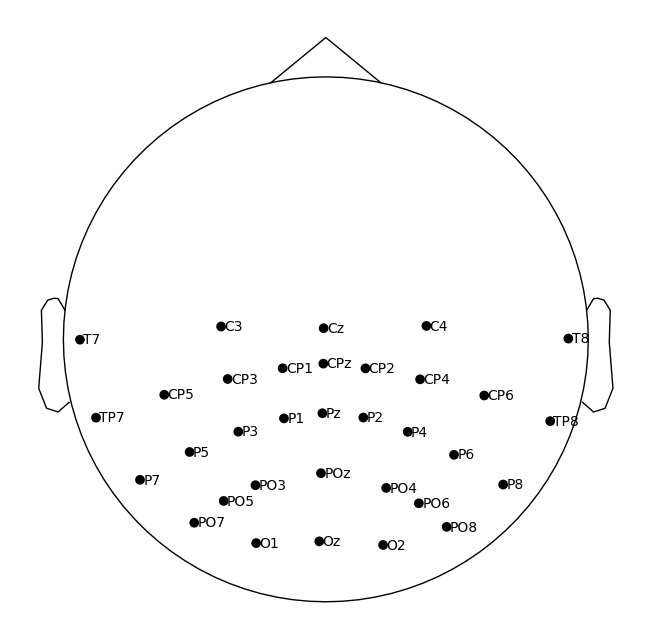

In [36]:
rereferenced_EEGs[subj].plot_sensors(show_names=True,
                                        sphere=(0.0011, 0.015, 0.12, 0.2),
                                        title = "Electrode Distribution");

# **ERP Analysis**

## Computing and plotting the Grand Average ERPs: P3 (300 - 500 ms)

In [37]:
P3_channels = [" Cz", " CPz", " Pz", " CP1", " CP2"]

P3_ch_idx = pick_channels(ch, P3_channels)

all_target_ERPs = []
all_nontarget_ERPs = []

for subj in range(NUM_SUBJ):

    target_ERP = np.mean(all_baseline_corr_targets[subj], axis = 0) # Averaging over the trials dimension
    nontarget_ERP = np.mean(all_baseline_corr_nontargets[subj], axis = 0)

    all_target_ERPs.append(target_ERP)
    all_nontarget_ERPs.append(nontarget_ERP)

grandAver_targetERP = np.mean(all_target_ERPs, axis = 0)
grandAver_nontargetERP = np.mean(all_nontarget_ERPs, axis = 0)

std_targetERP = np.std(all_target_ERPs, axis = 0)
std_nontargetERP = np.std(all_nontarget_ERPs, axis = 0)


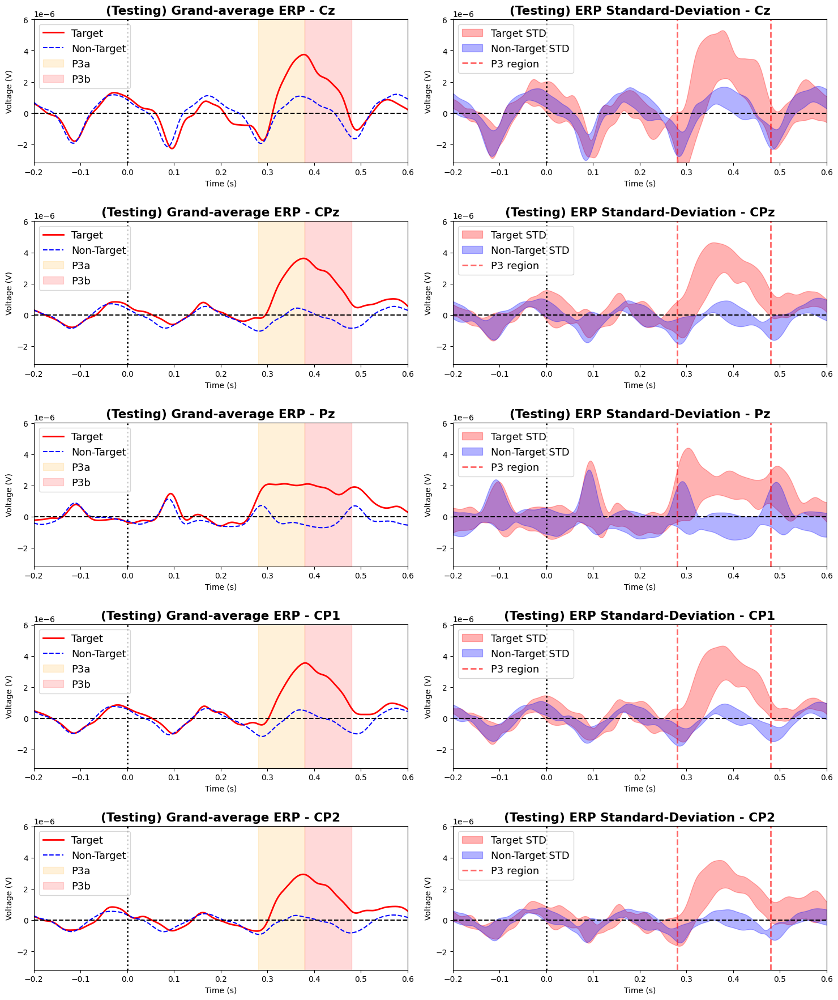

In [38]:
import matplotlib.patches as patches

up_vlim = np.max(grandAver_targetERP[P3_ch_idx,:]) + np.max(std_targetERP[P3_ch_idx,:]/1.2)
do_vlim = np.min(grandAver_targetERP[P3_ch_idx,:]) - np.max(std_targetERP[P3_ch_idx,:]/3)

fig, ax = plt.subplots(nrows = len(P3_ch_idx), 
                                   ncols = 2,
                                   figsize=(15, 18))
plt.rcParams['font.size'] = 13

for count, c in enumerate(P3_ch_idx):
    

    ax[count,0].plot(ERP_times, 
             grandAver_targetERP[c], 
             color = 'red', 
             label = 'Target',  
             linewidth = 2);
    
    ax[count,0].plot(ERP_times, 
             grandAver_nontargetERP[c], 
             'b--', 
             label = 'Non-Target');
    
    ax[count,0].set_title(f"(Testing) Grand-average ERP - {clean_ch[c]}", weight = 'bold')
    ax[count,0].set_xlabel("Time (s)")
    ax[count,0].set_ylabel("Voltage (V)")
    ax[count,0].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
    ax[count,0].axhline(y = 0, linestyle = '--', color = 'black')
    ax[count,0].set_xlim([preStim_offset,posStim_offset])
    ax[count,0].set_ylim([do_vlim, up_vlim])

    if c in P3_ch_idx:
        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.28, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax[count,0].add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.38, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax[count,0].add_patch(P3b_region)
        
    ax[count,0].legend(loc='upper left')


    # Plot shaded areas on the second subplot (ax2)
    ax[count,1].fill_between(ERP_times,
                    grandAver_targetERP[c] + std_targetERP[c],
                    grandAver_targetERP[c] - std_targetERP[c],
                    color='r',
                    alpha=0.3,
                    label = "Target STD")
    
    ax[count,1].fill_between(ERP_times,
                    grandAver_nontargetERP[c] + std_nontargetERP[c],
                    grandAver_nontargetERP[c] - std_nontargetERP[c],
                    color='b',
                    alpha=0.3,
                    label = "Non-Target STD")
    
    ax[count,1].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
    ax[count,1].axhline(y = 0, linestyle = '--', color = 'black')
    
    ax[count,1].set_title(f"(Testing) ERP Standard-Deviation - {clean_ch[c]}", weight = 'bold')
    ax[count,1].set_xlabel("Time (s)") 
    ax[count,1].set_ylabel("Voltage (V)")
    ax[count,1].set_xlim([preStim_offset, posStim_offset])
    ax[count,1].set_ylim([do_vlim, up_vlim])

    ax[count,1].axvline(x = 0.28, linewidth = 2, linestyle = '--', color = 'red', label = "P3 region",alpha = 0.6)
    ax[count,1].axvline(x = 0.48, linewidth = 2, linestyle = '--', color = 'red', alpha = 0.6)

    ax[count,1].legend(loc='upper left')

fig.tight_layout()
plt.show()

## Target vs Non-target Topomaps

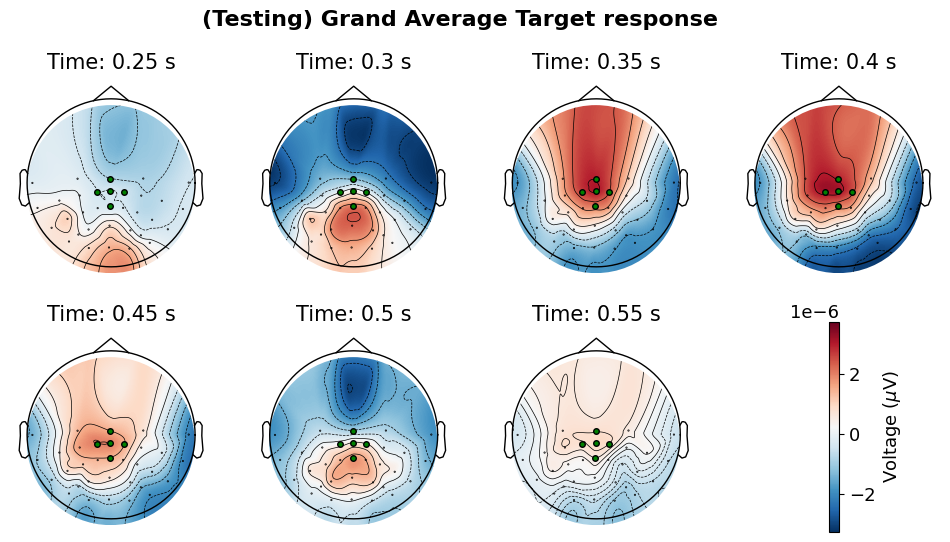

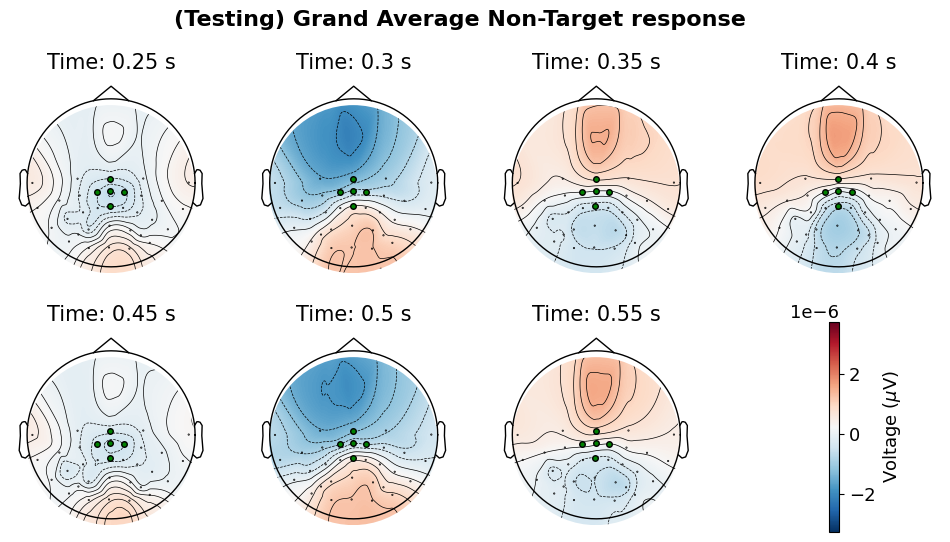

In [39]:
t_win = 0.01  # 10 ms

t_intervals = [0.25, 
               0.3, 
               0.35, 
               0.4, 
               0.45, 
               0.5, 
               0.55,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

up_vlim = np.max(grandAver_targetERP)
do_vlim = np.min(grandAver_targetERP)

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(12, 6))

fig.suptitle("(Testing) Grand Average Target response", fontweight='bold', fontsize=16)

mk = dict(marker='o', 
          markerfacecolor='g', 
          markeredgecolor='k',
          linewidth=0, 
          markersize=4)

highlight_ch = [1 if c in P3_ch_idx else 0 for c in range(len(clean_ch))]

# ------------------------------------------------------------------------------ Target ------------------------------------------------------------------------------

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(grandAver_targetERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[subj].info,
                                      contours = 10,
                                      vlim = (do_vlim, up_vlim),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.show()


# ------------------------------------------------------------------------------ Non-Target ------------------------------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(12, 6))

fig.suptitle("(Testing) Grand Average Non-Target response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(grandAver_nontargetERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[subj].info,
                                      contours = 10,
                                      vlim = (do_vlim, up_vlim),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.show()

## Target vs Non-target classification (P3)

### Concatenating feature vector

In [40]:
from scipy.signal import resample

In [41]:
# Isolating the datapoints related to the N2pc time window 

n_trials = np.size(all_baseline_corr_targets, 1)

ts = 0.28
te = 0.48

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

all_featVect_Target = []
all_featVect_NonTarget = []

for subj in range(NUM_SUBJ):

    print(f"\nSubject {subj + 1}: P3 Feature vector")

    featVect_Target = [] # Class label = 1
    featVect_NonTarget = [] # Class label = 0

    for trial in range(n_trials):

        targets = resample(all_baseline_corr_targets[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        nontargets = resample(all_baseline_corr_nontargets[subj][trial*4][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for id in range(1, len(P3_ch_idx)):
            
            c = P3_ch_idx[id]

            if (id == 1):
                auxT = np.hstack((targets[P3_ch_idx[id - 1],:],targets[c,:]))
                auxNT = np.hstack((nontargets[P3_ch_idx[id - 1],:],nontargets[c,:]))
            else:
                auxT = np.hstack((auxT,targets[c,:]))
                auxNT = np.hstack((auxNT,nontargets[c,:]))
        
        featVect_Target.append(np.hstack((auxT, 1)))
        featVect_NonTarget.append(np.hstack((auxNT, 0)))

    print(np.shape(featVect_Target))
    print(np.shape(featVect_NonTarget))

    all_featVect_Target.append(featVect_Target)
    all_featVect_NonTarget.append(featVect_NonTarget)

    


Subject 1: P3 Feature vector
(128, 71)
(128, 71)

Subject 2: P3 Feature vector
(128, 71)
(128, 71)

Subject 3: P3 Feature vector
(128, 71)
(128, 71)

Subject 4: P3 Feature vector
(128, 71)
(128, 71)

Subject 5: P3 Feature vector
(128, 71)
(128, 71)

Subject 6: P3 Feature vector
(128, 71)
(128, 71)


### Train/Validation Split

In [42]:
import random

all_test_featVect = []
all_ordered_test_featVect = []

for subj in range(NUM_SUBJ):

    test_featVect = np.vstack((all_featVect_Target[subj], all_featVect_NonTarget[subj]))
    ordered_test_featVect = test_featVect

    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_test_featVect.append(test_featVect)
    all_ordered_test_featVect.append(ordered_test_featVect)

### Row-wise normalization of the feature vector

In [43]:
# Feature wise normalization of feature vector

all_norm_test_featVect = []
all_o_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []
        o_norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

            o_mean = np.mean(all_ordered_test_featVect[subj][u,0:-1])
            o_std = np.std(all_ordered_test_featVect[subj][u,0:-1])
            o_norm_test_featVect.append(np.hstack(((all_ordered_test_featVect[subj][u,0:-1] - o_mean) / o_std, all_ordered_test_featVect[subj][u, -1])))

        test_featVect = np.array(norm_test_featVect)
        o_test_featVect = np.array(o_norm_test_featVect)

    else:

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_test_featVect.append(test_featVect)
    all_o_norm_test_featVect.append(o_test_featVect)

### Classification

In [41]:
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix

ROC:

True positive rate = Sensitivity = y axis (ROC) = True Positives/(True Positives + False Negatives) = Proportion of Targets that were correctly classified

False Positve rate = Specificity = x axis (ROC) (1-Specificity) = False Positives/(False Positives + True Negatives) = Proportion of non Target samples that were incorrectly classified

Precision = True Positives/(True Positives + False Positives) = Porportion of results that were correclty classified

**The ROC graph summarizes all of the confusion matrices that each threshold produced**

In [42]:
import joblib

In [233]:

_, P3_models = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_P3/", [".pkl"])

subj_P3_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(P3_models[subj])
    subj_P3_models.append(m)

### Cross-Validation Training Classification differences between different classifiers

### Best classifier Cross-Validation Training accuracies for all subjects

In [234]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_P3_models[subj].predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = subj_P3_models[subj].predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)


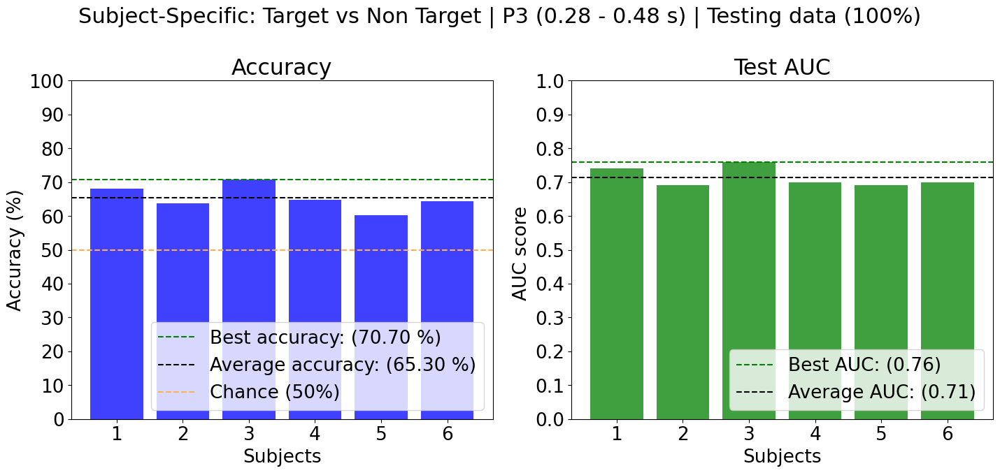

In [231]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Specific: Target vs Non Target | P3 ({ts} - {te} s) | Testing data (100%)', fontsize=22)


# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Test Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step=0.10), 
          ylabel='AUC score ',
          title="Test AUC");

ax[1].legend(loc='lower right');


plt.rcParams.update({'font.size': 19})
plt.tight_layout()




In [235]:
perSubj_specificity # Interpretation: High specificity means the model is good at identifying all the negative cases. It's important in scenarios where false positives are particularly costly or problematic.

[0.7109375, 0.609375, 0.65625, 0.625, 0.546875, 0.6484375]

In [236]:
perSubj_sensitivity # Interpretation: High sensitivity means the model is good at identifying all the positive cases. It's particularly important in scenarios where missing a positive case is critical (e.g., medical diagnoses).

[0.6484375, 0.6640625, 0.7578125, 0.671875, 0.65625, 0.640625]

In [237]:
NUM_BLOCKS = 8

trial_range = int(n_entries/NUM_BLOCKS)

perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_P3_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, 0:-1]), 
                                                                                   all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

#### Measuring predcting performance over trial blocks

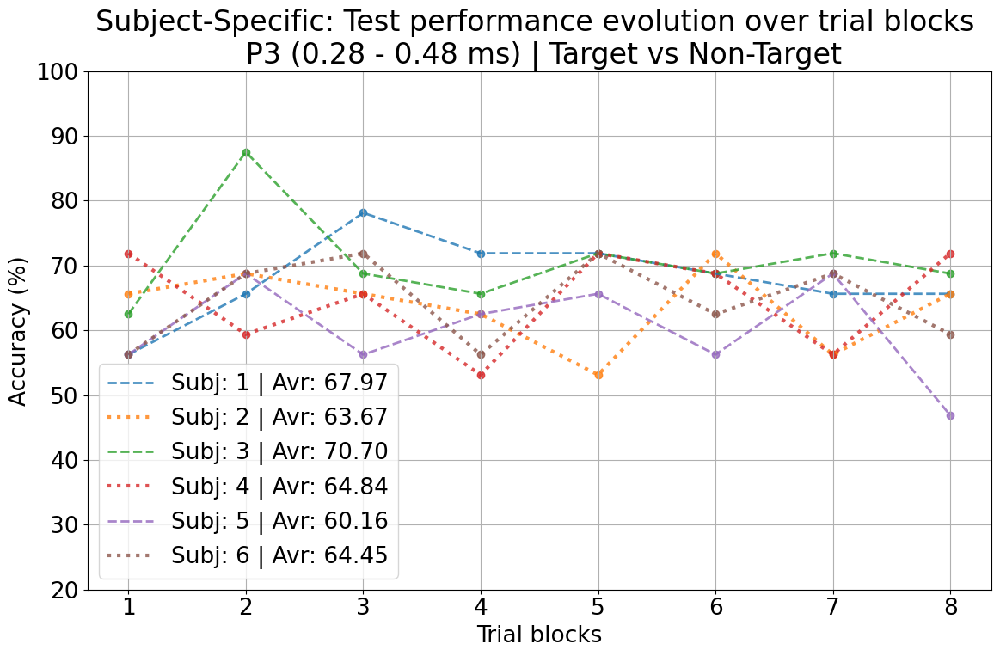

In [238]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f}", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n P3 ({ts} - {te} ms) | Target vs Non-Target", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(20, 101,10))
plt.legend()
plt.tight_layout()
plt.grid()
plt.show()

#### P3 AGI

In [47]:
_, P3_models = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_Target_vs_NonTarget_P3/", [".pkl"])

GEN_P3_models = joblib.load(P3_models[0])

perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = GEN_P3_models.predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = GEN_P3_models.predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

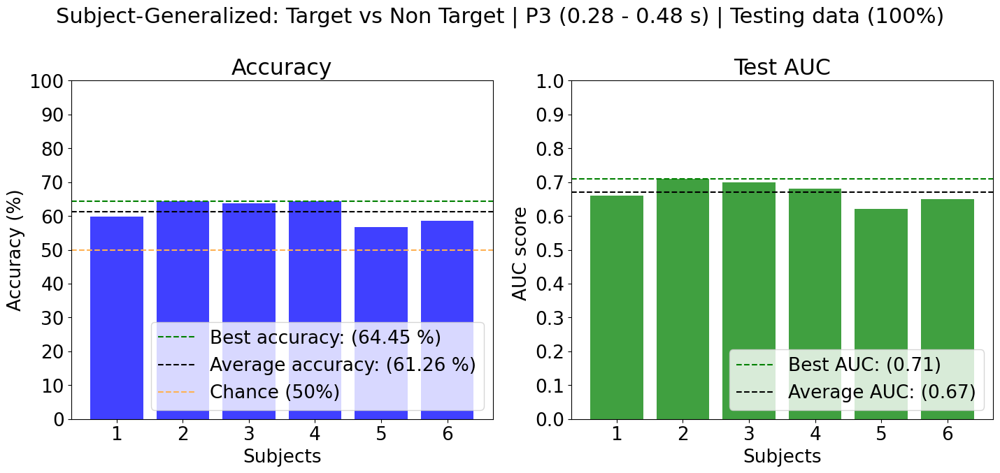

In [49]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Generalized: Target vs Non Target | P3 ({ts} - {te} s) | Testing data (100%)', fontsize=22)


# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Test Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step=0.10), 
          ylabel='AUC score ',
          title="Test AUC");

ax[1].legend(loc='lower right');


plt.rcParams.update({'font.size': 19})
plt.tight_layout()


In [50]:
perSubj_sensitivity

[0.640625, 0.59375, 0.796875, 0.546875, 0.5703125, 0.515625]

In [51]:
perSubj_specificity

[0.5546875, 0.6953125, 0.4765625, 0.7421875, 0.5625, 0.65625]

# **Mapping targets to object location**

------
Paths:

C:/Users/VascoRocha(1161216)/Desktop/Rocha/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files/

C:/Users/migue/OneDrive/Ambiente de Trabalho/Tese/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files/EEG_Sara_001

In [39]:
import natsort

trial_order_folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Stim_Order_Files/Stim_Order_Files_Test"
subfolders, _ = run_fast_scandir(trial_order_folder, [".xlsx"])

all_trial_files = []

for trials_subfolder in subfolders:

    if "Old data" not in trials_subfolder:

        _, trial_files = run_fast_scandir(trials_subfolder, [".xlsx"])

        sort_trialfiles = natsort.natsorted(trial_files)

        all_trial_files.append(sort_trialfiles)

In [40]:
np.shape(all_baseline_corr_targets)

(6, 128, 33, 1640)

In [41]:
import pandas as pd

all_centroid_mapped_targets = []
all_images = []

CLASS_COL = 2
IM_PATH_COL = 1

for subj in range(NUM_SUBJ):

    centroid_mapped_targets = []
    centroids = []
    images = []

    count = 0

    for file in all_trial_files[subj]:
        
        sheet = pd.read_excel(file)
        
        for row in sheet.values:
            if row[CLASS_COL] == "Target":
                centroid_mapped_targets.append([all_baseline_corr_targets[subj][count], row[-1]]) # Mapping rows || Field one comprises the data | Field two comprises the object centroid 
                centroids.append(row[-1])
                images.append(row[IM_PATH_COL]) # row[0] = trial iterator
                count = count + 1

    all_centroid_mapped_targets.append(centroid_mapped_targets)
    all_images.append(images)

## Distribution of target centroids

In [42]:
centroids = np.unique(centroids)

# Remove unnecessary characters and split by comma
cleaned_string = [centr[2:-2].split(",") for centr in centroids]  # Removes [' and '] and splits at ','

x_centroid = [int(s[0].split("=")[1]) for s in cleaned_string]
y_centroid = [int(s[1].split("=")[1]) for s in cleaned_string]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


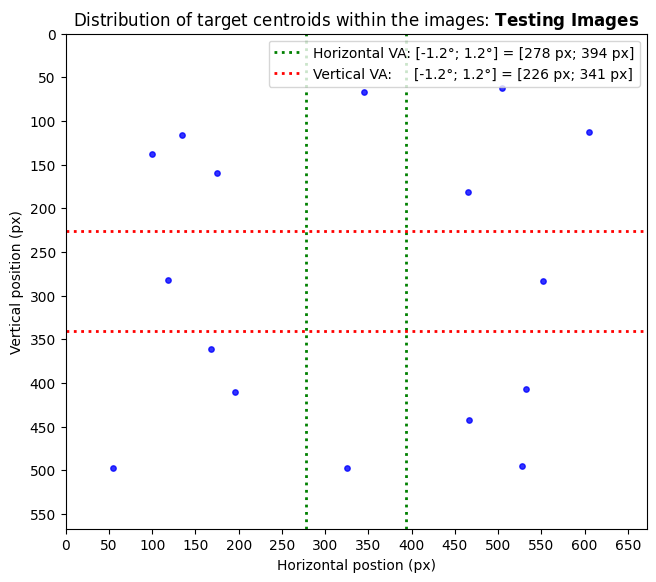

In [43]:
H_th = 1.2 # Degrees
V_th = 1.2

width = 672
height = 567

figure(figsize = (7.5, 6.428))
plt.rcdefaults()

plt.title(r"Distribution of target centroids within the images: $\bf{Testing \ Images}$")
plt.scatter(x_centroid, y_centroid, color = 'b', s = 15, alpha = 0.8);

plt.xlabel("Horizontal postion (px)")
plt.ylabel("Vertical position (px)")
plt.legend(loc = "best");

plt.axvline(x = 278, color = 'g', linestyle = ':', linewidth = 2, label = f"Horizontal VA: [{-H_th}°; {H_th}°] = [278 px; 394 px]")
plt.axvline(x = 394, color = 'g', linestyle = ':', linewidth = 2)

plt.axhline(y = 226, color = 'r', linestyle = ':', linewidth = 2, label = f"Vertical VA:     [{-V_th}°; {V_th}°] = [226 px; 341 px]")
plt.axhline(y = 341, color = 'r', linestyle = ':', linewidth = 2)

plt.xlim([0, width]);
plt.ylim([height, 0])

plt.xticks(np.arange(0, width, 50))
plt.yticks(np.arange(0, height, 50))

plt.legend()
plt.show()

## Visual angle calculation

In [44]:
SCREEN_WIDTH_PX = 1920
SCREEN_HEIGHT_PX = 1080

SCREEN_DIAGONAL_SIZE_INCH = 27

def visual_angle(object_x_px, object_y_px, H_image_width_px, V_image_width_px, screen_width_px, screen_height_px):
    
    # https://www.reddit.com/r/oculus/comments/1dmcsh/default_eye_to_screen_distance/ corresponds to measurement
    #observer_distance_mm = 40 # in mm for the HMD (Oculus Rift)
    OBSERVER_DISTANCE_MM = 1000 # in mm for the C1 computer

    # Width and Height of the screen in mm
    SCREEN_WIDTH_MM = 699
    SCREEN_HEIGHT_MM = 395
 
    # Convert the size of the image in pixels to mm
    H_image_width_mm = (SCREEN_WIDTH_MM * H_image_width_px)/screen_width_px
    V_image_width_mm = (SCREEN_HEIGHT_MM * V_image_width_px)/screen_height_px

    # Visual angle of the image
    H_image_width_deg = np.degrees(2 * (np.arctan(H_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))
    V_image_width_deg = np.degrees(2 * (np.arctan(V_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))

    # How many degrees in the visual field represents one pixel in the images
    H_visual_angle_per_px = H_image_width_deg / H_image_width_px 
    V_visual_angle_per_px = V_image_width_deg / V_image_width_px

    H_object_x_deg = (object_x_px - (H_image_width_px / 2)) * H_visual_angle_per_px
    V_object_y_deg = (object_y_px - (V_image_width_px / 2)) * V_visual_angle_per_px

    return H_object_x_deg, V_object_y_deg

In [45]:
x,y=visual_angle(1344/2, 1134/2, 1344/2, 1134/2, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)
print(x,y)

6.974058729692531 5.91970218693015


In [46]:
# This is for the PsycgoPy -> trial -> trialImage -> Layout -> Size[w,h] $
wPx = 1344
hPx = 1134

print(f"Size [{round(wPx * 0.5 / hPx, 3)}, 0.5]") # This mantains the proportion of width and height in the scalling done in PsychoPy

wPx = wPx * 0.5 # px
hPx = hPx * 0.5 # px

# Now we have to define how to devide the visual field for the VR headset
# In the original study had a width of 11.5 x 11.8 degrees and 640 x 640 in pixels. 
# Also, a threshold of +/- 1.2 degrees to classify the images for the LVF and RVF 

#observer_distance_mm = 40
OBSERVER_DISTANCE_MM = 1000

# Inches to mm the screen size
screen_diagonal_size_mm = SCREEN_DIAGONAL_SIZE_INCH * 25.4 

# Angle of the diagonal of the screen
width_height_angle = np.arctan(SCREEN_HEIGHT_PX/SCREEN_WIDTH_PX) # C_oposed/C_adjacent

# Width and Height of the screen in mm
screen_width_mm = 696
screen_height_mm = 395

# Convert the size of the image in pixels to mm
H_image_width_mm = (screen_width_mm * wPx)/SCREEN_WIDTH_PX
V_image_width_mm = (screen_height_mm * hPx)/SCREEN_HEIGHT_PX

# Visual angle of the image
H_image_width_deg = np.degrees(2 * (np.arctan(H_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))
V_image_width_deg = np.degrees(2 * (np.arctan(V_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))

print("\nWidth of the image in degrees: ", round(H_image_width_deg,3))
print("Height of the image in degrees: ", round(V_image_width_deg,3))

# Paper on Eccentricity of the target stimuli and the N2pc performance: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7160023/pdf/nihms-1065363.pdf 

Size [0.593, 0.5]

Width of the image in degrees:  13.889
Height of the image in degrees:  11.839


## Labelling targets according to the centroid location

In [47]:
import re

H_th = 1.2 # Degrees
V_th = 1.2

PYSCHOPY_RESCALLING = 0.5

IM_WIDTH = 1344 * PYSCHOPY_RESCALLING
IM_HEIGHT = 1134 * PYSCHOPY_RESCALLING

all_labelled_targets = []

for subj in range(NUM_SUBJ):

    labelled_targets = []

    for count, (target_EEG, centroid_str) in enumerate(all_centroid_mapped_targets[subj]):

        # Remove unnecessary characters and split by comma
        cleaned_string = centroid_str[2:-2].split(",")  # Removes [' and '] and splits at ','
        # Extract integers after '=' sign
        centroid = [int(s.split("=")[1]) for s in cleaned_string]

        x_VA, y_VA = visual_angle(centroid[0], centroid[1], IM_WIDTH, IM_HEIGHT, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)

        if (x_VA > H_th):
            x_stim_type = "RVF"
        elif (x_VA < -H_th):
            x_stim_type = "LVF"
        else:
            x_stim_type = "CVF"

        if(y_VA < -V_th):
            y_stim_type = "TVF"
        elif (y_VA > V_th):
            y_stim_type = "BVF"
        else:
            y_stim_type = "CVF"

        labelled_targets.append([target_EEG, centroid[0], centroid[1], x_VA, y_VA, x_stim_type, y_stim_type])

    all_labelled_targets.append(labelled_targets)
           

# **Averaging Contralateral - Ipsilateral component: N2pc (200 - 400 ms)**

## Separating and concatenating classes

In [48]:
left_N2pc_channels = [" P7", " PO7", " PO3", " PO5", " P3", " P5", " O1"]
right_N2pc_channels = [" P8", " PO8", " PO4", " PO6", " P4", " P6", " O2"]

left_N2pc_ch_idx = pick_channels(ch, left_N2pc_channels)
right_N2pc_ch_idx = pick_channels(ch, right_N2pc_channels)

HORIZONTAL_CONDITION_COL = 5
HORIZONTAL_VA_COL = 3
X_CENTROID_COL = 1
DATA_COL = 0

VERTICAL_CONDITION_COL = 6
VERTICAL_VA_COL = 4
Y_CENTROID_COL = 2

In [49]:
all_RVF_contralateral = []
all_RVF_ipsilateral = []
all_LVF_contralateral = []
all_LVF_ipsilateral = []

all_RVF_target = []
all_LVF_target = []

all_RVF_x_pos = []
all_LVF_x_pos = []

all_RVF_y_pos = []
all_LVF_y_pos = []

for subj in range(NUM_SUBJ):

    RVF_contralateral = []
    RVF_ipsilateral = []
    LVF_contralateral = []
    LVF_ipsilateral = []

    RVF_target = []
    LVF_target = []

    RVF_x_pos = []
    LVF_x_pos = []

    RVF_y_pos = []
    LVF_y_pos = []

    for trial in all_labelled_targets[subj]:
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF"):
            RVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_x_pos.append(trial[X_CENTROID_COL])
            RVF_y_pos.append(trial[Y_CENTROID_COL])

            RVF_target.append(trial[DATA_COL])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF"):
            LVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_x_pos.append(trial[X_CENTROID_COL])
            LVF_y_pos.append(trial[Y_CENTROID_COL])

            LVF_target.append(trial[DATA_COL])

    all_RVF_contralateral.append(RVF_contralateral)
    all_RVF_ipsilateral.append(RVF_ipsilateral)

    all_RVF_target.append(RVF_target)

    all_RVF_x_pos.append(RVF_x_pos)
    all_RVF_y_pos.append(RVF_y_pos)

    all_LVF_contralateral.append(LVF_contralateral)
    all_LVF_ipsilateral.append(LVF_ipsilateral)

    all_LVF_target.append(LVF_target)

    all_LVF_x_pos.append(LVF_x_pos)
    all_LVF_y_pos.append(LVF_y_pos)

In [50]:
print("RVF Contralateral trial number:", np.shape(RVF_contralateral))
print("RVF Ipsilateral trial number:", np.shape(RVF_ipsilateral))
print("LVF Contralateral trial number:", np.shape(LVF_contralateral))
print("LVF Ipsilateral trial number:", np.shape(LVF_ipsilateral))

RVF Contralateral trial number: (56, 7, 1640)
RVF Ipsilateral trial number: (56, 7, 1640)
LVF Contralateral trial number: (56, 7, 1640)
LVF Ipsilateral trial number: (56, 7, 1640)


## Grand-Average

In [51]:
all_RVF_aver_contralateral = []
all_RVF_aver_ipsilateral = []
all_LVF_aver_contralateral = []
all_LVF_aver_ipsilateral = []

all_aver_cont = []
all_aver_ipsi = []

for subj in range(NUM_SUBJ):

    RVF_aver_contralateral = np.mean(all_RVF_contralateral[subj], axis = 0)
    RVF_aver_ipsilateral = np.mean(all_RVF_ipsilateral[subj], axis = 0)
    LVF_aver_contralateral = np.mean(all_LVF_contralateral[subj], axis = 0)
    LVF_aver_ipsilateral = np.mean(all_LVF_ipsilateral[subj], axis = 0)

    aver_cont = (RVF_aver_contralateral + LVF_aver_contralateral)/2
    aver_ipsi = (RVF_aver_ipsilateral + LVF_aver_ipsilateral)/2


    all_RVF_aver_contralateral.append(RVF_aver_contralateral)
    all_RVF_aver_ipsilateral.append(RVF_aver_ipsilateral)
    all_LVF_aver_contralateral.append(LVF_aver_contralateral)
    all_LVF_aver_ipsilateral.append(LVF_aver_ipsilateral)

    all_aver_cont.append(aver_cont)
    all_aver_ipsi.append(aver_ipsi)

RVF_aver_contralateral = np.mean(all_RVF_aver_contralateral, axis = 0)
RVF_aver_ipsilateral = np.mean(all_RVF_aver_ipsilateral, axis = 0)
LVF_aver_contralateral = np.mean(all_LVF_aver_contralateral, axis = 0)
LVF_aver_ipsilateral = np.mean(all_LVF_aver_ipsilateral, axis = 0)

RVF_std_contralateral = np.std(all_RVF_aver_contralateral, axis = 0)
RVF_std_ipsilateral = np.std(all_RVF_aver_ipsilateral, axis = 0)
LVF_std_contralateral = np.std(all_LVF_aver_contralateral, axis = 0)
LVF_std_ipsilateral = np.std(all_LVF_aver_ipsilateral, axis = 0)

RVF_N2pc_std = np.std(RVF_aver_contralateral - RVF_aver_ipsilateral, axis = 0)
LVF_N2pc_std = np.std(LVF_aver_contralateral - LVF_aver_ipsilateral, axis = 0)

aver_cont = np.mean(all_aver_cont, axis = 0)
aver_ipsi = np.mean(all_aver_ipsi, axis = 0)

std_cont = np.std(all_aver_cont, axis = 0)
std_ipsi = np.std(all_aver_ipsi, axis = 0)
N2pc_std = np.std(np.array(all_aver_cont) - np.array(all_aver_ipsi), axis = 0)

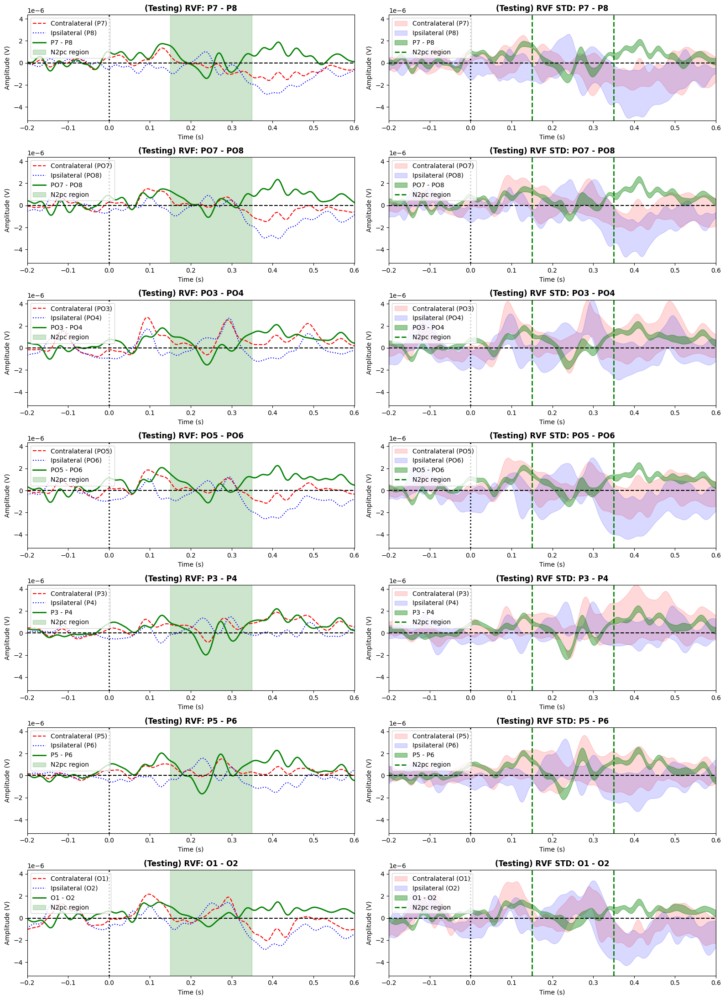

In [53]:
up_vlim = np.max(LVF_aver_ipsilateral) + np.max(LVF_std_ipsilateral) * 0.8
do_vlim = np.min(LVF_aver_ipsilateral) - np.max(LVF_std_ipsilateral)

fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 2,
                                figsize=(16, 22))

for i in range(len(left_N2pc_ch_idx)):

    N2pc = RVF_aver_contralateral[i] - RVF_aver_ipsilateral[i]

    ax[i,0].plot(ERP_times, 
                       RVF_aver_contralateral[i],
                       'r--', 
                       label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       RVF_aver_ipsilateral[i],
                       'b:', 
                       label = f"Ipsilateral ({clean_ch[right_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       N2pc,
                       'g', 
                       label = f"{clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", linewidth = 2)

    ax[i,0].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,0].set_ylim([do_vlim,up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax[i,0].add_patch(N2pc_region)

    ax[i,0].set_title(f"(Testing) RVF: {clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,0].set_xlabel('Time (s)')
    ax[i,0].set_ylabel('Amplitude (V)')
    ax[i,0].legend(loc = 'upper left')

    ax[i,0].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[i,0].axhline(y=0, color = 'k', linestyle = 'dashed')


    ax[i,1].fill_between(ERP_times, 
                               RVF_aver_contralateral[i] - RVF_std_contralateral[i], 
                               RVF_aver_contralateral[i] + RVF_std_contralateral[i], 
                               color = 'r', 
                               alpha=0.15,
                               label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               RVF_aver_ipsilateral[i] - RVF_std_ipsilateral[i], 
                               RVF_aver_ipsilateral[i] + RVF_std_ipsilateral[i], 
                               color = 'b', 
                               alpha=0.15,
                               label = f"Ipsilateral ({clean_ch[right_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               N2pc - RVF_N2pc_std, 
                               N2pc + RVF_N2pc_std, 
                               color = 'g', 
                               alpha=0.4,
                               label = f"{clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}"
    );


    ax[i,1].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i,1].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i,1].axvline(x=0.15, color = 'g', label = 'N2pc region', linestyle='dashed', linewidth = 2)
    ax[i,1].axvline(x=0.35, color = 'g', linestyle='dashed', linewidth = 2)
    
    ax[i,1].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,1].set_ylim([do_vlim,up_vlim])

    ax[i,1].set_title(f"(Testing) RVF STD: {clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,1].set_xlabel('Time (s)')
    ax[i,1].set_ylabel('Amplitude (V)')
    ax[i,1].legend(loc = 'upper left')
plt.tight_layout()
plt.show()

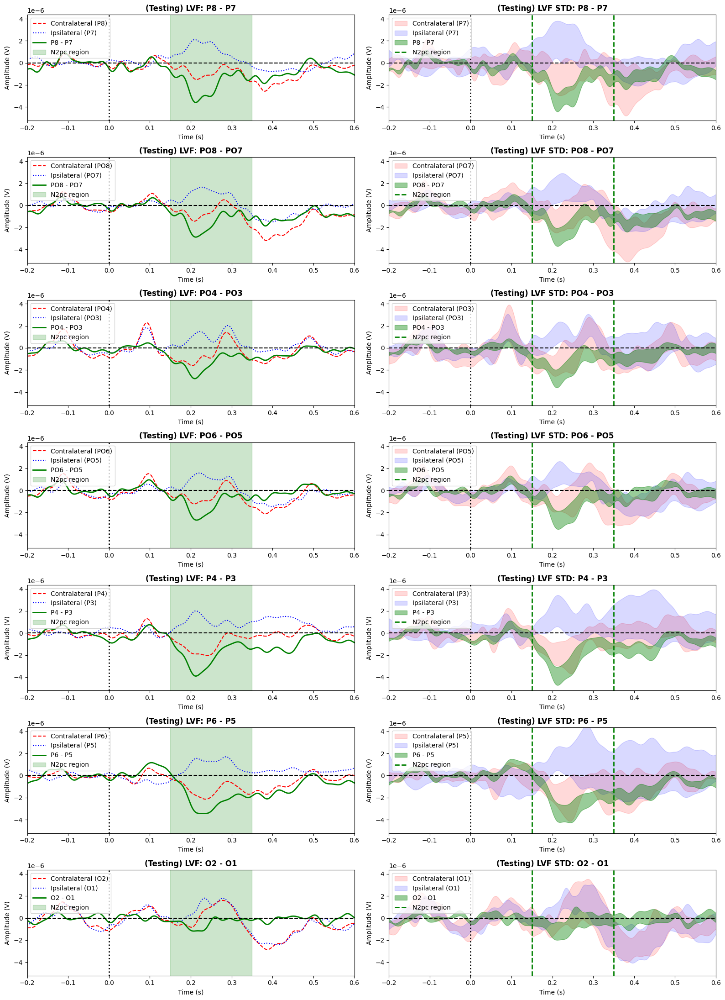

In [54]:
fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                               ncols = 2,
                               figsize=(16, 22))

for i in range(len(left_N2pc_ch_idx)):



    N2pc = LVF_aver_contralateral[i] - LVF_aver_ipsilateral[i]

    ax[i,0].plot(ERP_times, 
                       LVF_aver_contralateral[i],
                       'r--', 
                       label = f"Contralateral ({clean_ch[right_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       LVF_aver_ipsilateral[i],
                       'b:', 
                       label = f"Ipsilateral ({clean_ch[left_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       N2pc,
                       'g', 
                       label = f"{clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", linewidth = 2)

    ax[i,0].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,0].set_ylim([do_vlim,up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax[i,0].add_patch(N2pc_region)

    ax[i,0].set_title(f"(Testing) LVF: {clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,0].set_xlabel('Time (s)')
    ax[i,0].set_ylabel('Amplitude (V)')
    ax[i,0].legend(loc = 'upper left')

    ax[i,0].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[i,0].axhline(y=0, color = 'k', linestyle = 'dashed')


    ax[i,1].fill_between(ERP_times, 
                               LVF_aver_contralateral[i] - LVF_std_contralateral[i], 
                               LVF_aver_contralateral[i] + LVF_std_contralateral[i], 
                               color = 'r', 
                               alpha=0.15,
                               label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               LVF_aver_ipsilateral[i] - LVF_std_ipsilateral[i], 
                               LVF_aver_ipsilateral[i] + LVF_std_ipsilateral[i], 
                               color = 'b', 
                               alpha=0.15,
                               label = f"Ipsilateral ({clean_ch[left_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               N2pc - LVF_N2pc_std, 
                               N2pc + LVF_N2pc_std, 
                               color = 'g', 
                               alpha=0.4,
                               label = f"{clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}"
    );


    ax[i,1].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i,1].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i,1].axvline(x=0.15, color = 'g', label = 'N2pc region', linestyle='dashed', linewidth = 2)
    ax[i,1].axvline(x=0.35, color = 'g', linestyle='dashed', linewidth = 2)
    
    ax[i,1].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,1].set_ylim([do_vlim,up_vlim])

    ax[i,1].set_title(f"(Testing) LVF STD: {clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,1].set_xlabel('Time (s)')
    ax[i,1].set_ylabel('Amplitude (V)')
    ax[i,1].legend(loc = 'upper left')

plt.tight_layout()
plt.show()

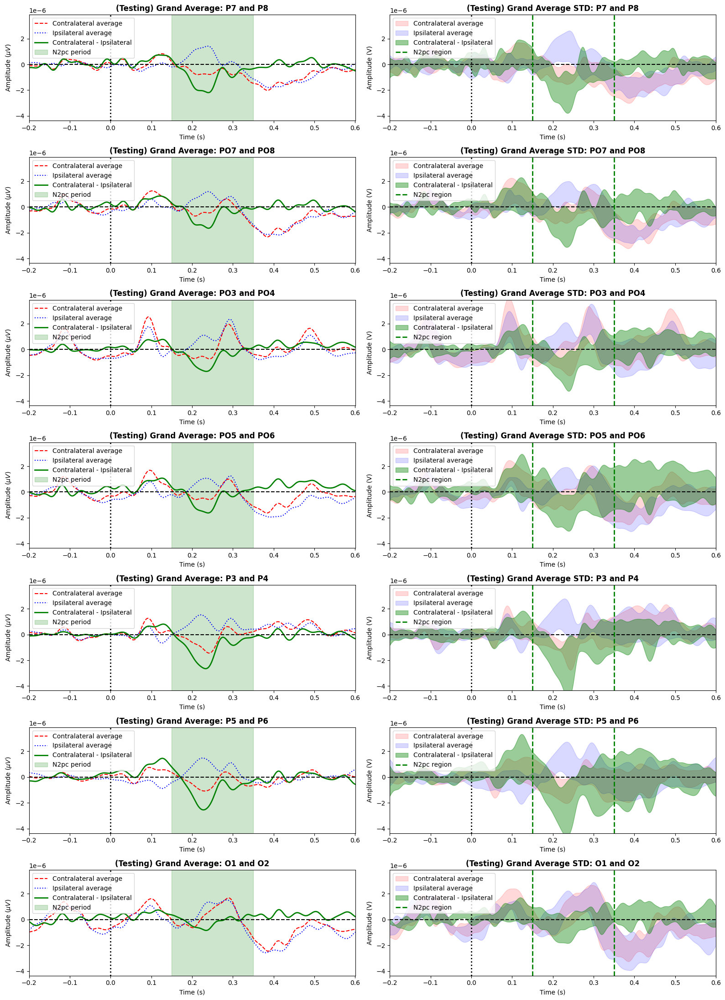

In [55]:
up_vlim = np.max(aver_ipsi) + np.max(std_cont) * 0.7
do_vlim = np.min(aver_cont - aver_ipsi) - np.max(N2pc_std) * 0.7

fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 2,
                                figsize=(16, 22))

for i in range(len(left_N2pc_ch_idx)):



    N2pc = aver_cont[i] - aver_ipsi[i]

    ax[i,0].plot(ERP_times, 
                       aver_cont[i],
                       'r--', 
                       label = 'Contralateral average')
    
    ax[i,0].plot(ERP_times, 
                       aver_ipsi[i],
                       'b:', 
                       label = 'Ipsilateral average')
    
    ax[i,0].plot(ERP_times, 
                       N2pc,
                       'g', 
                       label = "Contralateral - Ipsilateral", linewidth = 2)

    ax[i,0].set_xlim([np.min(ERP_times), np.max(ERP_times)])
    ax[i,0].set_ylim([do_vlim, up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc period")    

    ax[i,0].add_patch(N2pc_region)

    ax[i,0].set_title(f"(Testing) Grand Average: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,0].set_xlabel('Time (s)')
    ax[i,0].set_ylabel('Amplitude ($\mu V$)')
    ax[i,0].legend(loc='upper left')

    ax[i,0].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[i,0].axhline(y=0, color = 'k', linestyle = 'dashed')



    ax[i,1].fill_between(ERP_times, 
                     aver_cont[i] - std_cont[i], 
                     aver_cont[i] + std_cont[i], 
                     color = 'r', 
                     alpha=0.15,
                     label = 'Contralateral average'
    );

    ax[i,1].fill_between(ERP_times, 
                     aver_ipsi[i] - std_ipsi[i], 
                     aver_ipsi[i] + std_ipsi[i], 
                     color = 'b', 
                     alpha=0.15,
                     label = 'Ipsilateral average'
    );

    ax[i,1].fill_between(ERP_times, 
                     N2pc - N2pc_std[i], 
                     N2pc + N2pc_std[i], 
                     color = 'g', 
                     alpha=0.4,
                     label = "Contralateral - Ipsilateral"
    );

    ax[i,1].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i,1].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i,1].axvline(x=0.15, color = 'g', label = 'N2pc region', linestyle='dashed', linewidth = 2)
    ax[i,1].axvline(x=0.35, color = 'g', linestyle='dashed', linewidth = 2)
    
    ax[i,1].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,1].set_ylim([do_vlim,up_vlim])

    ax[i,1].set_title(f"(Testing) Grand Average STD: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,1].set_xlabel('Time (s)')
    ax[i,1].set_ylabel('Amplitude (V)')
    ax[i,1].legend(loc = 'upper left')

plt.tight_layout()
plt.show()

## RVF vs LVF Topomaps

Max vlim:  2.1067349461192313e-06
Min vlim:  -2.1443615353091205e-06


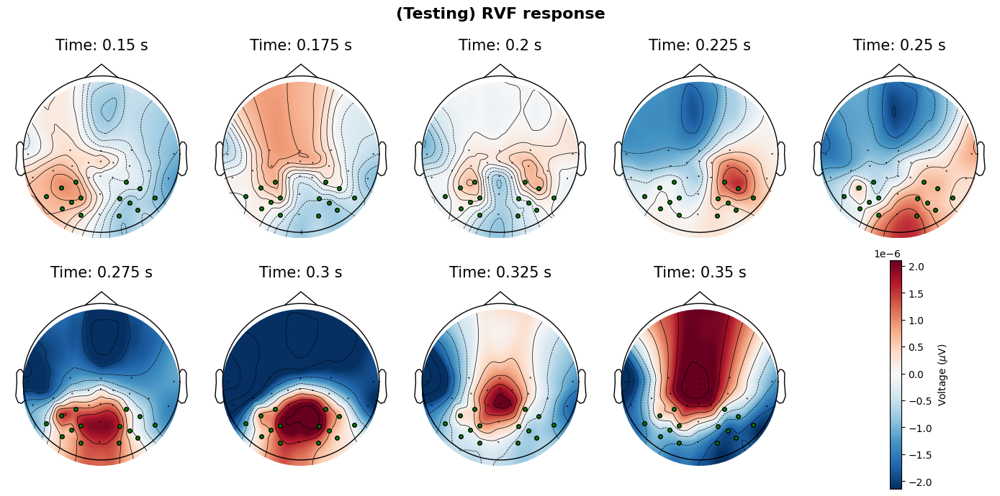

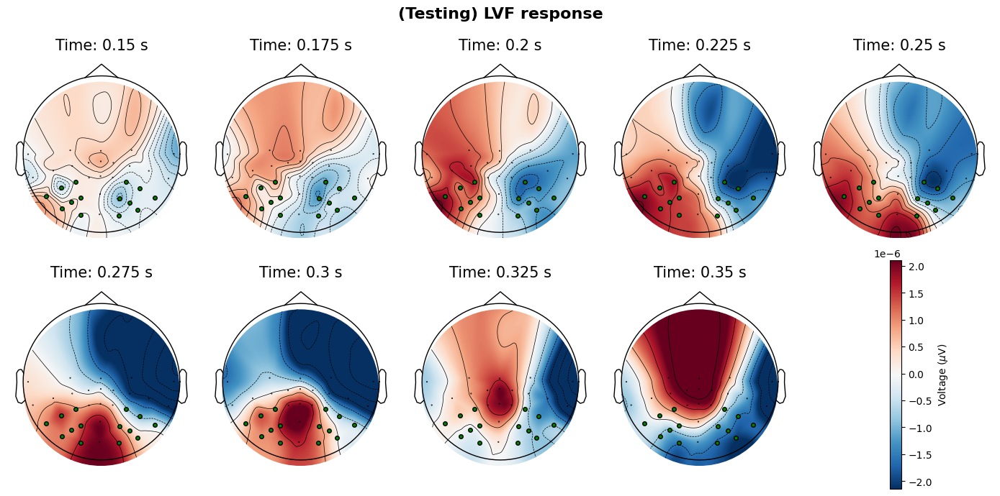

In [88]:
RVF_ERP = np.mean(np.mean(all_RVF_target, axis = 0), axis = 0)
LVF_ERP = np.mean(np.mean(all_LVF_target, axis = 0), axis = 0)

t_win = 0.01

t_intervals = [0.15,
               0.175, 
               0.2, 
               0.225, 
               0.25, 
               0.275, 
               0.3,
               0.325,
               0.35,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(LVF_ERP[left_N2pc_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(LVF_ERP[right_N2pc_ch_idx,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

N2pc_ch_idx = np.hstack((left_N2pc_ch_idx, right_N2pc_ch_idx))

highlight_ch = [1 if c in N2pc_ch_idx else 0 for c in range(len(clean_ch))]

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))


# --------------------------------------------- RVF ---------------------------------------------

fig.suptitle("(Testing) RVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[0].info,
                                      contours = 10,
                                      vlim = (vmap_min, vmap_max),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))

# --------------------------------------------- LVF ---------------------------------------------

fig.suptitle("(Testing) LVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[0].info,
                                      contours = 10,
                                      vlim = (vmap_min, vmap_max),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.tight_layout()
plt.show()

## Calculate the single-trial N2pc component

In [493]:
from scipy.signal import resample

# Isolating the datapoints related to the N2pc time window 

n_trials, n_channels, _ = np.shape(RVF_contralateral)

ts = 0.15
te = 0.35

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

all_featVectLVF = [] # Class label = 0
all_featVectRVF = [] # Class label = 1

all_NN_featVectLVF = []
all_NN_featVectRVF = []

for subj in range(NUM_SUBJ):

    featVectLVF = []
    featVectRVF = []

    NN_featVectLVF = []
    NN_featVectRVF = []

    for trial in range(n_trials):

        #LVF = resample(all_LVF_contralateral[subj][trial][:,idx_s:idx_e+1] - all_LVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        #RVF = resample(all_RVF_contralateral[subj][trial][:,idx_s:idx_e+1] - all_RVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)

        LVF1 = resample(all_LVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        LVF2 = resample(all_LVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        RVF1 = resample(all_RVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        RVF2 = resample(all_RVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        LVF = np.hstack((LVF1, LVF2))
        RVF = np.hstack((RVF2, RVF1))
        
        for c in range(1, n_channels):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        featVectLVF.append(np.hstack((auxLVF, 0)))
        featVectRVF.append(np.hstack((auxRVF, 1)))

        NN_featVectLVF.append(np.hstack((auxLVF, all_LVF_x_pos[subj][trial])))
        NN_featVectRVF.append(np.hstack((auxRVF, all_RVF_x_pos[subj][trial])))

    all_featVectLVF.append(featVectLVF)
    all_featVectRVF.append(featVectRVF) 

    all_NN_featVectLVF.append(NN_featVectLVF)
    all_NN_featVectRVF.append(NN_featVectRVF)

print(np.shape(all_featVectLVF))
print(np.shape(all_featVectRVF))

print(np.shape(all_NN_featVectLVF))
print(np.shape(all_NN_featVectRVF))

(6, 56, 197)
(6, 56, 197)
(6, 56, 197)
(6, 56, 197)


# **Classifying N2pc: RVF vs LVF**

## Train/Test Split and concatenate feature vectors for all channel differences

In [494]:
all_test_featVect = []
all_ordered_test_featVect = []

for subj in range(NUM_SUBJ):

    test_featVect = np.vstack((all_featVectLVF[subj], all_featVectRVF[subj]))
    ordered_test_featVect = test_featVect

    all_ordered_test_featVect.append(ordered_test_featVect)

    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_test_featVect.append(test_featVect)
    
print(np.shape(all_test_featVect))

(6, 112, 197)


## Row-wise normalization of the feature vector

Improved Model Performance: Many machine learning algorithms, especially those based on distances (e.g., k-Nearest Neighbors, SVMs), rely on the relative scales of features. Standardization ensures all features contribute equally to the distance calculations, potentially leading to better model performance.


Faster Convergence: In neural networks and other gradient-based optimization algorithms, standardization can help them converge faster during training.

In [495]:
# Feature wise normalization of feature vector

all_norm_test_featVect = []
all_o_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []
        o_norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

            o_mean = np.mean(all_ordered_test_featVect[subj][u,0:-1])
            o_std = np.std(all_ordered_test_featVect[subj][u,0:-1])
            o_norm_test_featVect.append(np.hstack(((all_ordered_test_featVect[subj][u,0:-1] - o_mean) / o_std, all_ordered_test_featVect[subj][u, -1])))

        test_featVect = np.array(norm_test_featVect)
        o_test_featVect = np.array(o_norm_test_featVect)

    else:

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_test_featVect.append(test_featVect)
    all_o_norm_test_featVect.append(o_test_featVect)

print(np.shape(all_norm_test_featVect))

(6, 112, 197)


## Classification models

### Loading Models

#### Loading channel selection

In [408]:
_, N2pc_bestFeats = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_RVF_vs_LVF_N2pc_BestElectrodesIndices/", [".pkl"])

all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_bestFeats[subj])
    all_best_channel_feat_idx.append(m)

#### Most dicriminative channels

In [419]:
_, N2pc_BF_models = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_RVF_vs_LVF_N2pc_BestElectrodes/", [".pkl"])

subj_BF_N2pc_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_BF_models[subj])
    subj_BF_N2pc_models.append(m)

In [420]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_BF_N2pc_models[subj].predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
    prediction_probs = subj_BF_N2pc_models[subj].predict_proba(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

In [421]:
perSubj_sensitivity

[0.75,
 0.7678571428571429,
 0.7142857142857143,
 0.5357142857142857,
 0.8214285714285714,
 0.6964285714285714]

In [422]:
perSubj_specificity

[0.5178571428571429,
 0.7142857142857143,
 0.5892857142857143,
 0.7142857142857143,
 0.75,
 0.5178571428571429]

#### Best classifier Cross-Validation Training accuracies for all subjects

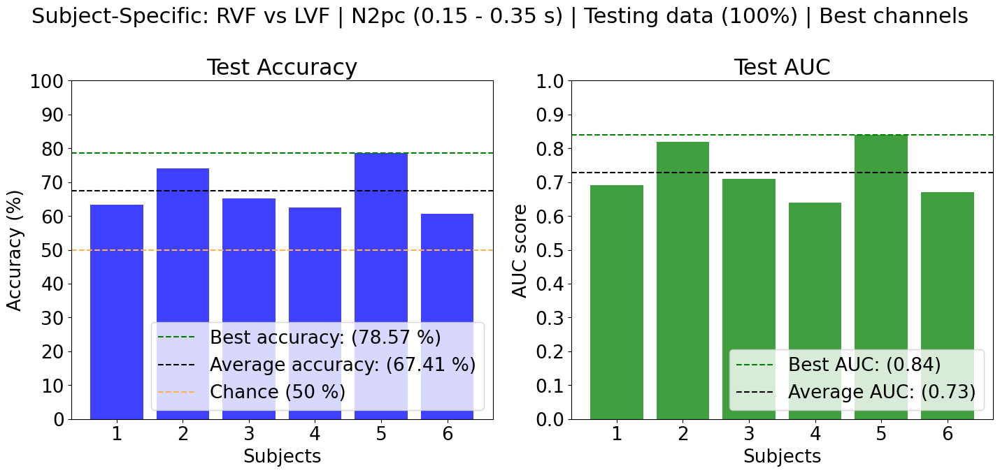

In [423]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF | N2pc ({ts} - {te} s) | Testing data (100%) | Best channels', fontsize=22)

# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Test Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')


ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step = 0.1), 
          ylabel='AUC score',
          title="Test AUC");

ax[1].legend(loc='lower right');

plt.rcParams.update({'font.size': 19})
plt.tight_layout()

#### Measuring prediction performance over trial blocks

In [424]:
NUM_BLOCKS = 8

trial_range = int(n_entries/NUM_BLOCKS)

perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_BF_N2pc_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, all_best_channel_feat_idx[subj]]), 
                                                                                        all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

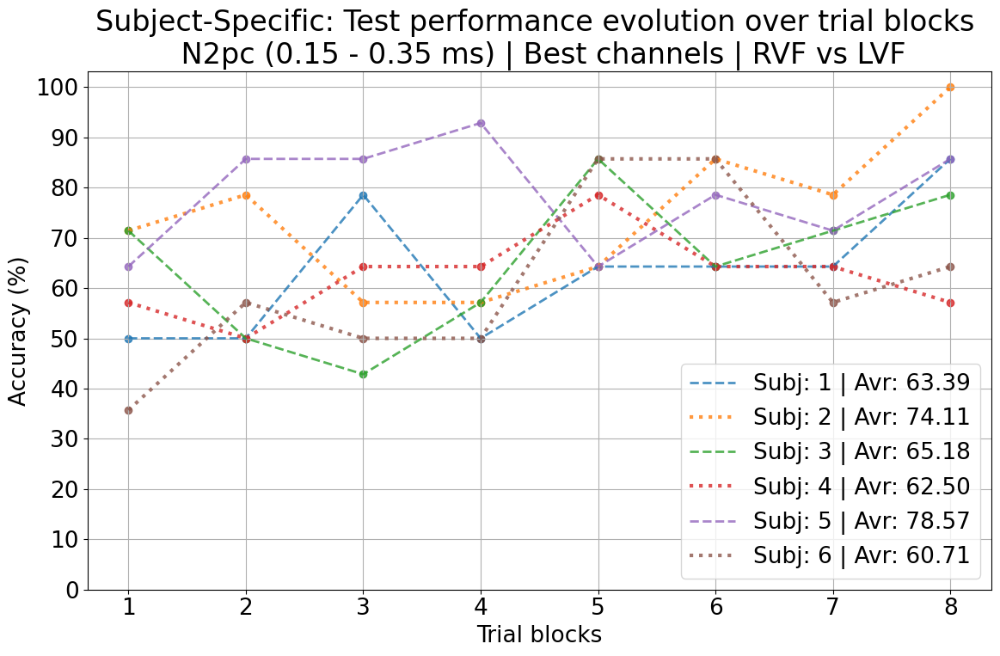

In [425]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f}", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n N2pc ({ts} - {te} ms) | Best channels | RVF vs LVF", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.tight_layout()
plt.grid()
plt.show()

#### All features (channel differences)

In [485]:
_, N2pc_models = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_RVF_vs_LVF_N2pc_AllElectrodes/", [".pkl"])

subj_N2pc_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_models[subj])
    subj_N2pc_models.append(m)

In [486]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_N2pc_models[subj].predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = subj_N2pc_models[subj].predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

In [487]:
perSubj_sensitivity

[0.6607142857142857,
 0.7857142857142857,
 0.7321428571428571,
 0.5,
 0.8214285714285714,
 0.6071428571428571]

In [488]:
perSubj_specificity

[0.625,
 0.7321428571428571,
 0.6428571428571429,
 0.6785714285714286,
 0.75,
 0.7142857142857143]

#### Best classifier Cross-Validation Training accuracies for all subjects

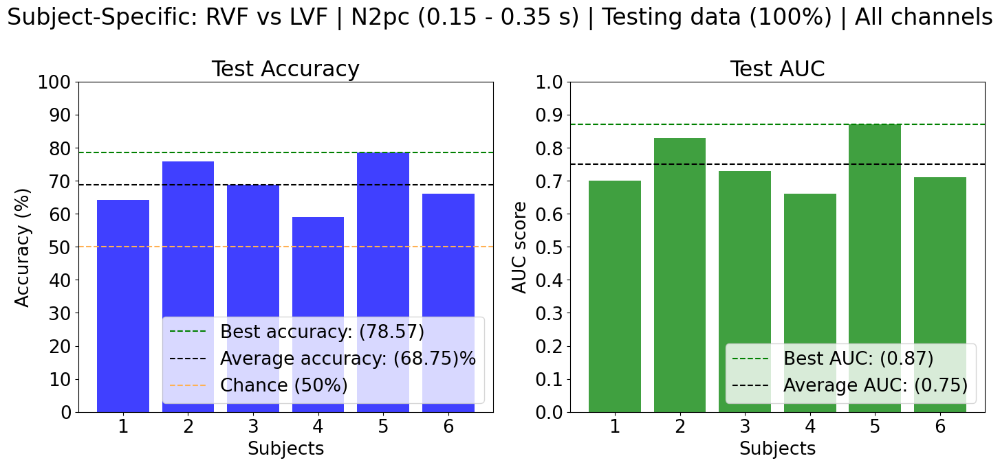

In [489]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Specific: RVF vs LVF | N2pc ({ts} - {te} s) | Testing data (100%) | All channels', fontsize=24)

# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f})')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f})%')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Test Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')


ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step = 0.1), 
          ylabel='AUC score',
          title="Test AUC");

ax[1].legend(loc='lower right');
plt.tight_layout()

#### Measuring prediction performance over trial blocks

In [490]:
NUM_BLOCKS = 8

trial_range = int(n_entries/NUM_BLOCKS)

perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_N2pc_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, 0:-1]), 
                                                                                     all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

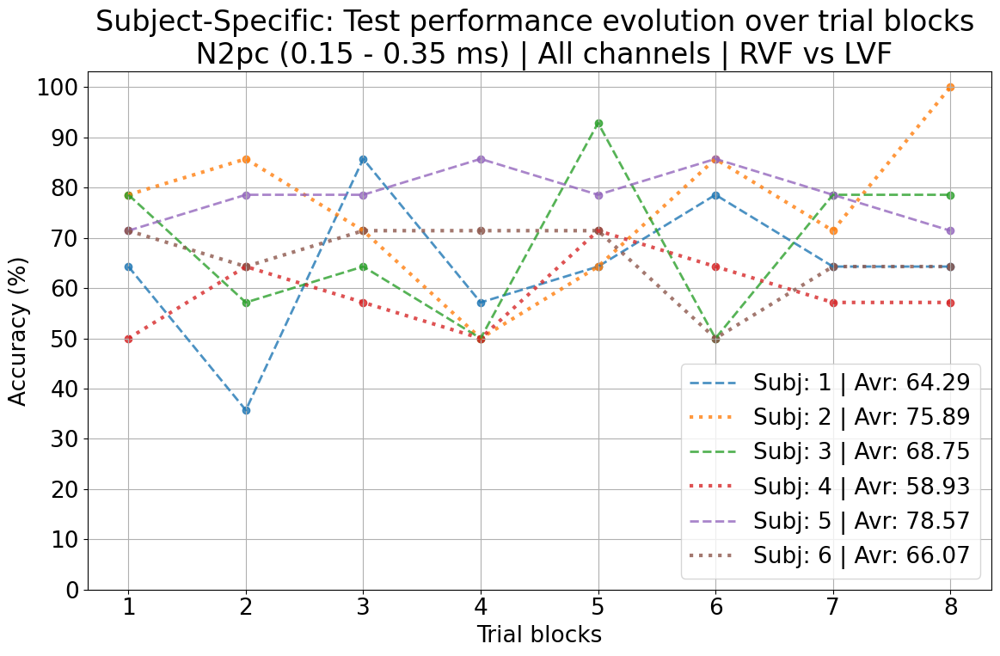

In [491]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f}", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n N2pc ({ts} - {te} ms) | All channels | RVF vs LVF", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.tight_layout()
plt.grid()
plt.show()

# **Deep Learning - Estimating the target object along the x axis in the images (N2pc)**

In [496]:
import torch
from torch import nn

# Make device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

## Testing NN model (N2pc - RVF vs LVF)

In [497]:
torch.manual_seed(42)

class N2pcModel(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(),
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

In [503]:
N2pc_NN_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/NN_x_pos_N2pc/"

_, N2pc_NN_models = run_fast_scandir(N2pc_NN_models_Folder, [".pt"])

perSubj_N2pc_NN_models = []

for subj in range(NUM_SUBJ):
    perSubj_N2pc_NN_models.append(N2pc_NN_models[subj])

In [505]:
from scipy.stats import pearsonr

In [508]:
all_testing_losses = []

all_real_x = []
all_x_preds = []

correlation = []
p_value = []

for subj in range(NUM_SUBJ):

  print(f"\n------------------ Subject {subj + 1}: Testing model ------------------")

  # Number of features
  test_featVect = np.vstack((all_NN_featVectRVF[subj], all_NN_featVectLVF[subj]))

  NUM_FEATURES = np.size(test_featVect,1) 

  # Fit the model
  torch.manual_seed(42)
      
  # Initializing model
  x_pos_model = torch.load(perSubj_N2pc_NN_models[subj])

  # Loss
  loss_fn = nn.L1Loss()

  # Shuffle

  np.random.seed(42)
  np.random.shuffle(test_featVect)

  tn_test_feat = torch.tensor(np.array(test_featVect[:,0:-1])).type(torch.float32)
  tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

  n_entries, n_feat = tn_test_feat.size()

  for u in range(n_entries):

      mean = tn_test_feat[u,:].mean(dim=0)
      std = tn_test_feat[u,:].std(dim=0)
      tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

  # ------------------------------------ Test ------------------------------------

  # 1. Set the model in evaluation mode

  x_pos_model.eval()

  # 2. Setup the inference mode context manager
  with torch.inference_mode():
    x_preds = x_pos_model(tn_test_feat)
    
  x_preds = x_preds.numpy()
  real_x = tn_test_lbl.numpy()

  all_x_preds.append(x_preds)
  all_real_x.append(real_x)

  # Calculate Pearson's correlation
  corr, p_v = pearsonr(np.squeeze(x_preds), real_x)

  correlation.append(corr)
  p_value.append(p_v)


------------------ Subject 1: Testing model ------------------

------------------ Subject 2: Testing model ------------------

------------------ Subject 3: Testing model ------------------

------------------ Subject 4: Testing model ------------------

------------------ Subject 5: Testing model ------------------

------------------ Subject 6: Testing model ------------------


## Ploting predictions against the real values of the object's position alongisde the x-axis (Most discriminative channels)

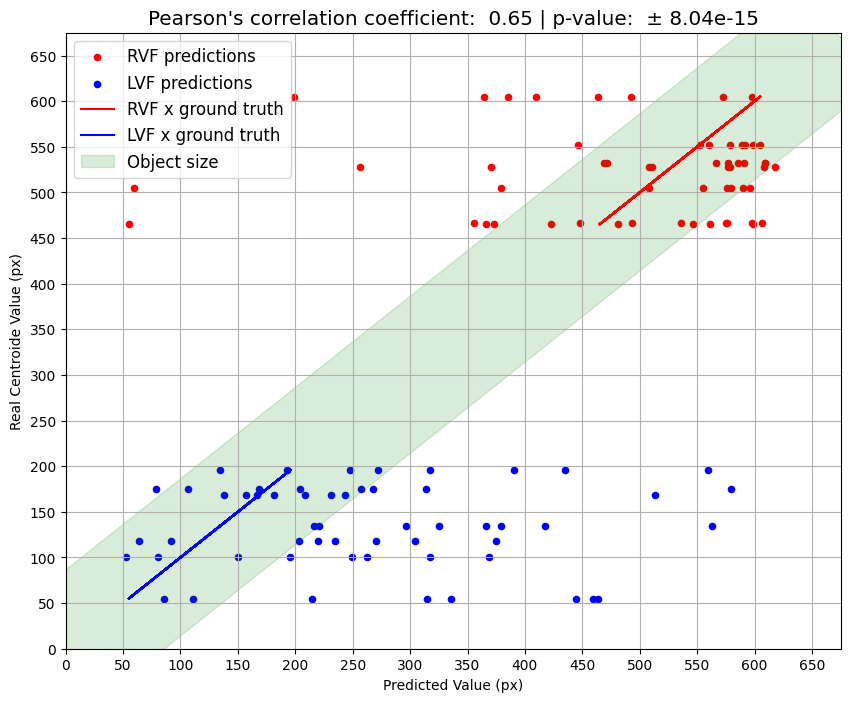

<Figure size 640x480 with 0 Axes>

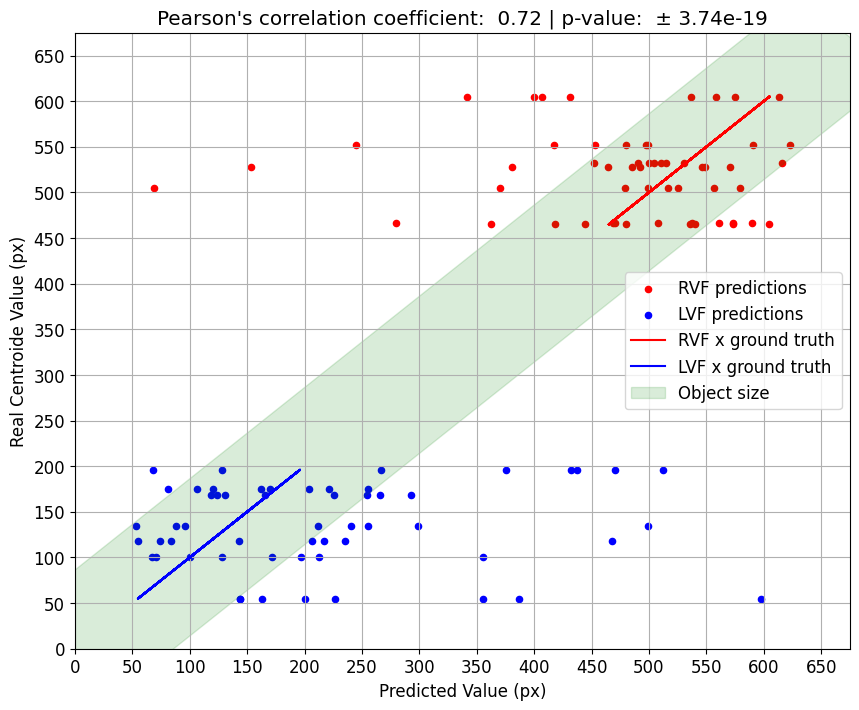

<Figure size 640x480 with 0 Axes>

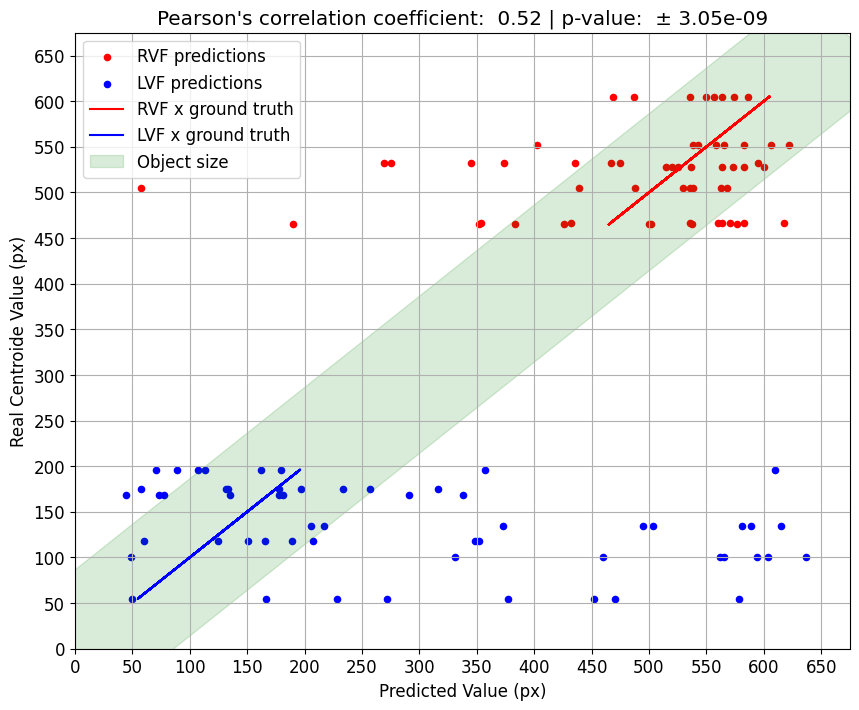

<Figure size 640x480 with 0 Axes>

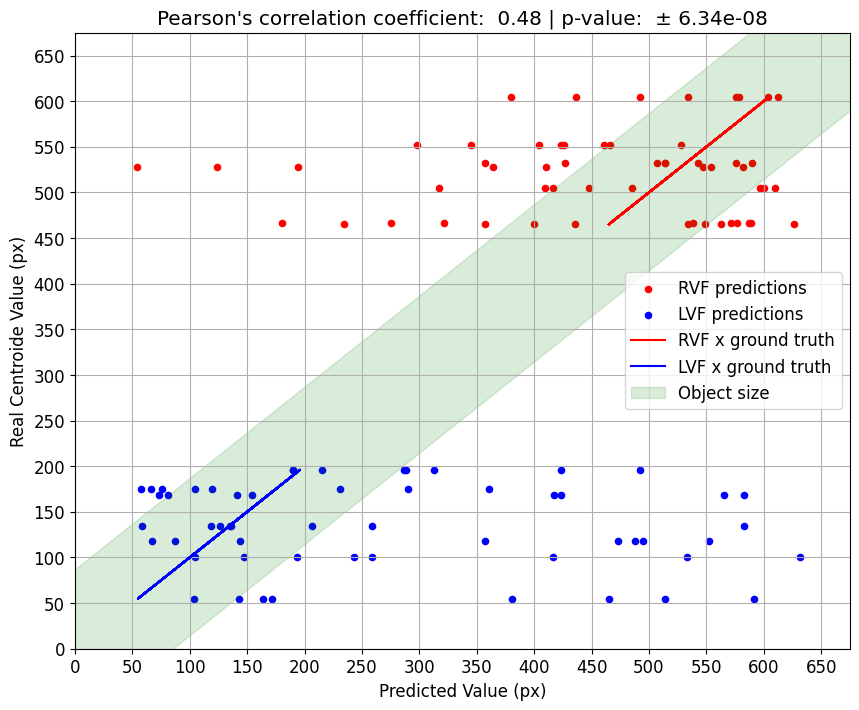

<Figure size 640x480 with 0 Axes>

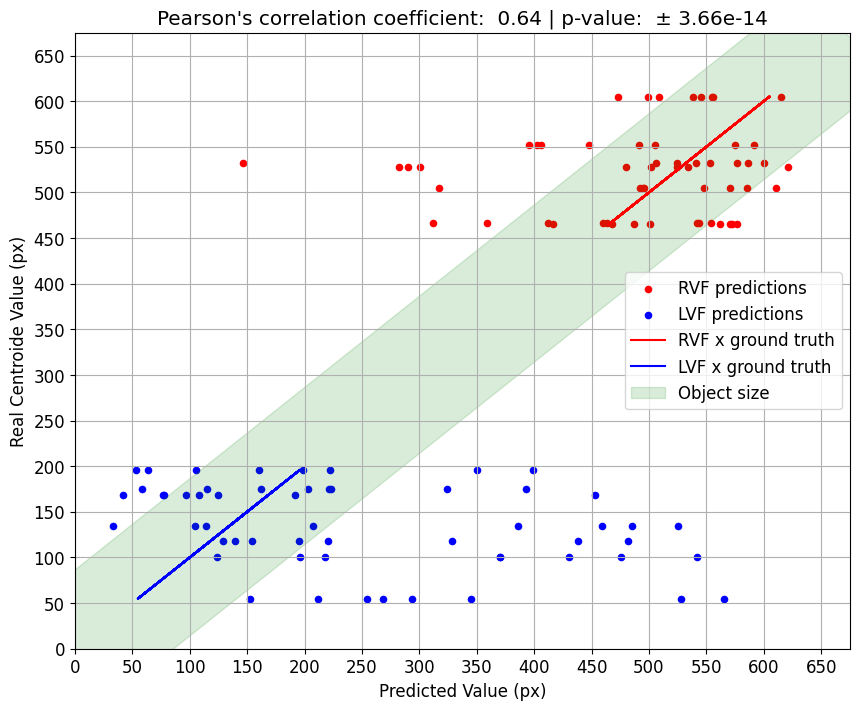

<Figure size 640x480 with 0 Axes>

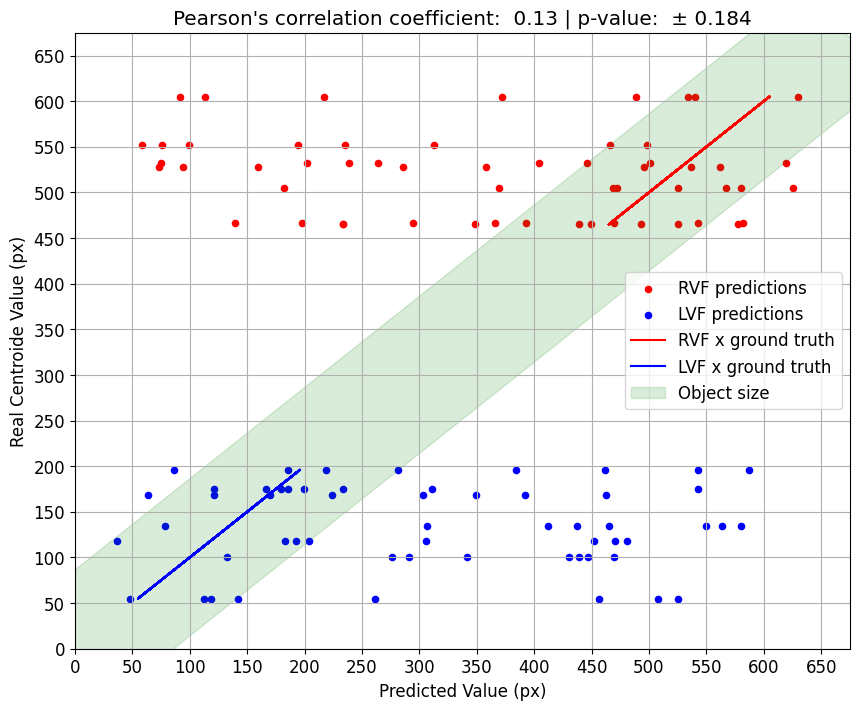

<Figure size 640x480 with 0 Axes>

In [509]:

import math

obj_region = (IM_WIDTH * 3.3)/18.2

plt.rcdefaults()

for subj in range(NUM_SUBJ):

    fig, ax = plt.subplots(nrows=1, ncols=1, figsize = (10,8))

    plt.rcParams.update({'font.size': 12})

    x_preds = all_x_preds[subj].reshape(len(all_x_preds[subj]),)

    '''
    Absolute error: |True value - Measured Value|
    Relative error: |Absolute error / True value|
    Percent  error: Relative error * 100
    '''
    rel_error = (np.abs(all_real_x[subj] - all_x_preds[subj])/all_real_x[subj])*100
    distance = np.abs(all_real_x[subj] - all_x_preds[subj])

    RVF_real_x = [x for x in range(len(all_real_x[subj])) if all_real_x[subj][x] > IM_WIDTH/2]
    LVF_real_x = [x for x in range(len(all_real_x[subj])) if all_real_x[subj][x] < IM_WIDTH/2]

    # Scatter plots on the same axes
    ax.scatter(all_x_preds[subj][RVF_real_x], all_real_x[subj][RVF_real_x], color='r', label='RVF predictions',alpha=1, s=20);
    ax.scatter(all_x_preds[subj][LVF_real_x], all_real_x[subj][LVF_real_x], color='b', label='LVF predictions',alpha=1, s=20);

    plus_minus_symbol = chr(0x00B1)
    ax.set(xlabel='Predicted Value (px)', 
        xticks=np.arange(0, IM_WIDTH + 3, step = 50),
        xlim=(0, IM_WIDTH + 3),
        ylabel='Real Centroide Value (px)',
        yticks=np.arange(0, IM_WIDTH + 3, step = 50),
        ylim=(0, IM_WIDTH + 3),
        title=(f"Pearson's correlation coefficient: {correlation[subj]: .2f} | p-value:  {plus_minus_symbol}{p_value[subj]: .3}"));
    ax.grid(True)

    ax.plot(all_real_x[subj][RVF_real_x], all_real_x[subj][RVF_real_x], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
    ax.plot(all_real_x[subj][LVF_real_x], all_real_x[subj][LVF_real_x], 'b', alpha=1, label = 'LVF x ground truth') 
    
    diag_rect = patches.Rectangle(
        (min(all_real_x[subj]) - 50, (min(all_real_x[subj]))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                    max(all_real_x[subj]) + 400, obj_region, 
                                    linewidth=1, edgecolor='g', facecolor='g', alpha=0.15, angle=45, label = 'Object size')
    ax.add_patch(diag_rect) # Patch plot

    ax.legend()

    plt.show()
    plt.tight_layout()

# **Averaging Midline Bilateral - Lateralized Ipsilateral component: N2pcb (200 - 400 ms)**

The mean amplitude of the N2pcb elicited by midline targets was computed as
the subtraction of the ipsilateral activity elicited by lateralized targets from the averaged bilateral activity elicited by
a midline target.

## Grand-Average

In [56]:
all_TVF = []
all_BVF = []

all_TVF_y_pos = []
all_BVF_y_pos = []

all_TVF_target = []
all_BVF_target = []

for subj in range(NUM_SUBJ):

    TVF = []
    BVF = []

    TVF_y_pos = []
    BVF_y_pos = []

    TVF_target = []
    BVF_target = []

    for trial in all_labelled_targets[subj]:
        if trial[VERTICAL_CONDITION_COL] == "TVF":
            TVF.append( (trial[DATA_COL][right_N2pc_ch_idx,:] + trial[DATA_COL][left_N2pc_ch_idx,:])/2 - aver_ipsi)
            TVF_target.append(trial[DATA_COL])
            TVF_y_pos.append(trial[Y_CENTROID_COL])
        elif trial[VERTICAL_CONDITION_COL] == "BVF":
            BVF.append( (trial[DATA_COL][right_N2pc_ch_idx,:] + trial[DATA_COL][left_N2pc_ch_idx,:])/2 - aver_ipsi)
            BVF_target.append(trial[DATA_COL])
            BVF_y_pos.append(trial[Y_CENTROID_COL])

    all_TVF.append(TVF)
    all_BVF.append(BVF)

    all_TVF_y_pos.append(TVF_y_pos)
    all_BVF_y_pos.append(BVF_y_pos)

    all_TVF_target.append(TVF_target)
    all_BVF_target.append(BVF_target)

aver_TVF = np.mean(all_TVF, axis = 0)
aver_BVF = np.mean(all_BVF, axis = 0)

grandAver_TVF = np.mean(aver_TVF, axis = 0)
grandAver_BVF = np.mean(aver_BVF, axis = 0)

std_TVF = np.std(aver_TVF, axis = 0)
std_BVF = np.std(aver_BVF, axis = 0)

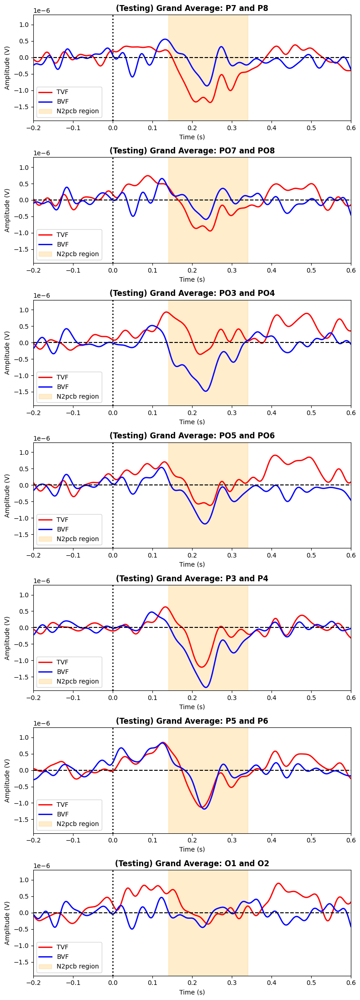

In [57]:
up_vlim = np.max(grandAver_TVF) * 1.4
do_vlim = np.min(grandAver_TVF) * 1.4

fig, ax1 = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 1,
                                figsize=(8, 22))

 
for i in range(len(left_N2pc_ch_idx)):

    ax1[i].plot(ERP_times, 
             grandAver_TVF[i],
             'r', 
             label = 'TVF', 
             linewidth = 2)
    
    ax1[i].plot(ERP_times, 
             grandAver_BVF[i],
             'b', 
             label = "BVF",
             linewidth = 2)

    ax1[i].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax1[i].set_ylim([do_vlim,up_vlim])

    N2pcb_region = patches.Rectangle((0.14, -0.1), 0.2, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.2, label = "N2pcb region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax1[i].add_patch(N2pcb_region)

    ax1[i].set_title(f"(Testing) Grand Average: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax1[i].set_xlabel('Time (s)')
    ax1[i].set_ylabel('Amplitude (V)')
    ax1[i].legend(loc = 'lower left')

    ax1[i].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax1[i].axhline(y=0, color = 'k', linestyle = 'dashed')

plt.tight_layout()
plt.show()

## TVF vs BVF Topomaps

Max vlim:  2.1067349461192313e-06
Min vlim:  -2.2355006621018833e-06


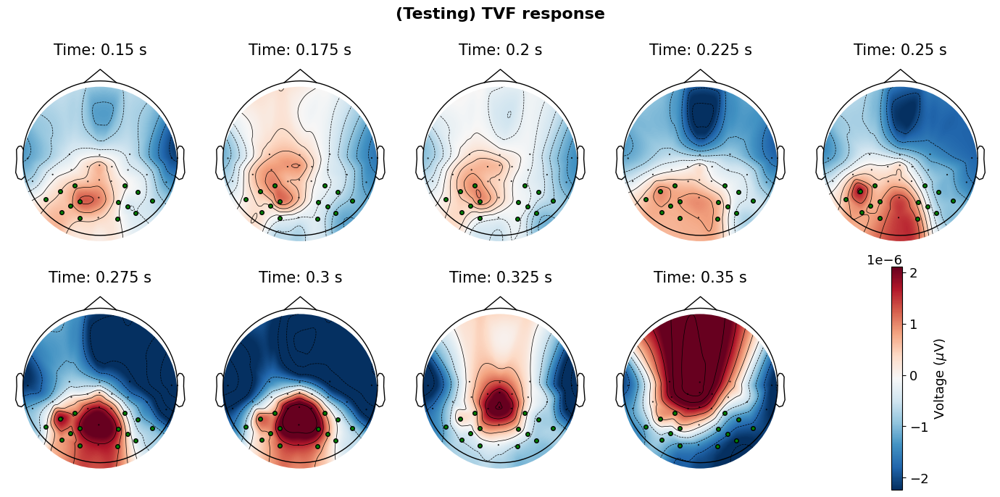

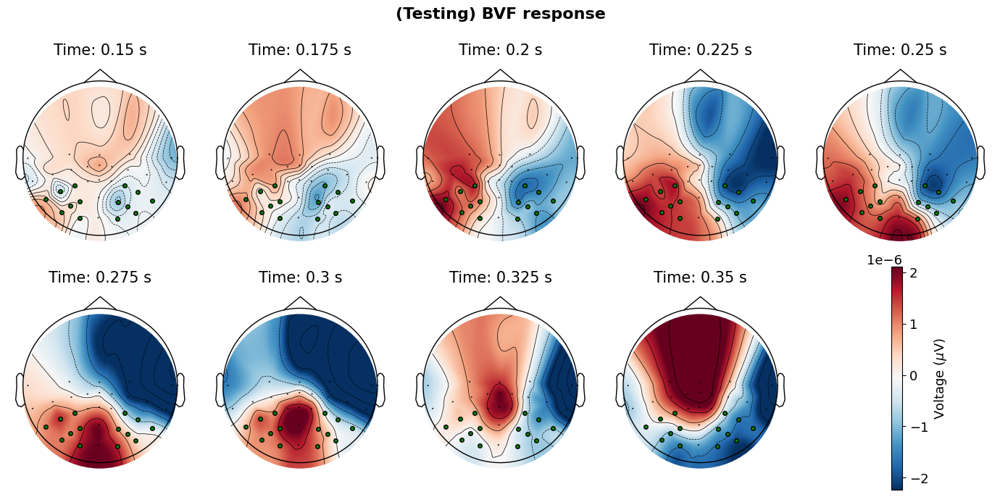

In [62]:
TVF_ERP = np.mean(np.mean(all_TVF_target, axis = 0), axis = 0)
BVF_ERP = np.mean(np.mean(all_LVF_target, axis = 0), axis = 0)

t_win = 0.01

t_intervals = [0.15,
               0.175, 
               0.2, 
               0.225, 
               0.25, 
               0.275, 
               0.3,
               0.325,
               0.35,
               0] # ms


t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(BVF_ERP[left_N2pc_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(TVF_ERP[right_N2pc_ch_idx,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

N2pc_ch_idx = np.hstack((left_N2pc_ch_idx, right_N2pc_ch_idx))

highlight_ch = [1 if c in N2pc_ch_idx else 0 for c in range(len(clean_ch))]

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))

fig.suptitle("(Testing) TVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(TVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))

fig.suptitle("(Testing) BVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(BVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.tight_layout()
plt.show()

## Calculate the single-trial N2pcb component

In [123]:
n_trials,  _, _ = np.shape(TVF)

ts = 0.15
te = 0.35

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

all_featVectTVF = []
all_featVectBVF = []

all_NN_featVectTVF = []
all_NN_featVectBVF = []

for subj in range(NUM_SUBJ):

    featVectTVF = []
    featVectBVF = []

    NN_featVectTVF = []
    NN_featVectBVF = []

    for trial in range(n_trials):

        res_TVF = resample(all_TVF[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        res_BVF = resample(all_BVF[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxTVF = np.hstack((res_TVF[c-1,:],res_TVF[c,:]))
                auxBVF = np.hstack((res_BVF[c-1,:],res_BVF[c,:]))
            else:
                auxTVF = np.hstack((auxTVF,res_TVF[c,:]))
                auxBVF = np.hstack((auxBVF,res_BVF[c,:]))
        
        featVectTVF.append(np.hstack((auxTVF, 0)))
        featVectBVF.append(np.hstack((auxBVF, 1)))

        NN_featVectTVF.append(np.hstack((auxTVF, TVF_y_pos[trial])))
        NN_featVectBVF.append(np.hstack((auxBVF, BVF_y_pos[trial])))

    all_featVectTVF.append(featVectTVF)
    all_featVectBVF.append(featVectBVF)

    all_NN_featVectTVF.append(NN_featVectTVF)
    all_NN_featVectBVF.append(NN_featVectBVF)

print(np.shape(all_featVectTVF))
print(np.shape(all_featVectBVF))

(6, 56, 99)
(6, 56, 99)


# **Classifying N2pcb: TVF vs BVF**

## Train/Test Split and concatenate feature vectors for all channel differences

In [125]:
all_test_featVect = []
all_ordered_test_featVect = []

for subj in range(NUM_SUBJ):

    test_featVect = np.vstack((all_featVectTVF[subj], all_featVectBVF[subj]))
    ordered_test_featVect = test_featVect

    all_ordered_test_featVect.append(ordered_test_featVect)

    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_test_featVect.append(test_featVect)
    
print(np.shape(all_test_featVect))

(6, 112, 99)


## Row-wise normalization of the feature vector

In [139]:
# Feature wise normalization of feature vector

all_norm_test_featVect = []
all_o_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []
        o_norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

            o_mean = np.mean(all_ordered_test_featVect[subj][u,0:-1])
            o_std = np.std(all_ordered_test_featVect[subj][u,0:-1])
            o_norm_test_featVect.append(np.hstack(((all_ordered_test_featVect[subj][u,0:-1] - o_mean) / o_std, all_ordered_test_featVect[subj][u, -1])))

        test_featVect = np.array(norm_test_featVect)
        o_test_featVect = np.array(o_norm_test_featVect)

    else:

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_test_featVect.append(test_featVect)
    all_o_norm_test_featVect.append(o_test_featVect)

print(np.shape(all_norm_test_featVect))

(6, 112, 99)


## Classification models

### Loading Models

#### Loading channel selection

In [127]:
_, N2pcb_bestFeats = run_fast_scandir("C:/Users/VascoRocha(1161216)/Desktop/Rocha/Models/SS_TVF_vs_BVF_N2pcb_BestElectrodesIndices/", [".pkl"])

all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pcb_bestFeats[subj])
    all_best_channel_feat_idx.append(m)

#### Most dicriminative channels

In [130]:
_, N2pcb_BF_models = run_fast_scandir("C:/Users/VascoRocha(1161216)/Desktop/Rocha/Models/SS_TVF_vs_BVF_N2pcb_BestElectrodes/", [".pkl"])

subj_BF_N2pcb_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pcb_BF_models[subj])
    subj_BF_N2pcb_models.append(m)

In [132]:
perSubj_accuracy = []
perSubj_auc_scores = []

for subj in range(NUM_SUBJ):
    perSubj_accuracy.append( accuracy_score(subj_BF_N2pcb_models[subj].predict(all_norm_test_featVect[subj][:,all_best_channel_feat_idx[subj]]), all_norm_test_featVect[subj][:,-1]) * 100 )
    perSubj_auc_scores.append( round(roc_auc_score(all_norm_test_featVect[subj][:, -1], subj_BF_N2pcb_models[subj].predict_proba(all_norm_test_featVect[subj][:,all_best_channel_feat_idx[subj]])[:,1]), 2) )

#### Best classifier Cross-Validation Training accuracies for all subjects

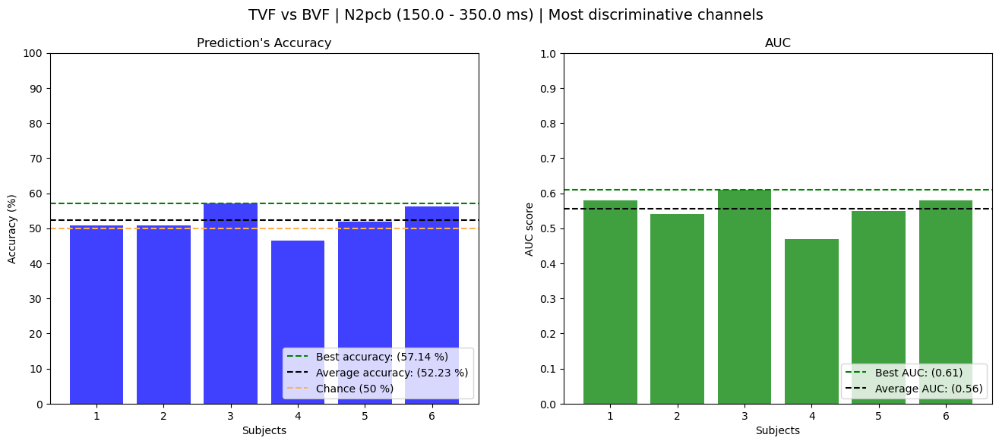

In [133]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(16, 6))


fig.suptitle(f'TVF vs BVF | N2pcb ({ts * 1000} - {te * 1000} ms) | Most discriminative channels', fontsize=14)

# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Prediction's Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')


ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step = 0.1), 
          ylabel='AUC score',
          title="AUC");

ax[1].legend(loc='lower right');

#### Measuring prediction performance over trial blocks

In [140]:
NUM_BLOCKS = 8

trial_range = int(n_entries/NUM_BLOCKS)

perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_BF_N2pcb_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, all_best_channel_feat_idx[subj]]), 
                                                                                         all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

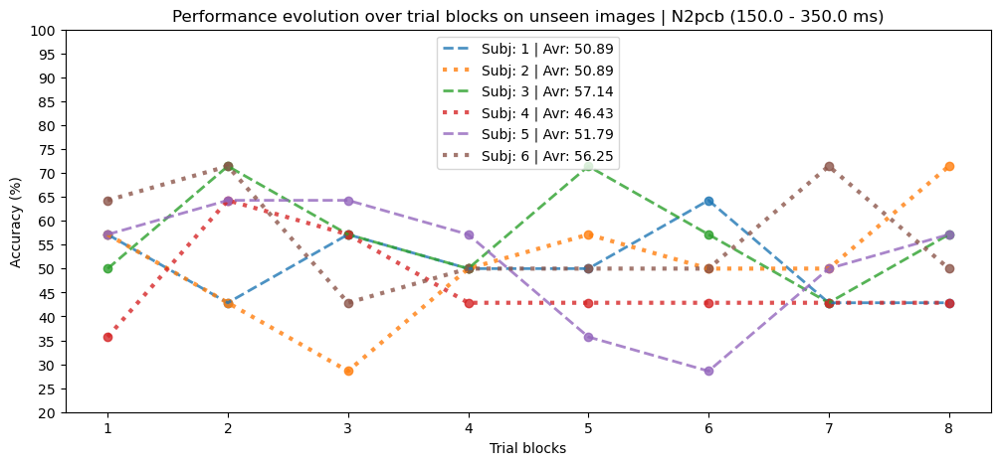

In [141]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,5))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f}", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Performance evolution over trial blocks on unseen images | N2pcb ({ts * 1000} - {te * 1000} ms)")
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(20, 101,5))
plt.legend()
plt.show()

#### All channels

In [144]:
_, N2pcb_models = run_fast_scandir("C:/Users/VascoRocha(1161216)/Desktop/Rocha/Models/SS_TVF_vs_BVF_N2pcb_AllElectrodes/", [".pkl"])

subj_N2pcb_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pcb_models[subj])
    subj_N2pcb_models.append(m)

In [145]:
perSubj_accuracy = []
perSubj_auc_scores = []

for subj in range(NUM_SUBJ):
    perSubj_accuracy.append( accuracy_score(subj_N2pcb_models[subj].predict(all_norm_test_featVect[subj][:,0:-1]), all_norm_test_featVect[subj][:,-1]) * 100 )
    perSubj_auc_scores.append( round(roc_auc_score(all_norm_test_featVect[subj][:, -1], subj_N2pcb_models[subj].predict_proba(all_norm_test_featVect[subj][:,0:-1])[:,1]), 2) )

#### Best classifier Cross-Validation Training accuracies for all subjects

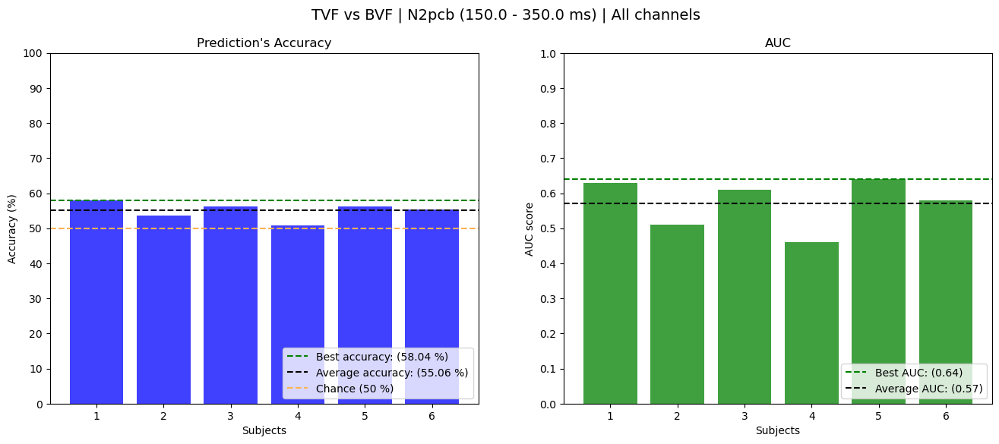

In [146]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(16, 6))


fig.suptitle(f'TVF vs BVF | N2pcb ({ts * 1000} - {te * 1000} ms) | All channels', fontsize=14)

# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Prediction's Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')


ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step = 0.1), 
          ylabel='AUC score',
          title="AUC");

ax[1].legend(loc='lower right');

#### Measuring prediction performance over trial blocks

In [148]:
NUM_BLOCKS = 8

trial_range = int(n_entries/NUM_BLOCKS)

perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_N2pcb_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, 0:-1]), 
                                                                                      all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

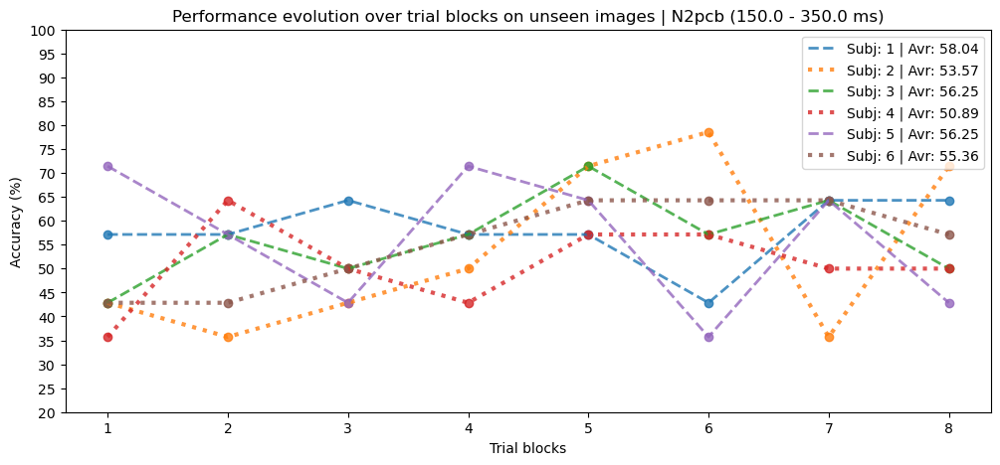

In [149]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,5))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f}", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Performance evolution over trial blocks on unseen images | N2pcb ({ts * 1000} - {te * 1000} ms)")
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(20, 101,5))
plt.legend()
plt.show()

# Signal analysis and Classification based on 4 quadrants: (RVF and TBF; RVF and TBF; LVF and TBF; LVF and TBF)

## Calculating the single trial N2pc for each quadrant

In [58]:
all_RVF_TVF_contralateral = []
all_RVF_TVF_ipsilateral = []

all_RVF_BVF_contralateral = []
all_RVF_BVF_ipsilateral = []

all_LVF_TVF_contralateral = []
all_LVF_TVF_ipsilateral = []

all_LVF_BVF_contralateral = []
all_LVF_BVF_ipsilateral = []

all_RVF_TVF_target = []
all_RVF_BVF_target = []
all_LVF_TVF_target = []
all_LVF_BVF_target = []

all_RVF_TVF_xy_pos = []
all_RVF_BVF_xy_pos = []
all_LVF_TVF_xy_pos = []
all_LVF_BVF_xy_pos = []

for subj in range(NUM_SUBJ):

    RVF_TVF_contralateral = []
    RVF_TVF_ipsilateral = []

    RVF_BVF_contralateral = []
    RVF_BVF_ipsilateral = []

    LVF_TVF_contralateral = []
    LVF_TVF_ipsilateral = []

    LVF_BVF_contralateral = []
    LVF_BVF_ipsilateral = []

    RVF_TVF_target = []
    RVF_BVF_target = []
    LVF_TVF_target = []
    LVF_BVF_target = []

    RVF_TVF_xy_pos = []
    RVF_BVF_xy_pos = []
    LVF_TVF_xy_pos = []
    LVF_BVF_xy_pos = []

    for trial in labelled_targets:
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[VERTICAL_CONDITION_COL] == "TVF"):
            RVF_TVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_TVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_TVF_target.append(trial[DATA_COL])

            RVF_TVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

        elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[VERTICAL_CONDITION_COL] == "BVF"):
            RVF_BVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_BVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_BVF_target.append(trial[DATA_COL])

            RVF_BVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[VERTICAL_CONDITION_COL] == "TVF"):
            LVF_TVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_TVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_TVF_target.append(trial[DATA_COL])

            LVF_TVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[VERTICAL_CONDITION_COL] == "BVF"):
            LVF_BVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_BVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            
            LVF_BVF_target.append(trial[DATA_COL])

            LVF_BVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])


    all_RVF_TVF_contralateral.append(RVF_TVF_contralateral)
    all_RVF_TVF_ipsilateral.append(RVF_TVF_ipsilateral)

    all_RVF_BVF_contralateral.append(RVF_BVF_contralateral)
    all_RVF_BVF_ipsilateral.append(RVF_BVF_ipsilateral)

    all_LVF_TVF_contralateral.append(LVF_TVF_contralateral)
    all_LVF_TVF_ipsilateral.append(LVF_TVF_ipsilateral)

    all_LVF_BVF_contralateral.append(LVF_BVF_contralateral)
    all_LVF_BVF_ipsilateral.append(LVF_BVF_ipsilateral)

    all_RVF_TVF_target.append(RVF_TVF_target)
    all_RVF_BVF_target.append(RVF_BVF_target)
    all_LVF_TVF_target.append(RVF_BVF_target)
    all_LVF_BVF_target.append(LVF_BVF_target)

    all_RVF_TVF_xy_pos.append(RVF_TVF_xy_pos)
    all_RVF_BVF_xy_pos.append(RVF_BVF_xy_pos)
    all_LVF_TVF_xy_pos.append(LVF_TVF_xy_pos)
    all_LVF_BVF_xy_pos.append(LVF_BVF_xy_pos)

print("Nº RVF | TVF: ", np.shape(all_RVF_TVF_target))
print("Nº RVF | BVF: ", np.shape(all_RVF_BVF_target))
print("Nº LVF | TVF: ", np.shape(all_LVF_TVF_target))
print("Nº LVF | BVF: ", np.shape(all_LVF_BVF_target))

Nº RVF | TVF:  (6, 24, 33, 1640)
Nº RVF | BVF:  (6, 24, 33, 1640)
Nº LVF | TVF:  (6, 24, 33, 1640)
Nº LVF | BVF:  (6, 24, 33, 1640)


## Grand-Averages

In [59]:
RVF_TVF_aver = np.mean(np.mean(np.array(all_RVF_TVF_contralateral) - np.array(all_RVF_TVF_ipsilateral), axis = 0), axis = 0)
RVF_BVF_aver = np.mean(np.mean(np.array(all_RVF_BVF_contralateral) - np.array(all_RVF_BVF_ipsilateral), axis = 0), axis = 0)
LVF_TVF_aver = np.mean(np.mean(np.array(all_LVF_TVF_contralateral) - np.array(all_LVF_TVF_ipsilateral), axis = 0), axis = 0)
LVF_BVF_aver = np.mean(np.mean(np.array(all_LVF_BVF_contralateral) - np.array(all_LVF_BVF_ipsilateral), axis = 0), axis = 0)

RVF_TVF_erp = np.mean(np.mean(all_RVF_TVF_target, axis = 0), axis = 0)
RVF_BVF_erp = np.mean(np.mean(all_RVF_BVF_target, axis = 0), axis = 0)
LVF_TVF_erp = np.mean(np.mean(all_LVF_TVF_target, axis = 0), axis = 0)
LVF_BVF_erp = np.mean(np.mean(all_LVF_BVF_target, axis = 0), axis = 0)

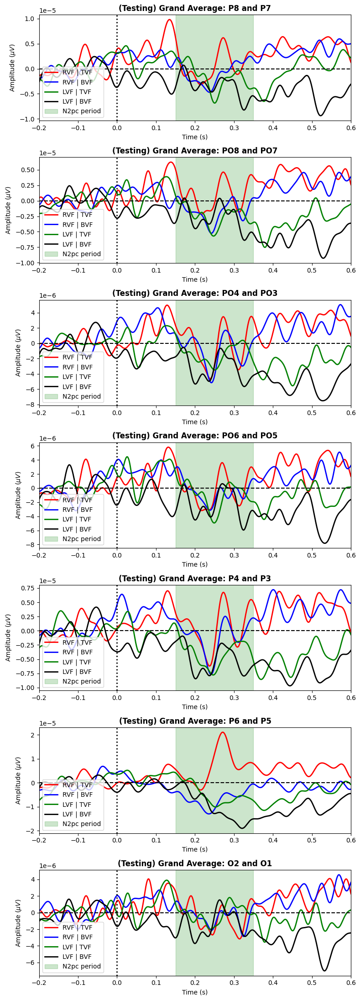

In [60]:
fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 1,
                                figsize=(8, 22))

for i in range(len(left_N2pc_ch_idx)):

    ax[i].plot(ERP_times, RVF_TVF_aver[i],'r', label = 'RVF | TVF', linewidth = 2)
    ax[i].plot(ERP_times, RVF_BVF_aver[i],'b', label = 'RVF | BVF', linewidth = 2)
    ax[i].plot(ERP_times, LVF_TVF_aver[i],'g', label = 'LVF | TVF', linewidth = 2)
    ax[i].plot(ERP_times, LVF_BVF_aver[i],'k', label = 'LVF | BVF', linewidth = 2)

    ax[i].set_xlim([np.min(ERP_times),np.max(ERP_times)])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc period")    

    ax[i].add_patch(N2pc_region)

    ax[i].set_title(f"(Testing) Grand Average: {clean_ch[right_N2pc_ch_idx[i]]} and {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i].set_xlabel('Time (s)')
    ax[i].set_ylabel('Amplitude ($\mu V$)')

    ax[i].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i].legend(loc='lower left')

plt.tight_layout()
plt.show()

# **Target vs Non - Target (N2pc and P3)**

## Feature vectors

In [274]:
all_RVF_contralateral = []
all_RVF_ipsilateral = []
all_LVF_contralateral = []
all_LVF_ipsilateral = []
all_CVF_contralateral = []
all_CVF_ipsilateral = []

all_RVF_P3 = []
all_LVF_P3 = []
all_CVF_P3 = []

for subj in range(NUM_SUBJ):

    RVF_contralateral = []
    RVF_ipsilateral = []
    LVF_contralateral = []
    LVF_ipsilateral = []
    CVF_contralateral = []
    CVF_ipsilateral = []

    RVF_P3 = []
    LVF_P3 = []
    CVF_P3 = []

    for trial in all_labelled_targets[subj]:
        
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF"):

            RVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_P3.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF"):

            LVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            LVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            LVF_P3.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "CVF"):

            CVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            CVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            CVF_P3.append(trial[DATA_COL][P3_ch_idx,:])

    all_RVF_contralateral.append(RVF_contralateral)
    all_RVF_ipsilateral.append(RVF_ipsilateral)

    all_LVF_contralateral.append(LVF_contralateral)
    all_LVF_ipsilateral.append(LVF_ipsilateral)
    
    all_CVF_contralateral.append(CVF_contralateral)
    all_CVF_ipsilateral.append(CVF_ipsilateral)

    all_RVF_P3.append(RVF_P3)
    all_LVF_P3.append(LVF_P3)
    all_CVF_P3.append(CVF_P3)

In [275]:
# Isolating the datapoints related to the N2pc time window 

n_trials_lateral, n_channels_N2pc, _ = np.shape(RVF_contralateral)
n_trials_central = np.size(CVF_contralateral, 0)

ts_N2pc = 0.15
te_N2pc = 0.35

idx_s_N2pc = np.argmin(np.abs(ERP_times - ts_N2pc))
idx_e_N2pc = np.argmin(np.abs(ERP_times - te_N2pc))

ts_P3 = 0.28
te_P3 = 0.48

idx_s_P3 = np.argmin(np.abs(ERP_times - ts_P3))
idx_e_P3 = np.argmin(np.abs(ERP_times - te_P3))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ_N2PC = len(ERP_times[idx_s_N2pc:idx_e_N2pc+1])
N_DATAPOINTS_RESA_FREQ_N2PC = int(np.ceil((N_DATAPOINTS_ORIG_FREQ_N2PC * RESAMPLE_FREQ)/fs)) + 1

N_DATAPOINTS_ORIG_FREQ_P3 = len(ERP_times[idx_s_P3:idx_e_P3+1])
N_DATAPOINTS_RESA_FREQ_P3 = int(np.ceil((N_DATAPOINTS_ORIG_FREQ_P3 * RESAMPLE_FREQ)/fs)) + 1

all_n2pc_featTarget = []
all_n2pc_featNonTarget = []

all_featTarget = []
all_featNonTarget = []

for subj in range(NUM_SUBJ):

    n2pc_featVectLVF = []
    n2pc_featVectRVF = []
    n2pc_featVectCVF = []
    n2pc_featVectNT = []

    featVectLVF = []
    featVectRVF = []
    featVectCVF = []
    featVectNT = []

    for trial in range(n_trials_lateral):

        '''

        LVF = resample(all_LVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1] - all_LVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                       N_DATAPOINTS_RESA_FREQ_N2PC, 
                       axis = -1)
        RVF = resample(all_RVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1] - all_RVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                       N_DATAPOINTS_RESA_FREQ_N2PC, 
                       axis = -1)
        
        '''

        LVF1 = resample(all_LVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1],N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        LVF2 = resample(all_LVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        
        RVF1 = resample(all_RVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        RVF2 = resample(all_RVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        
        
        LVF = np.hstack((LVF1, LVF2))
        RVF = np.hstack((RVF1, RVF2))
        
        p3_LVF = resample(all_LVF_P3[subj][trial][:,idx_s_P3:idx_e_P3+1], 
                          N_DATAPOINTS_RESA_FREQ_P3, 
                          axis = -1)
        
        p3_RVF = resample(all_RVF_P3[subj][trial][:,idx_s_P3:idx_e_P3+1], 
                          N_DATAPOINTS_RESA_FREQ_P3, 
                          axis = -1)
        
        for c in range(1, n_channels_N2pc):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        n2pc_featVectLVF.append(np.hstack((auxLVF, 1)))
        n2pc_featVectRVF.append(np.hstack((auxRVF, 1)))

        featVect_n2pc_Target = np.vstack((n2pc_featVectLVF, n2pc_featVectRVF))

        for c in range(len(P3_ch_idx)):
            
            auxRVF = np.hstack((auxRVF,p3_RVF[c,:]))
            auxLVF = np.hstack((auxLVF,p3_LVF[c,:]))

        featVectLVF.append(np.hstack((auxLVF, 1)))
        featVectRVF.append(np.hstack((auxRVF, 1)))

        featVect_Target = np.vstack((featVectLVF,featVectRVF))


    ''' ================================================================================================================ '''


    for trial in range(n_trials_central):

        CVF1 = resample(all_CVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                        N_DATAPOINTS_RESA_FREQ_N2PC, 
                        axis = -1)
        
        CVF2 = resample(all_CVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                        N_DATAPOINTS_RESA_FREQ_N2PC, 
                        axis = -1)
        
        CVF = np.hstack((CVF1, CVF2))

        p3_CVF = resample(all_CVF_P3[subj][trial][:,idx_s_P3:idx_e_P3+1], 
                            N_DATAPOINTS_RESA_FREQ_P3, 
                            axis = -1)
        
        for c in range(1, n_channels_N2pc):

            if (c == 1):
                auxCVF = np.hstack((CVF[c-1,:],CVF[c,:]))
            else:
                auxCVF = np.hstack((auxCVF,CVF[c,:]))
        
        n2pc_featVectCVF.append(np.hstack((auxCVF, 1)))


        for c in range(len(P3_ch_idx)):
            
            auxCVF = np.hstack((auxCVF,p3_CVF[c,:]))

        featVectCVF.append(np.hstack((auxCVF, 1)))

    ''' ================================================================================================================ '''


    for trial in range(n_trials_lateral * 2 + n_trials_central):

        nontargets_N2pc_1 = resample(all_baseline_corr_nontargets[subj][trial+trial + trial][left_N2pc_ch_idx,idx_s_N2pc:idx_e_N2pc+1], 
                                     N_DATAPOINTS_RESA_FREQ_N2PC, 
                                    axis = -1)
        
        nontargets_N2pc_2 = resample(all_baseline_corr_nontargets[subj][trial+trial+ trial][right_N2pc_ch_idx,idx_s_N2pc:idx_e_N2pc+1],
                                     N_DATAPOINTS_RESA_FREQ_N2PC, 
                                    axis = -1)

        nontargets_N2pc = np.hstack((nontargets_N2pc_1,  nontargets_N2pc_2))

        nontargets_P3 = resample(all_baseline_corr_nontargets[subj][trial+trial+ trial][P3_ch_idx,idx_s_P3:idx_e_P3+1] , 
                                 N_DATAPOINTS_RESA_FREQ_P3, 
                                 axis = -1)
        
        for c in range(1, n_channels_N2pc):

            if (c == 1):
                auxNT = np.hstack((nontargets_N2pc[c-1,:],nontargets_N2pc[c,:]))
            else:
                auxNT = np.hstack((auxNT, nontargets_N2pc[c,:]))
            
        n2pc_featVectNT.append(np.hstack((auxNT, 0)))

        for c in range(len(P3_ch_idx)):
            
            auxNT = np.hstack((auxNT,nontargets_P3[c,:]))

        featVectNT.append(np.hstack((auxNT, 0)))

    featVect_n2pc_Target = np.vstack((featVect_n2pc_Target, n2pc_featVectCVF))
    featVect_Target = np.vstack((featVect_Target, featVectCVF))

    all_n2pc_featTarget.append(featVect_n2pc_Target)
    all_featTarget.append(featVect_Target)

    all_n2pc_featNonTarget.append(n2pc_featVectNT)
    all_featNonTarget.append(featVectNT)

print(np.shape(all_featTarget))
print(np.shape(all_featNonTarget))


(6, 128, 267)
(6, 128, 267)


In [276]:
all_test_featVect = []
all_ordered_test_featVect = []

for subj in range(NUM_SUBJ):

    test_featVect = np.vstack((all_n2pc_featTarget[subj], all_n2pc_featNonTarget[subj]))
    ordered_test_featVect = test_featVect

    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_test_featVect.append(test_featVect)
    all_ordered_test_featVect.append(ordered_test_featVect)

## Row-wise normalization of the feature vector

Improved Model Performance: Many machine learning algorithms, especially those based on distances (e.g., k-Nearest Neighbors, SVMs), rely on the relative scales of features. Standardization ensures all features contribute equally to the distance calculations, potentially leading to better model performance.


Faster Convergence: In neural networks and other gradient-based optimization algorithms, standardization can help them converge faster during training.

In [277]:
# Feature wise normalization of feature vector

all_norm_test_featVect = []
all_o_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []
        o_norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))
            
            o_mean = np.mean(all_ordered_test_featVect[subj][u,0:-1])
            o_std = np.std(all_ordered_test_featVect[subj][u,0:-1])
            o_norm_test_featVect.append(np.hstack(((all_ordered_test_featVect[subj][u,0:-1] - o_mean) / o_std, all_ordered_test_featVect[subj][u, -1])))

        test_featVect = np.array(norm_test_featVect)
        o_test_featVect = np.array(o_norm_test_featVect)

    all_norm_test_featVect.append(test_featVect)
    all_o_norm_test_featVect.append(o_test_featVect)

print(np.shape(all_norm_test_featVect))

(6, 256, 197)


### Loading Models (N2pc)

#### Loading channel selection

In [278]:
import joblib

In [279]:
_, N2pc_bestElec_Folder = run_fast_scandir( "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_BestElectrodesIndices/", [".pkl"])

all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_bestElec_Folder[subj])
    all_best_channel_feat_idx.append(m)

#### Most dicriminative channels

In [280]:
_, N2pc_bestFeat_models_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_BestElectrodes/", [".pkl"])

subj_BF_N2pc_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_bestFeat_models_Folder[subj])
    subj_BF_N2pc_models.append(m)

In [281]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_BF_N2pc_models[subj].predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
    prediction_probs = subj_BF_N2pc_models[subj].predict_proba(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)


In [282]:
ts = 0.15
te = 0.35

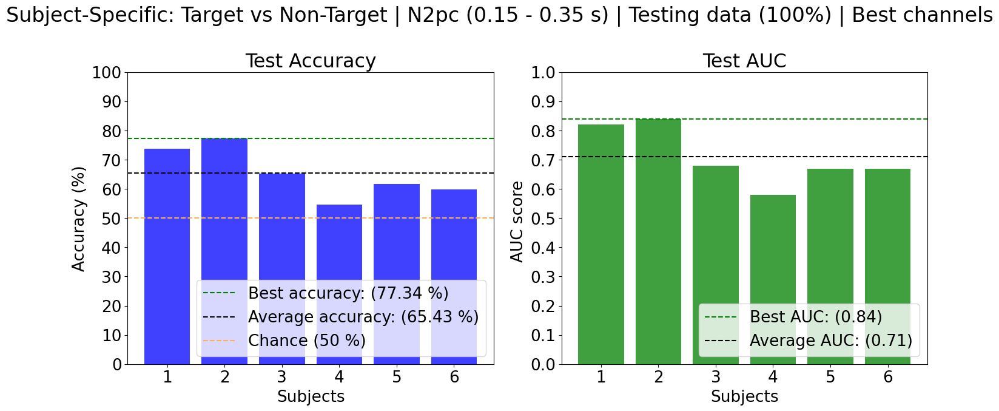

In [283]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc ({ts} - {te} s) | Testing data (100%) | Best channels', fontsize=24)

# -------------- Prediction Accuracy --------------

plt.rcParams.update({'font.size': 19})

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Test Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step=0.10), 
          ylabel='AUC score ',
          title="Test AUC");

ax[1].legend(loc='lower right');
plt.tight_layout()


In [284]:
perSubj_sensitivity

[0.7109375, 0.859375, 0.6328125, 0.4140625, 0.6015625, 0.515625]

In [285]:
perSubj_specificity

[0.765625, 0.6875, 0.671875, 0.6796875, 0.6328125, 0.6796875]

In [286]:
NUM_BLOCKS = 8

In [287]:
perSubj_accuracy = []
trial_range = int(n_entries/NUM_BLOCKS)

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_BF_N2pc_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, all_best_channel_feat_idx[subj]]), 
                                                      all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

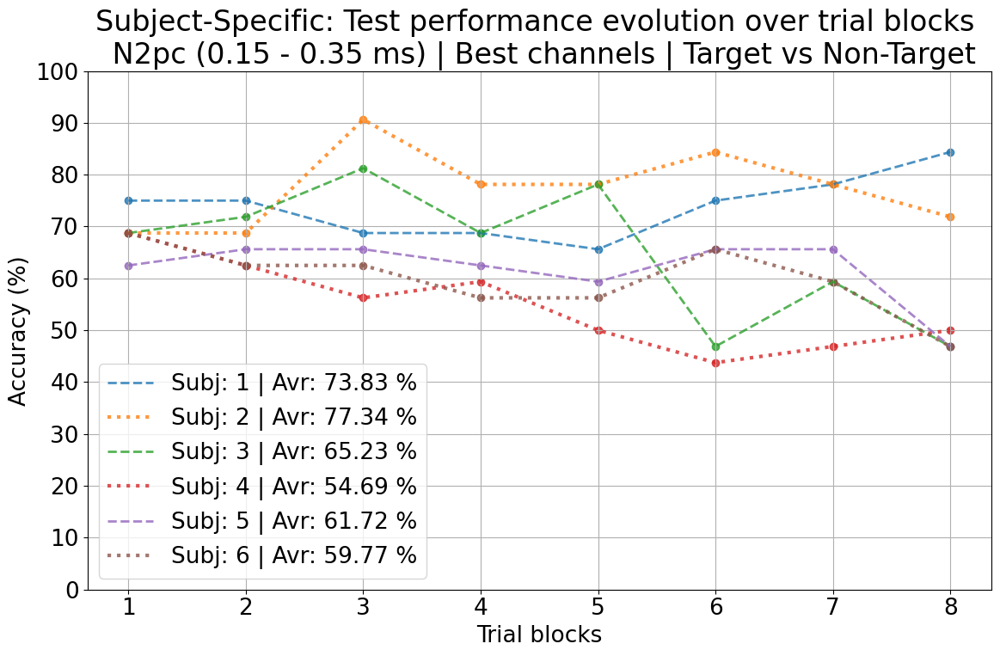

In [288]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f} %", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n N2pc ({ts} - {te} ms) | Best channels | Target vs Non-Target", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

#### All channels

In [289]:
_, N2pc_models_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_AllElectrodes/", [".pkl"])

subj_N2pc_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_models_Folder[subj])
    subj_N2pc_models.append(m)

In [290]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_N2pc_models[subj].predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = subj_N2pc_models[subj].predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

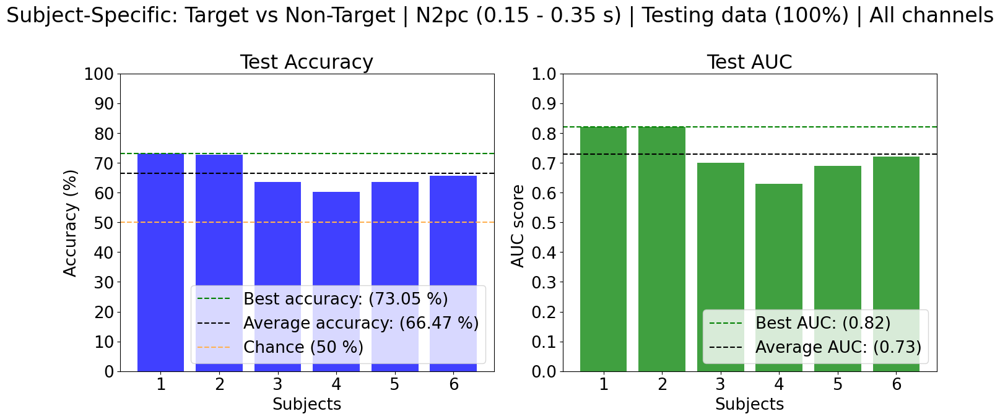

In [291]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc ({ts} - {te} s) | Testing data (100%) | All channels', fontsize=24)

# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Test Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step=0.10), 
          ylabel='AUC score ',
          title="Test AUC");

ax[1].legend(loc='lower right');
plt.tight_layout()


In [292]:
perSubj_sensitivity

[0.6875, 0.8359375, 0.5859375, 0.4921875, 0.6328125, 0.59375]

In [293]:
perSubj_specificity

[0.7734375, 0.6171875, 0.6875, 0.7109375, 0.640625, 0.71875]

In [294]:
perSubj_accuracy = []
trial_range = int(n_entries/NUM_BLOCKS)

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_N2pc_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, 0:-1]), 
                                                      all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

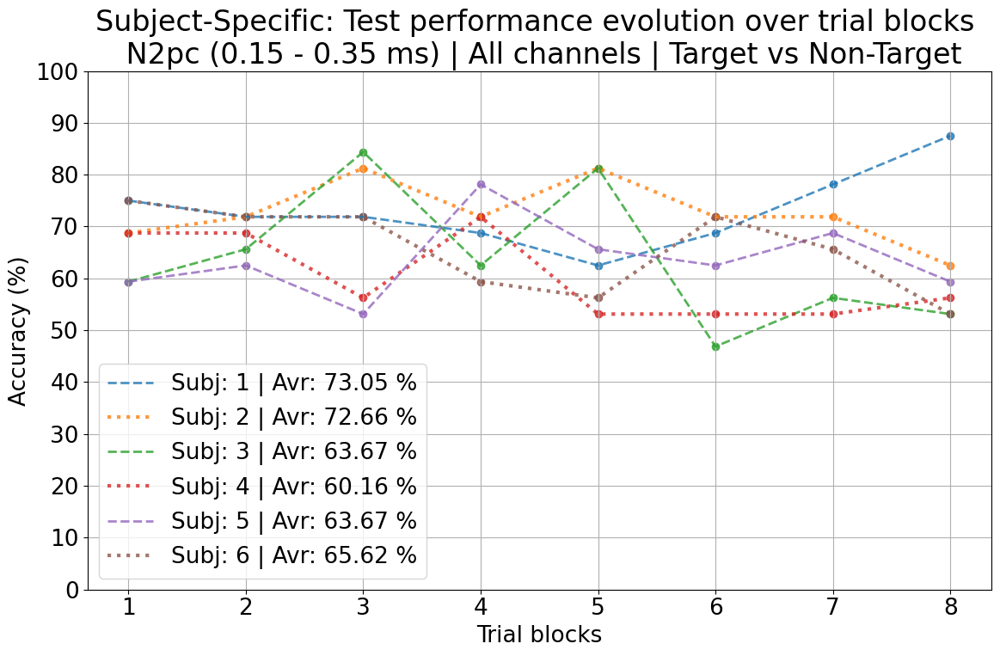

In [295]:
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f} %", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n N2pc ({ts} - {te} ms) | All channels | Target vs Non-Target", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

In [296]:
_, GEN_N2pc_models_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_Target_vs_NonTarget_N2pc/", [".pkl"])

GEN_N2pc_model = joblib.load(GEN_N2pc_models_Folder[0])

In [297]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = GEN_N2pc_model.predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = GEN_N2pc_model.predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

In [298]:
perSubj_sensitivity

[0.8046875, 0.796875, 0.359375, 0.546875, 0.65625, 0.546875]

In [299]:
np.mean(perSubj_sensitivity)

0.6184895833333334

In [300]:
perSubj_specificity

[0.53125, 0.53125, 0.6640625, 0.625, 0.5703125, 0.7890625]

In [301]:
np.mean(perSubj_specificity)

0.6184895833333334

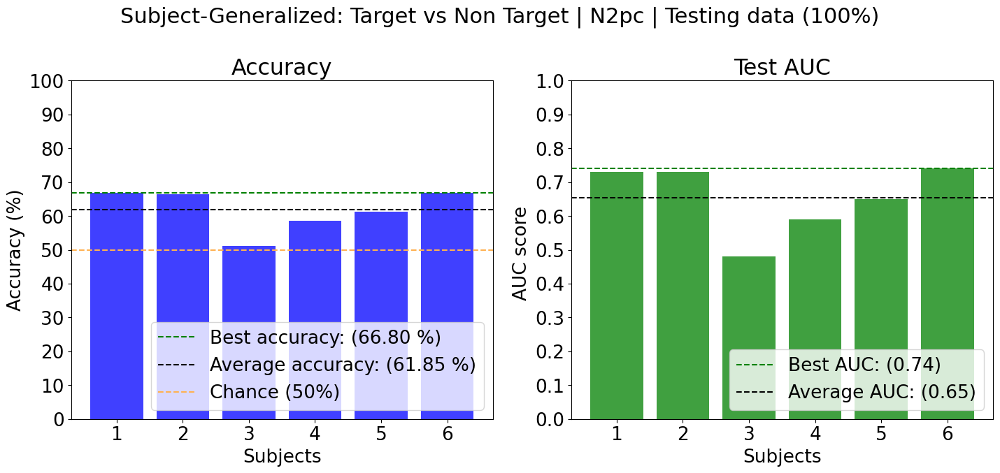

In [302]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Generalized: Target vs Non Target | N2pc | Testing data (100%)', fontsize=22)


# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Test Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step=0.10), 
          ylabel='AUC score ',
          title="Test AUC");

ax[1].legend(loc='lower right');


plt.rcParams.update({'font.size': 19})
plt.tight_layout()


### Loading Models (N2pc and P3)

In [303]:
all_test_featVect = []
all_ordered_test_featVect = []

for subj in range(NUM_SUBJ):

    test_featVect = np.vstack((all_featTarget[subj], all_featNonTarget[subj]))
    ordered_test_featVect = test_featVect

    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_test_featVect.append(test_featVect)
    all_ordered_test_featVect.append(ordered_test_featVect)

In [304]:
# Feature wise normalization of feature vector

all_norm_test_featVect = []
all_o_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []
        o_norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))
            
            o_mean = np.mean(all_ordered_test_featVect[subj][u,0:-1])
            o_std = np.std(all_ordered_test_featVect[subj][u,0:-1])
            o_norm_test_featVect.append(np.hstack(((all_ordered_test_featVect[subj][u,0:-1] - o_mean) / o_std, all_ordered_test_featVect[subj][u, -1])))

        test_featVect = np.array(norm_test_featVect)
        o_test_featVect = np.array(o_norm_test_featVect)

    all_norm_test_featVect.append(test_featVect)
    all_o_norm_test_featVect.append(o_test_featVect)

print(np.shape(all_norm_test_featVect))

(6, 256, 267)


#### Loading channel selection

In [305]:
_, N2pc_P3_bestElec_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_P3_BestElectrodesIndices/", [".pkl"])

all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_P3_bestElec_Folder[subj])
    all_best_channel_feat_idx.append(m)

#### Most dicriminative channels

In [306]:
_, N2pc_P3_bestFeat_models_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_P3_BestElectrodes/", [".pkl"])

subj_BF_N2pc_P3_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_P3_bestFeat_models_Folder[subj])
    subj_BF_N2pc_P3_models.append(m)

In [307]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_BF_N2pc_P3_models[subj].predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
    prediction_probs = subj_BF_N2pc_P3_models[subj].predict_proba(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

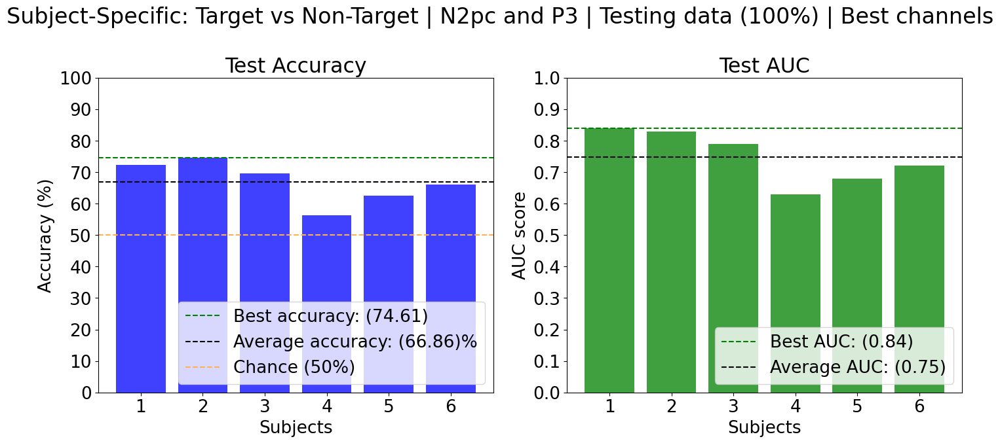

In [308]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc and P3 | Testing data (100%) | Best channels', fontsize=24)
plt.rcParams.update({'font.size': 19})
# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f})')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f})%')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Test Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')


ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step = 0.1), 
          ylabel='AUC score',
          title="Test AUC");

ax[1].legend(loc='lower right');
plt.tight_layout()


In [309]:
perSubj_sensitivity

[0.6171875, 0.7421875, 0.828125, 0.6796875, 0.7109375, 0.703125]

In [310]:
perSubj_specificity

[0.828125, 0.75, 0.5625, 0.4453125, 0.5390625, 0.6171875]

In [311]:
NUM_BLOCKS = 8

perSubj_accuracy = []
trial_range = int(n_entries/NUM_BLOCKS)

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_BF_N2pc_P3_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, all_best_channel_feat_idx[subj]]), 
                                                      all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

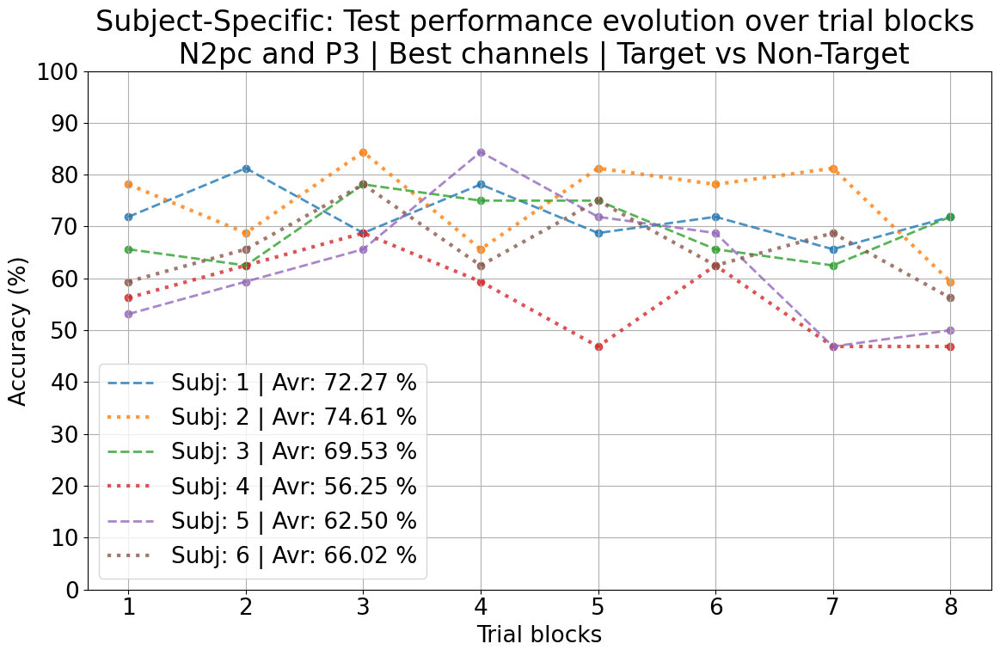

In [312]:
figure(figsize = (12,8))
n_points = np.linspace(1,NUM_BLOCKS, NUM_BLOCKS, endpoint = True)

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f} %", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n N2pc and P3 | Best channels | Target vs Non-Target", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

#### All channels

In [313]:
_, N2pc_P3_models_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_P3_AllElectrodes/", [".pkl"])

subj_N2pc_P3_models = []

for subj in range(NUM_SUBJ):

    m = joblib.load(N2pc_P3_models_Folder[subj])
    subj_N2pc_P3_models.append(m)

In [314]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = subj_N2pc_P3_models[subj].predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = subj_N2pc_P3_models[subj].predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

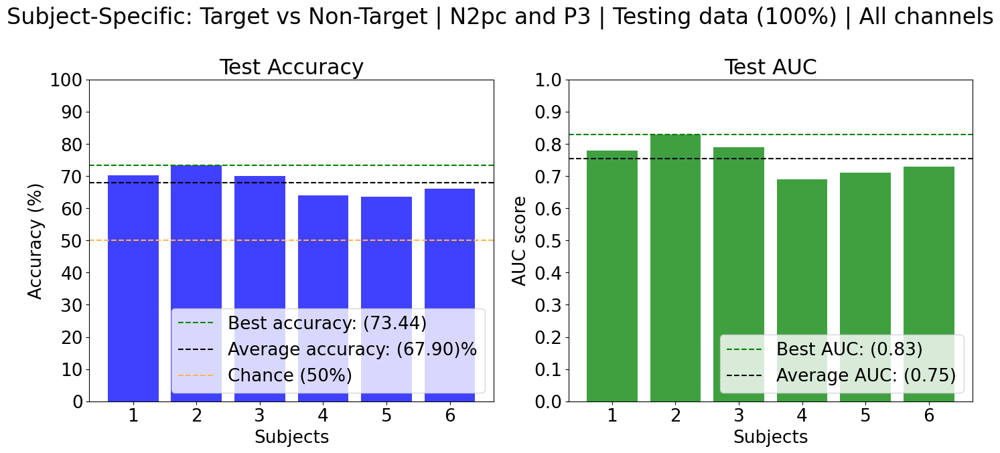

In [315]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc and P3 | Testing data (100%) | All channels', fontsize=24)

# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f})')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f})%')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Test Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')


ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step = 0.1), 
          ylabel='AUC score',
          title="Test AUC");

ax[1].legend(loc='lower right');
plt.tight_layout()


In [316]:
perSubj_sensitivity

[0.6015625, 0.84375, 0.796875, 0.7265625, 0.75, 0.640625]

In [317]:
perSubj_specificity

[0.8046875, 0.625, 0.6015625, 0.5546875, 0.5234375, 0.6796875]

In [318]:
perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(subj_N2pc_P3_models[subj].predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, 0:-1]), 
                                                      all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

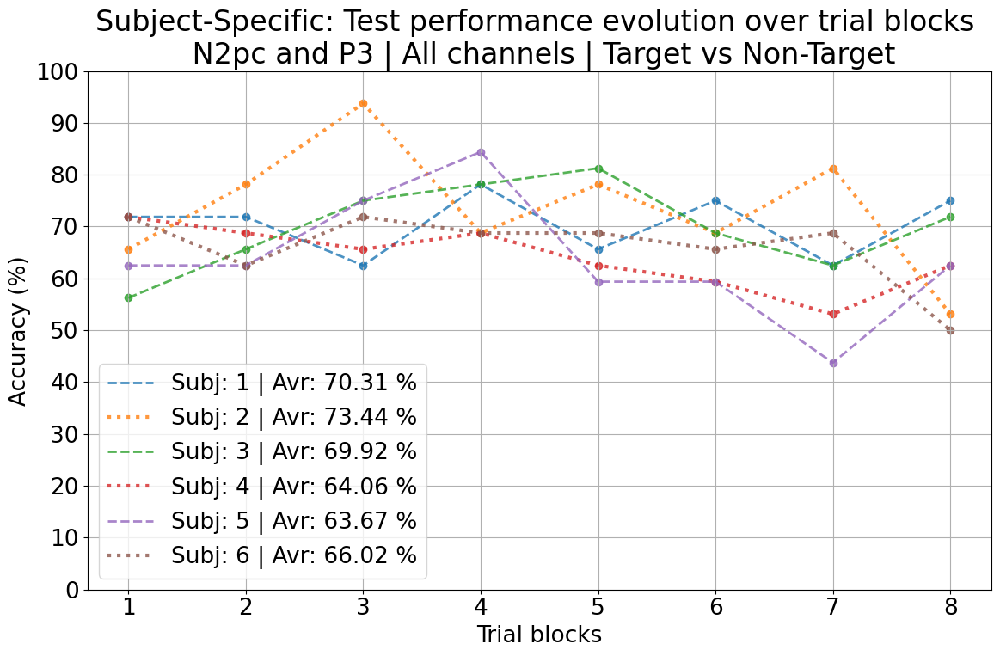

In [319]:
figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f} %", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Specific: Test performance evolution over trial blocks \n N2pc and P3 | All channels | Target vs Non-Target", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

#### Generalized N2pc and P3

In [320]:
_, GEN_N2pc_P3_models_Folder = run_fast_scandir("C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_Target_vs_NonTarget_N2pc_P3/", [".pkl"])

GEN_N2pc_P3_model = joblib.load(GEN_N2pc_P3_models_Folder[0])

In [321]:
perSubj_accuracy = []
perSubj_auc_scores = []
perSubj_sensitivity = []
perSubj_specificity = []

for subj in range(NUM_SUBJ):
    # Get the true labels and predictions
    true_labels = all_norm_test_featVect[subj][:, -1]
    predictions = GEN_N2pc_P3_model.predict(all_norm_test_featVect[subj][:, 0:-1])
    prediction_probs = GEN_N2pc_P3_model.predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:, 1]
    
    # Calculate accuracy
    perSubj_accuracy.append(accuracy_score(predictions, true_labels) * 100)
    
    # Calculate AUC score
    perSubj_auc_scores.append(round(roc_auc_score(true_labels, prediction_probs), 2))
    
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(true_labels, predictions).ravel()
    
    # Calculate sensitivity (recall)
    sensitivity = tp / (tp + fn)
    perSubj_sensitivity.append(sensitivity)
    
    # Calculate specificity
    specificity = tn / (tn + fp)
    perSubj_specificity.append(specificity)

In [322]:
perSubj_sensitivity

[0.7890625, 0.8125, 0.890625, 0.71875, 0.7578125, 0.7578125]

In [323]:
perSubj_specificity

[0.671875, 0.5390625, 0.3046875, 0.5078125, 0.4921875, 0.6171875]

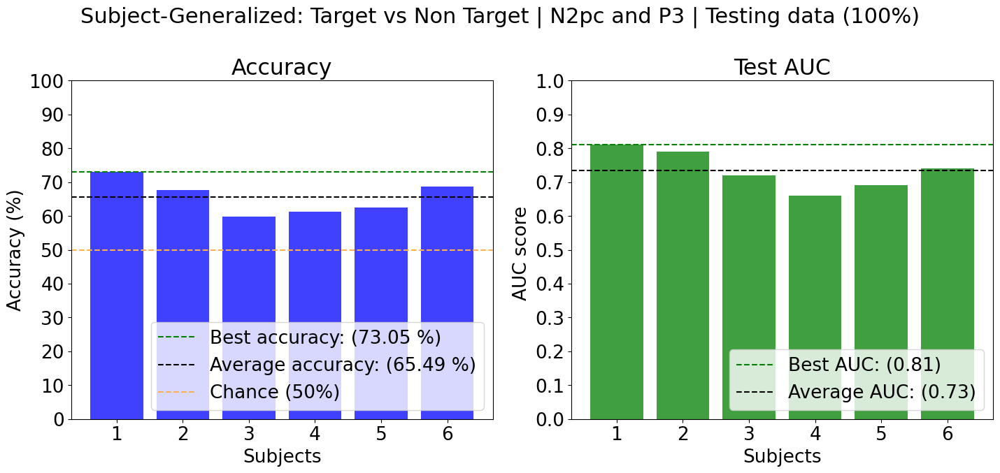

In [324]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 2,
                       figsize=(14.67, 7))


fig.suptitle(f'Subject-Generalized: Target vs Non Target | N2pc and P3 | Testing data (100%)', fontsize=22)


# -------------- Prediction Accuracy --------------

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[0].set_title('Test Accuracy (%)')

ax[0].axhline(y = max(perSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[0].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Accuracy");

ax[0].legend(loc='lower right');


# -------------- AUC score --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[1].set_title('AUC')

ax[1].axhline(y = max(perSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: ({max(perSubj_auc_scores):.2f})')

ax[1].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: ({np.mean(perSubj_auc_scores):.2f})')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 1.01, step=0.10), 
          ylabel='AUC score ',
          title="Test AUC");

ax[1].legend(loc='lower right');


plt.rcParams.update({'font.size': 19})
plt.tight_layout()


In [325]:
perSubj_accuracy = []

for subj in range(NUM_SUBJ):

    perTrialBlock_accuracy = []

    for trials in range(0, n_entries, trial_range):

        perTrialBlock_accuracy.append( accuracy_score(GEN_N2pc_P3_model.predict(all_o_norm_test_featVect[subj][trials:trials + trial_range, 0:-1]), 
                                                      all_o_norm_test_featVect[subj][trials:trials + trial_range, -1]) * 100)
    
    perSubj_accuracy.append(perTrialBlock_accuracy)

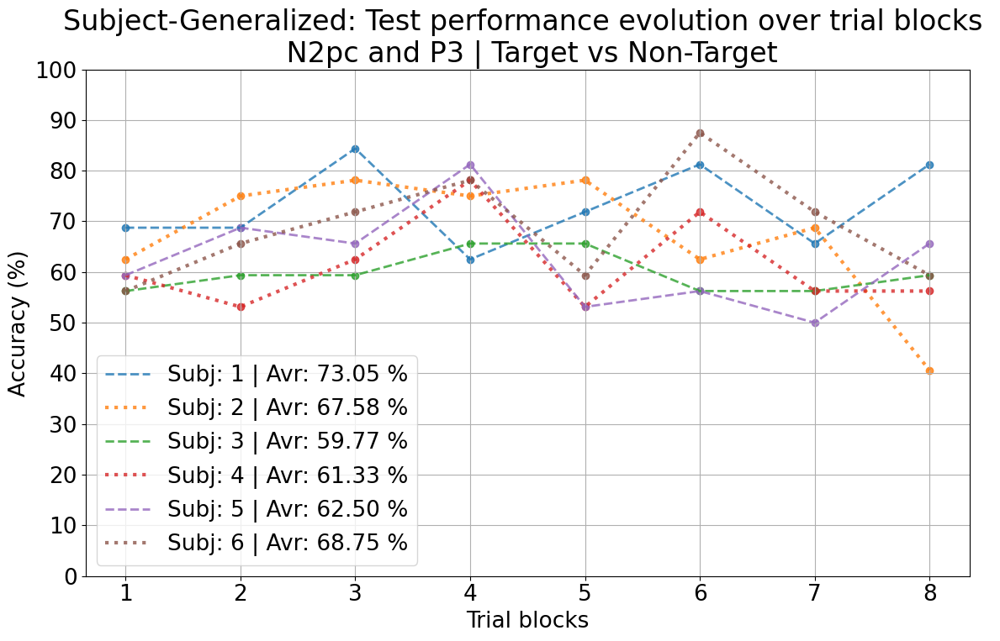

In [326]:
figure(figsize = (12,8))

for subj in range(NUM_SUBJ):

    if subj % 2 == 0:
        st = "dashed"
        ln = 2
    else:
        st = "dotted"
        ln = 3
    plt.plot(n_points, perSubj_accuracy[subj], label = f"Subj: {subj + 1} | Avr: {np.mean(perSubj_accuracy[subj]):.2f} %", linewidth = ln, linestyle= st, alpha = 0.8)
    plt.scatter(n_points, perSubj_accuracy[subj], alpha = 0.8)

plt.title(f"Subject-Generalized: Test performance evolution over trial blocks \n N2pc and P3 | Target vs Non-Target", fontsize = 24)
plt.ylabel("Accuracy (%)")
plt.xlabel("Trial blocks")
plt.yticks(np.arange(0, 101,10))
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

# Differences between left and right targets on the P3 (Lower amplitude P3 equates more cognitive load which can be correlated with the dominant eye)

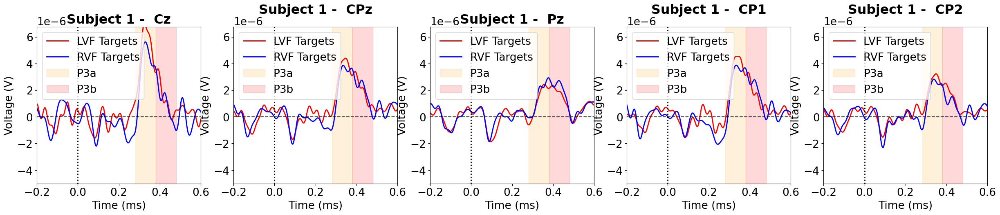

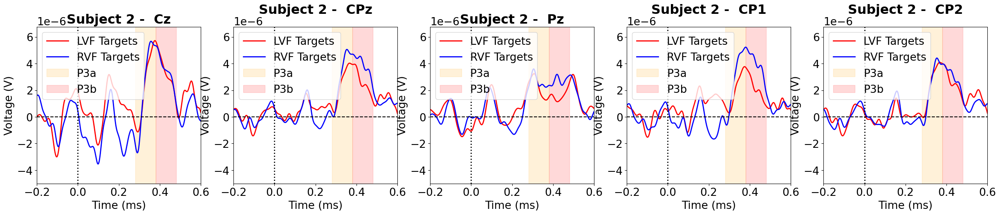

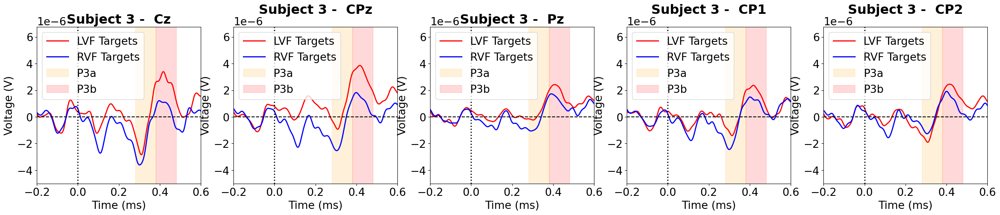

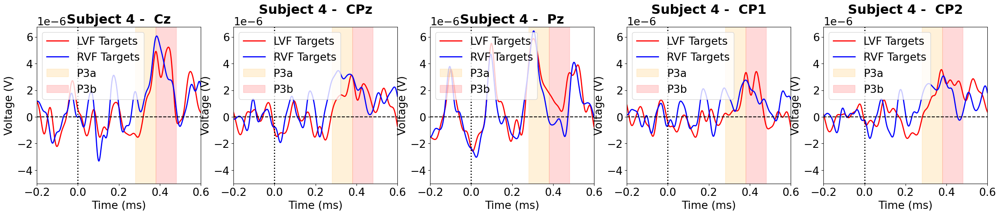

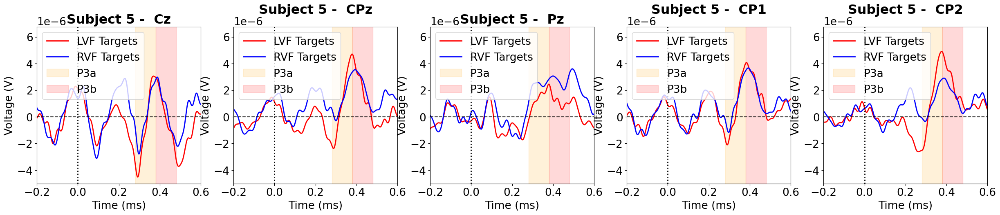

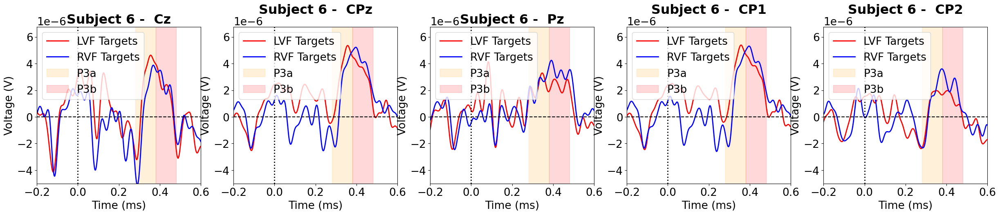

In [327]:
up_vlim = np.max(grandAver_targetERP[P3_ch_idx,:]) + np.max(std_targetERP[P3_ch_idx,:]*1.1)
do_vlim = np.min(grandAver_targetERP[P3_ch_idx,:]) - np.max(std_targetERP[P3_ch_idx,:])

for subj in (range(NUM_SUBJ)):

    fig, ax1 = plt.subplots(nrows = 1, 
                        ncols = len(P3_ch_idx),
                        figsize=(30, 5))

    for c in range(len(P3_ch_idx)):


        ax1[c].plot(ERP_times, 
                 np.mean(all_LVF_P3[subj], axis = 0)[c,:], 
                 color = 'red', 
                 label = 'LVF Targets',  
                 linewidth = 2);
        
        ax1[c].plot(ERP_times, 
                 np.mean(all_RVF_P3[subj], axis = 0)[c,:], 
                 'b', 
                 label = 'RVF Targets',
                 linewidth = 2);
        
        ax1[c].set_title(f"Subject {subj + 1} - {P3_channels[c]}", weight = 'bold')
        ax1[c].set_xlabel("Time (ms)")
        ax1[c].set_ylabel("Voltage (V)")
        ax1[c].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
        ax1[c].axhline(y = 0, linestyle = '--', color = 'black')
        ax1[c].set_xlim([preStim_offset,posStim_offset])
        ax1[c].set_ylim([do_vlim, up_vlim])


        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.28, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax1[c].add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.38, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax1[c].add_patch(P3b_region)
            
        ax1[c].legend(loc='upper left')